#Project Overview
Computer vision can be used to automate supervision and trigger appropriate actions if an event is predicted from an image of interest.
For example, food items can be easily identified by a camera based on:

- The type of food

- Color

- Ingredients, etc.

## 📊 Data Description
The Food101 dataset contains 16,256 images across 17 food classes.

Each class can be roughly split into 70% training and 30% testing.

Classes are typically food names (e.g., apple_pie, chicken_curry).

The dataset has already been attached with this project. Please use the same version provided.

## 📎 Original Dataset Link for Reference Only:
Food101 Dataset on Kaggle

## 📖 Reference
The dataset was originally introduced in the paper:
"Food-101 – Mining Discriminative Components with Random Forests"
Authors: Lukas Bossard, Matthieu Guillaumin, Luc Van Gool



# Import all libirary

In [ ]:
import os
import numpy as np                                                                               # Importing numpy for Matrix Operations
import pandas as pd                                                                              # Importing pandas to read CSV files
import matplotlib.pyplot as plt                                                                  # Importting matplotlib for Plotting and visualizing images
import math                                                                                      # Importing math module to perform mathematical operations
import cv2                                                                                       # Importing openCV for image processing
import seaborn as sns                                                                            # Importing seaborn to plot graphs
from collections import defaultdict
import random
import shutil
import os

# Tensorflow modules
import tensorflow as tf
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential # Importing the sequential module to define a sequential model
from keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D,MaxPool2D, GlobalAveragePooling2D, Input, BatchNormalization, Multiply, Activation
from tensorflow.keras.optimizers import Adam,SGD,Optimizer
from tensorflow.keras.utils import to_categorical


# sklearn lib
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from keras import backend as K
from sklearn.model_selection import train_test_split # train test split
from sklearn.preprocessing import LabelEncoder # label encoder
from sklearn.metrics import accuracy_score, classification_report

# Set seeds for reproducibility
seed_value = 42

random.seed(seed_value)
np.random.seed(seed_value)
tf.random.set_seed(seed_value)
os.environ['PYTHONHASHSEED'] = str(seed_value)


In [ ]:
# Uncomment and run the following code in case Google Colab is being used
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip '/content/drive/MyDrive/Python Course_shared/computer Vision/Food_101.zip'


Streaming output truncated to the last 5000 lines.
  inflating: Food_101/nachos/2305287.jpg  
  inflating: __MACOSX/Food_101/nachos/._2305287.jpg  
  inflating: Food_101/nachos/2644747.jpg  
  inflating: __MACOSX/Food_101/nachos/._2644747.jpg  
  inflating: Food_101/nachos/1425651.jpg  
  inflating: __MACOSX/Food_101/nachos/._1425651.jpg  
  inflating: Food_101/nachos/835919.jpg  
  inflating: __MACOSX/Food_101/nachos/._835919.jpg  
  inflating: Food_101/nachos/908454.jpg  
  inflating: __MACOSX/Food_101/nachos/._908454.jpg  
  inflating: Food_101/nachos/2553526.jpg  
  inflating: __MACOSX/Food_101/nachos/._2553526.jpg  
  inflating: Food_101/nachos/1323906.jpg  
  inflating: __MACOSX/Food_101/nachos/._1323906.jpg  
  inflating: Food_101/nachos/3228958.jpg  
  inflating: __MACOSX/Food_101/nachos/._3228958.jpg  
  inflating: Food_101/nachos/346658.jpg  
  inflating: __MACOSX/Food_101/nachos/._346658.jpg  
  inflating: Food_101/nachos/2702921.jpg  
  inflating: __MACOSX/Food_101/nachos/.

In [ ]:
# Image folder
food_101_image_folder = '/content/Food_101/'

## Overview of Original Dataset Images by Class (No Bounding Boxes)

## Visual Inspection of Annotated Images (With Bounding Boxes)


The **Food101** dataset contains a total of **16,256 images** categorized into **17 different food classes**. Each class represents a type of food, such as `apple_pie`, `pizza`, `samosa`, etc.

This section presents a **visual inspection of sample images with bounding box annotations**, which highlight the region of interest (i.e., the food item) within each image.

### Key Details:
- The dataset can be split into **training and testing sets** in a **70-30 ratio** per class.
- Each food category has approximately **1,000 images**, except for `apple_pie`, which has fewer samples.
- Bounding boxes help localize the food item in the image, which is useful for object detection or improving classification accuracy by focusing the model on relevant image regions.

### Purpose of this Visualization:
- To visually verify the quality and accuracy of bounding box annotations.
- To understand how localized regions differ across classes and image samples.
- To evaluate whether bounding box information can aid in better feature learning for classification or detection tasks.

Below, we inspect a few representative examples from different classes with their bounding boxes overlaid.




#### Helper Functions

In [ ]:
# Metadat Class for storing it
class IdentityMetadata():
    def __init__(self, base, name, file, size):
        # print(base, name, file)
        # dataset base directory
        self.base = base
        # identity name
        self.name = name
        # image file name
        self.file = file
        self.size=size

    def __repr__(self):
        return self.image_path()

    def image_path(self):
        return os.path.join(self.base, self.name, self.file)

def load_metadata(path):
    """
    Load metadata for all images in a directory
    """
    if not os.path.exists(path):
        raise ValueError(f"Path does not exist: {path}")

    metadata = []
    for index, folder in enumerate(os.listdir(path)):
        subdir_path = os.path.join(path, folder)
        if not os.path.isdir(subdir_path):
            continue  # Skip files like .DS_Store or any non-folder

        # Get all valid image files in the subdirectory
        image_files = [f for f in os.listdir(subdir_path)
                       if f.lower().endswith(('.jpg', '.jpeg'))]

        total_images = len(image_files)

        for file in image_files:
            metadata.append(IdentityMetadata(path, folder, file, total_images))

    return np.array(metadata)

# Read & Load Image
def load_image(path):
  """
  Load image from path
  """
  img = cv2.imread(path)
  # Convert to RGB
  return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

def split_metadata_per_class(metadata_list, train_ratio=0.7, seed=42):
    random.seed(seed)

    # Step 1: Group by identity (class name)
    class_groups = defaultdict(list)
    for meta in metadata_list:
        class_groups[meta.name].append(meta)

    train_set = []
    test_set = []

    # Step 2: Shuffle and split each class group
    for identity, items in class_groups.items():
        random.shuffle(items)
        split_index = int(len(items) * train_ratio)
        train_set.extend(items[:split_index])
        test_set.extend(items[split_index:])

    return train_set, test_set


def organize_dataset(metadata_list, base_output_dir):
    """
    Organize dataset into subdirectories by class
    """
    if not os.path.exists(base_output_dir):
        os.makedirs(base_output_dir)

    for meta in metadata_list:
        label_dir = os.path.join(base_output_dir, meta.name)
        os.makedirs(label_dir, exist_ok=True)
        src = meta.image_path()
        dst = os.path.join(label_dir, meta.file)
        shutil.copy2(src, dst)


def draw_yolo_bboxes_from_csv(data_dir, image_file, annotations_df, ax=None, food_class='images'):
    images_dir = os.path.join(data_dir, food_class)
    image_path = os.path.join(images_dir, image_file)

    # Load image
    image = cv2.imread(image_path)
    if image is None:
        print(f"❌ Image not found: {image_path}")
        return
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    height, width, _ = image.shape

    # Filter annotations for this image
    boxes = annotations_df[annotations_df['image'] == image_file]

    if boxes.empty:
        print(f"⚠️ No annotations found for: {image_file}")
        return

    # Draw each bounding box
    for _, row in boxes.iterrows():
        class_id = row['class_name']
        x_center = float(row['x_center']) * width
        y_center = float(row['y_center']) * height
        w = float(row['width']) * width
        h = float(row['height']) * height

        x1 = int(x_center - w / 2)
        y1 = int(y_center - h / 2)
        x2 = int(x_center + w / 2)
        y2 = int(y_center + h / 2)

        # Draw rectangle and class_id
        # Draw rectangle and class_id
        cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (0, 0, 255), 2)  # Changed to blue (BGR format)
        cv2.putText(image_rgb, str(class_id), (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)  # Changed to blue (BGR format)

    if ax is None:
        plt.figure(figsize=(40, 40))
        plt.imshow(image_rgb)
        plt.axis('off')
        plt.title(f"{image_file}")
        plt.show()
    else:
        ax.imshow(image_rgb)
        ax.axis('off')

In [ ]:
# load image metadata from folder
metadata = load_metadata(food_101_image_folder)

# Print metadata shape to get total number of images
print("Total number of images:", metadata.shape)

# Print folder path
print("\nDataset folder path:", food_101_image_folder)

# Get unique food class names from metadata
food_classes = sorted(list(set(item.name for item in metadata)))

# Print food class names
print("\nFood classes in dataset:")
for food_class in food_classes:
    print(f"- {food_class}")


Total number of images: (16256,)

Dataset folder path: /content/Food_101/

Food classes in dataset:
- apple_pie
- chocolate_cake
- donuts
- falafel
- french_fries
- hot_dog
- ice_cream
- nachos
- onion_rings
- pancakes
- pizza
- ravioli
- samosa
- spring_rolls
- strawberry_shortcake
- tacos
- waffles



#### Observation:

#### Total number of images
- The dataset consists of **16,256 images**.

#### Dataset folder path
- The images are located in the folder path: `asset/Food_101`.


1. **Dataset Size**: The dataset contains **16,256 images**, which is a reasonable size for training machine learning models. However, you may need to apply data augmentation techniques or preprocessing to account for class imbalances or variations in image content.

2. **Food Class Distribution**: It's crucial to analyze the class distribution. Some food classes might have more images than others. To address this, you might want to consider techniques like oversampling, undersampling, or using class weights in the machine learning model.

3. **Class Variety**: The dataset includes a wide range of food items, from desserts (apple pie, chocolate cake, ice cream) to savory items (pizza, tacos, falafel). This makes the classification task more challenging due to the variability in shapes, textures, and visual features across food items.

4. **Data Preprocessing**: The typical preprocessing steps for image classification include:
   - Resizing images to a consistent size.
   - Normalization (scaling pixel values to a range of 0-1).
   - Data augmentation (rotating, flipping, and adjusting color jitter).
   These steps help ensure that the model generalizes well and avoids overfitting.

5. **Performance Metrics**: Metrics like accuracy, precision, recall, and F1-score should be evaluated. These metrics help assess the model's ability to distinguish between different food classes, especially when some are more challenging to classify.


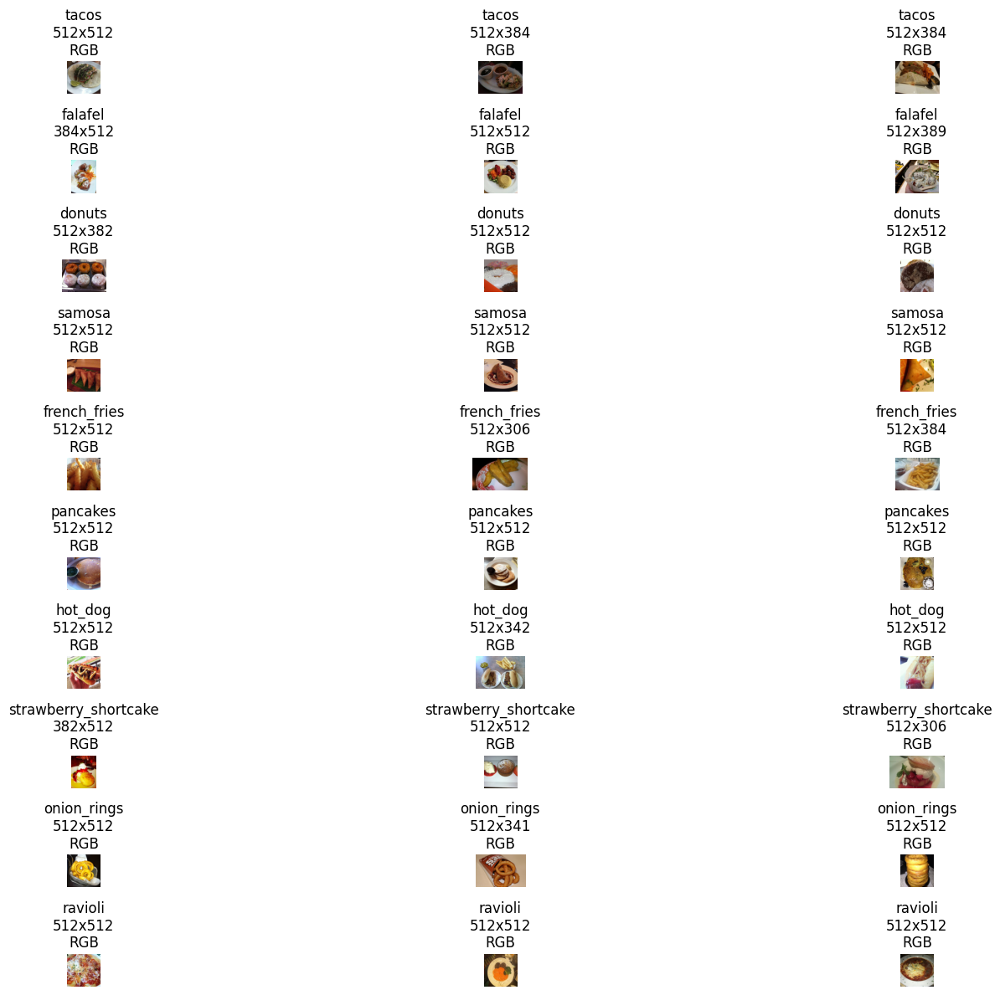

In [ ]:
# Updated configuration
n_classes_to_sample = 10
samples_per_class = 3
max_images = n_classes_to_sample * samples_per_class

plt.figure(figsize=(18, 12))
seen = {}
plotted = 0

for item in metadata:
    class_name = item.name
    if seen.get(class_name, 0) < samples_per_class:
        img = cv2.imread(item.image_path())
        if img is None:
            print(f"Warning: Could not read image {item.image_path()}")
            continue

        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        height, width, channels = img.shape
        is_grayscale = channels == 1

        plt.subplot(n_classes_to_sample, samples_per_class, plotted + 1)
        plt.imshow(img)
        plt.title(f"{class_name}\n{width}x{height}\n{'Gray' if is_grayscale else 'RGB'}")
        plt.axis('off')

        seen[class_name] = seen.get(class_name, 0) + 1
        plotted += 1

        if plotted >= max_images:
            break

plt.tight_layout()
plt.show()


### Observations:

- Consistent Color Space:
    - All images are RGB, which is standard and expected for deep learning models using convolutional networks.

- Variable Image Dimensions:
    - Although most images are square (512x512), several have non-square resolutions (e.g., 512x342, 382x512, 512x384).
    - This introduces aspect ratio variability, which may affect model performance if not handled properly.

- Centered Composition:
    - Most food items appear well-centered, with minimal background clutter.
    - This suggests that the bounding boxes or crops (if applied) were done with reasonable accuracy.

- Intra-class Variation:
    - Each class (e.g., samosa, falafel, apple_pie) shows visual variation in texture, orientation, and plating.
    - This is beneficial for training robust classifiers but may require data augmentation to generalize well.


- Preprocessing Needed:
    - Normalize image sizes (e.g., resize all to 224×224 or 299×299 depending on model input).
    - Consider aspect ratio preservation or intelligent cropping.

- Data Augmentation Recommended:

    - Techniques like random cropping, rotation, zoom, and brightness adjustments will improve generalization.

- Improves Model Generalization:

    - Bounding boxes help the model learn discriminative visual patterns with greater consistency across the dataset.

In [ ]:
# Create a DataFrame to show class distribution
class_counts = {}

for class_name in os.listdir(food_101_image_folder):
    if os.path.isdir(os.path.join(food_101_image_folder, class_name)):
        class_size = len(os.listdir(os.path.join(food_101_image_folder, class_name)))
        class_counts[class_name] = class_size

df = pd.DataFrame(list(class_counts.items()), columns=['class_name', 'class_size'])
df.set_index('class_name', inplace=True)
df


,class_size
class_name,
tacos,1000
falafel,1000
donuts,1000
samosa,1000
french_fries,1000
pancakes,1000
hot_dog,1000
strawberry_shortcake,1000
onion_rings,1000


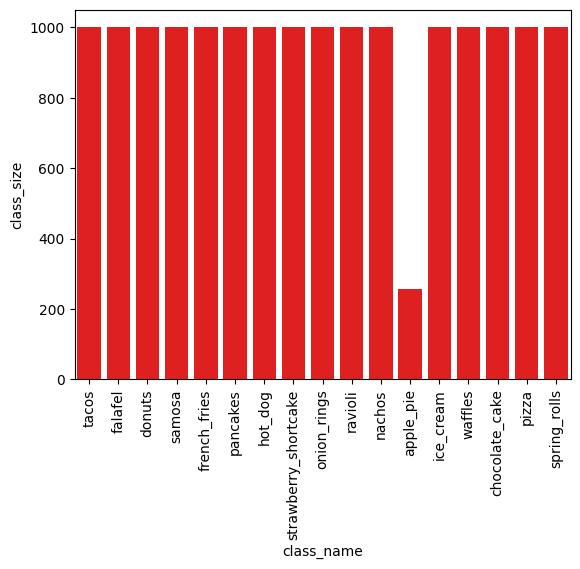

In [ ]:
# show in barplot
sns.barplot(x=df.index, y=df['class_size'],color='r')
plt.xticks(rotation=90)
plt.show()

#### Observation:

1. **Uniform Distribution Across Most Classes**  
   - Out of the 17 total food classes, **16 classes have exactly 1000 images**.  
   - This indicates a mostly well-balanced dataset, which is beneficial for training classification models without inherent bias.

2. **Class Imbalance – `apple_pie`**  
   - The `apple_pie` class has only **257 images**, which is significantly lower than the others.
   - This imbalance may negatively affect the model's ability to correctly classify `apple_pie`, leading to:
     - Lower recall and precision for the minority class.
     - Potential model bias toward majority classes.

3. **Potential Mitigation Strategies**  
   To address the class imbalance:
   - **Data Augmentation**: Apply augmentation (rotation, flipping, color jittering) to synthetically increase the number of `apple_pie` images.
   - **Class Weights**: Use class weights in the loss function during training to emphasize learning on the minority class.
   - **SMOTE or Oversampling Techniques** (if suitable for images).
   - **Undersampling** other classes (less preferred due to loss of valuable data).

4. **Impact on Model Evaluation**  
   - Use evaluation metrics such as **F1-score**, **Recall**, and **Confusion Matrix** in addition to Accuracy.
   - These metrics will better highlight the model’s performance on the imbalanced class.

5. **Need for Visual Exploration**  
   - Visual inspection of `apple_pie` images may help understand why the count is low (e.g., ambiguous visuals, data collection issue).




---



## Visual Inspection of Annotated Images (With Bounding Boxes)


The **Food101** dataset contains a total of **16,256 images** categorized into **17 different food classes**. Each class represents a type of food, such as `apple_pie`, `pizza`, `samosa`, etc.

This section presents a **visual inspection of sample images with bounding box annotations**, which highlight the region of interest (i.e., the food item) within each image.

### Key Details:
- The dataset can be split into **training and testing sets** in a **70-30 ratio** per class.
- Each food category has approximately **1,000 images**, except for `apple_pie`, which has fewer samples.
- Bounding boxes help localize the food item in the image, which is useful for object detection or improving classification accuracy by focusing the model on relevant image regions.

### Purpose of this Visualization:
- To visually verify the quality and accuracy of bounding box annotations.
- To understand how localized regions differ across classes and image samples.
- To evaluate whether bounding box information can aid in better feature learning for classification or detection tasks.

Below, we inspect a few representative examples from different classes with their bounding boxes overlaid.


---

### Dataset Annotation Overview

We have successfully annotated our image dataset and stored the results in a file named `annotation_csv`. This file adheres to the **YOLO format**, with the following columns:

- **`image_name`**: Name of the image file.
- **`class_name`**: Object category label.
- **`x_center`**, **`y_center`**, **`width`**, **`height`**: Bounding box coordinates **normalized to the [0, 1] range**.

---

### How We Annotated the Data

We used a hybrid approach combining **automated tools** and **AI assistance** to efficiently generate high-quality annotations:

-  **YOLOv8 and YOLOv11**: Employed for automatic object detection and initial bounding box generation.
  
-  **ChatGPT API**: Used to **pass images directly** and **receive bounding box predictions** for objects, especially helpful in cases requiring semantic understanding or where pretrained models struggled.

-  **Roboflow**: Used as a platform for annotation review, correction, and dataset management. It helped streamline the export process into YOLO format and ensured consistency.

---

###  Usage in Training Pipeline

The `annotation_csv` will be used for:

-  **Data Preparation**: Parsing annotations in YOLO format for image-label mapping.
- **Model Training**: Feeding normalized bounding boxes and class labels into the training pipeline.

This multi-tool approach ensures a robust, scalable, and AI-assisted annotation pipeline tailored for object detection tasks.




#### Loading Annotation Data and Extracting Food Classes

In this step, we load the refined annotation data from the `Food_101_Annotation` directory. The annotation file (`annotation_refined.csv`) contains important metadata such as image file names, bounding box coordinates, and corresponding food class labels.

We extract and display the list of **unique food classes** present in the dataset to understand the classification scope.


In [ ]:
!unzip '/content/drive/MyDrive/Python Course_shared/computer Vision/annotation/Food-101-Annotated-V3.zip'


Archive:  /content/drive/MyDrive/Python Course_shared/computer Vision/annotation/Food-101-Annotated-V3.zip
   creating: Food-101-Annotated/
  inflating: __MACOSX/._Food-101-Annotated  
   creating: Food-101-Annotated/ice_cream/
  inflating: __MACOSX/Food-101-Annotated/._ice_cream  
   creating: Food-101-Annotated/samosa/
  inflating: __MACOSX/Food-101-Annotated/._samosa  
  inflating: Food-101-Annotated/.DS_Store  
  inflating: __MACOSX/Food-101-Annotated/._.DS_Store  
   creating: Food-101-Annotated/onion_ring/
  inflating: __MACOSX/Food-101-Annotated/._onion_ring  
   creating: Food-101-Annotated/strawberry_shortcake/
  inflating: __MACOSX/Food-101-Annotated/._strawberry_shortcake  
   creating: Food-101-Annotated/waffle/
  inflating: __MACOSX/Food-101-Annotated/._waffle  
  inflating: Food-101-Annotated/annotation_refined.csv  
  inflating: __MACOSX/Food-101-Annotated/._annotation_refined.csv  
   creating: Food-101-Annotated/chocolate_cake/
  inflating: __MACOSX/Food-101-Annotated/

In [ ]:
# Correct data directory path
data_dir = 'Food-101-Annotated/'

# Read the annotation file
annotations_df = pd.read_csv('Food-101-Annotated/annotation_refined.csv')

classes = annotations_df['class_name'].unique()

print("Available food classes:")
classes.tolist()

Available food classes:


['french_fries',
 'nachos',
 'chocolate_cake',
 'samosa',
 'ice_cream',
 'strawberry_shortcake',
 'pizza',
 'tacos',
 'waffle',
 'onion_ring']

In [ ]:
# Display first few rows of annotations dataframe
print("\nSample of Annotations Data:")
annotations_df.head()


Sample of Annotations Data:


,image,class_name,x_center,y_center,width,height
0,1199754.jpg,french_fries,0.509375,0.522656,0.720313,0.771875
1,1232631.jpg,nachos,0.178125,0.717969,0.351562,0.439063
2,1232631.jpg,nachos,0.522656,0.511719,0.932813,0.954688
3,2616112.jpg,nachos,0.165625,0.526563,0.214844,0.465625
4,2616112.jpg,nachos,0.394531,0.482812,0.171875,0.379688


In [ ]:
# Display summary statistics of annotations
print("\nAnnotations DataFrame Info:")
annotations_df.info()



Annotations DataFrame Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1090 entries, 0 to 1089
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       1090 non-null   object 
 1   class_name  1090 non-null   object 
 2   x_center    1090 non-null   float64
 3   y_center    1090 non-null   float64
 4   width       1090 non-null   float64
 5   height      1090 non-null   float64
dtypes: float64(4), object(2)
memory usage: 51.2+ KB


In [ ]:
# Display value counts of classes
print("\nClass Distribution:")
annotations_df['class_name'].value_counts()


Class Distribution:


,count
class_name,
samosa,193
onion_ring,176
nachos,143
ice_cream,125
tacos,117
french_fries,81
pizza,68
strawberry_shortcake,67
waffle,65


In [ ]:
# Display value counts of classes
print("\nClass Distribution:")
annotations_df.describe()


Class Distribution:


,x_center,y_center,width,height
count,1090.000000,1090.000000,1090.000000,1090.000000
mean,0.503608,0.485872,0.533300,0.502740
std,0.174767,0.152479,0.257276,0.234620
min,0.067187,0.102344,0.001563,0.002344
25%,0.397656,0.392383,0.327539,0.314844
50%,0.503125,0.492188,0.487109,0.463672
75%,0.603125,0.572656,0.753906,0.683594
max,0.953125,0.920312,1.000000,1.000000


#### Visualizing Sample Images with Bounding Boxes for Each Food Class

This section displays a visual grid of sample images from the **Food-101** dataset, annotated with **bounding boxes** for each food class. The goal is to provide a clear, visual understanding of how food items are localized within images and to verify the accuracy of the annotations.

1. french_fries
2. nachos
3. chocolate_cake
4. samosa
5. ice_cream
6. strawberry_shortcake
7. pizza
8. tacos
9. waffle
10. onion_ring

Processing class: french_fries


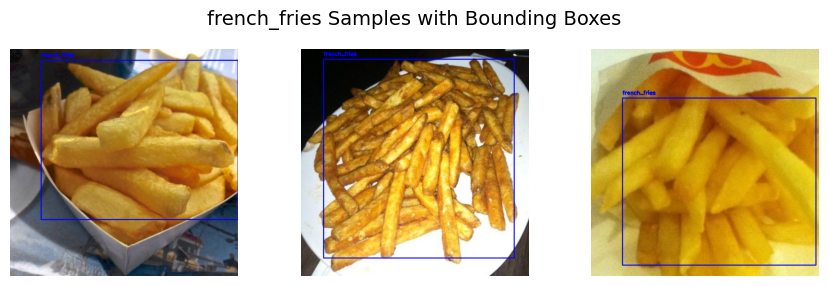


Processing class: nachos


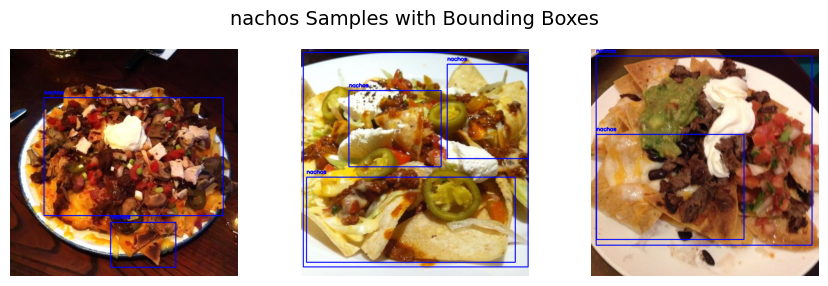


Processing class: chocolate_cake


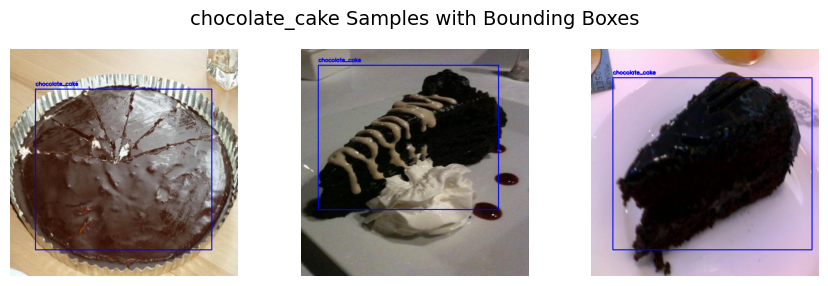


Processing class: samosa


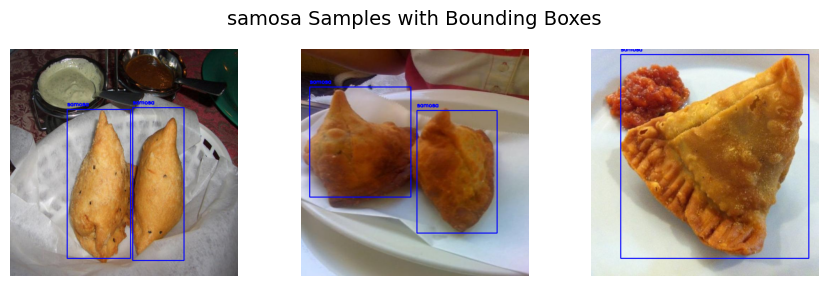


Processing class: ice_cream


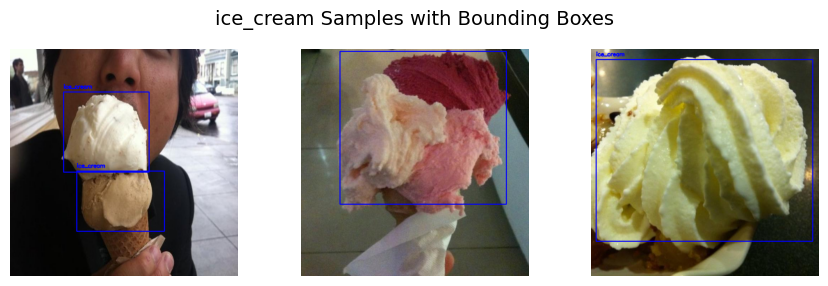


Processing class: strawberry_shortcake


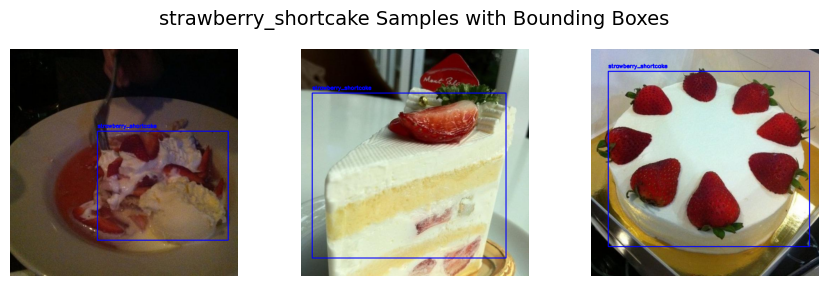


Processing class: pizza


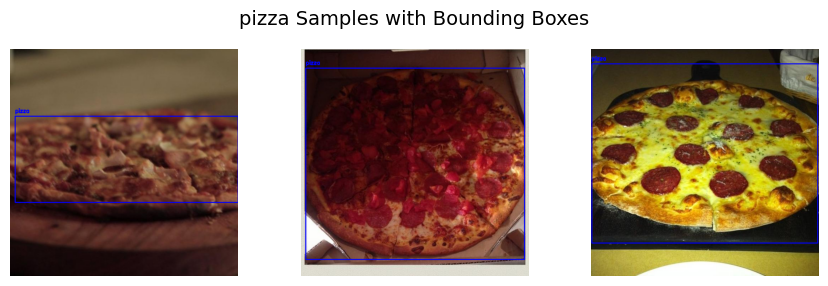


Processing class: tacos


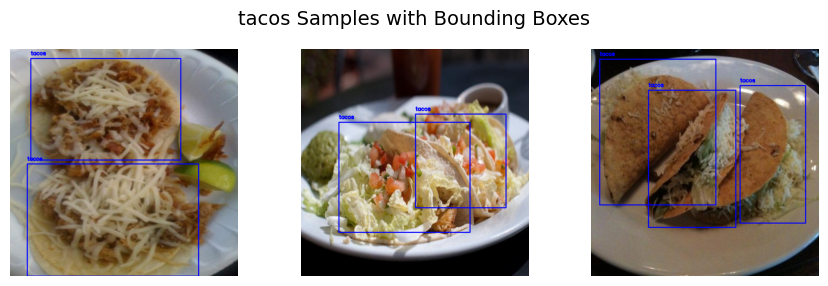


Processing class: waffle


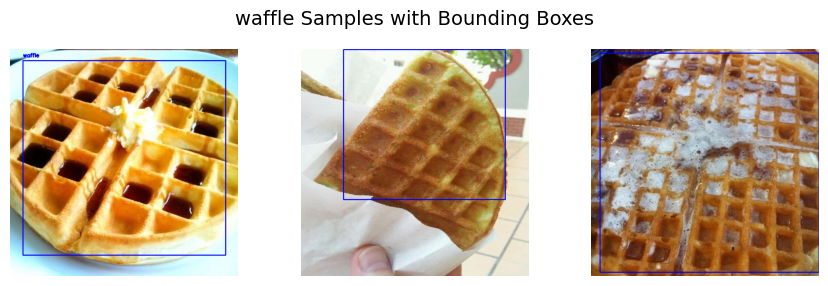


Processing class: onion_ring


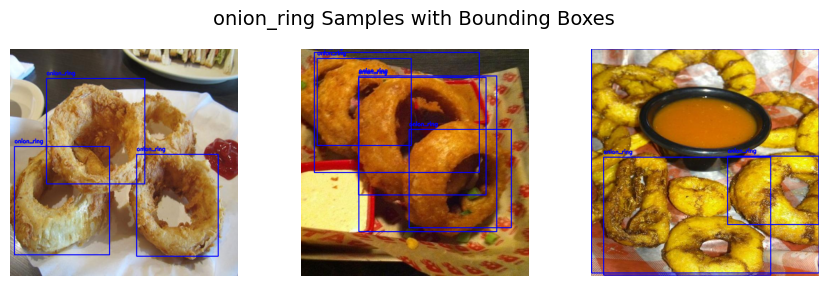

In [ ]:
import matplotlib.pyplot as plt
import random

for i, class_name in enumerate(classes, 1):
    print(f"{i}. {class_name}")

# Process each class separately with 3 images in a 1x3 grid
for food_class in classes:
    print(f"\nProcessing class: {food_class}")

    class_images = annotations_df[annotations_df['class_name'] == food_class]['image'].unique()
    selected_images = random.sample(list(class_images), min(3, len(class_images)))

    fig, axes = plt.subplots(1, 3, figsize=(9, 3))  # Adjust width & height as needed
    axes = axes.ravel()

    for img_idx, image_file in enumerate(selected_images):
        draw_yolo_bboxes_from_csv(data_dir, image_file, annotations_df, axes[img_idx], food_class)

    # Title and spacing adjustments
    fig.suptitle(f"{food_class} Samples with Bounding Boxes", fontsize=14)
    plt.tight_layout(pad=2.0)  # Adjust pad to control spacing
    plt.subplots_adjust(top=0.85)  # Make space for suptitle
    plt.show()


# Model Building

 **Performance Metrics**: Metrics like accuracy, precision, recall, and F1-score should be evaluated. These metrics help assess the model's ability to distinguish between different food classes, especially when some are more challenging to classify.

# Preparing Data Set (Annotated) For Model
 We have annotated the datset and created a seperate annotation_csv file which contains imagename,classname and xcenter,ycenter,width,height (yolo format) all normalised 0to1.We will be using the same dataset for the model data preprartion and training


In [ ]:
# base path of annotated images
base_path='Food-101-Annotated/'

In [ ]:
# load image metadata from folder for training and testing
metadata_annotated = load_metadata(base_path)
annotation_df_model=pd.read_csv(f"{base_path}/annotation_refined.csv")

### Train Test Split With Image Generator

In [ ]:
# Take first image only as there might have duplicate entryfor same image as same image mutiple instances of same food item
classification_df = annotation_df_model.groupby('image').first().reset_index()
# create a new volumn file name by concating the classname this will help us in using df for image data generator
classification_df['image_name'] = classification_df.apply(lambda row: f"{row['class_name']}/{row['image']}", axis=1)
# train test split with dividing the class in same propertion
train_df, temp_df = train_test_split(
    classification_df,
    test_size=0.2,
    stratify=classification_df['class_name'],  # ensures class distribution is preserved
    random_state=42)
valid_df, test_df = train_test_split(
    temp_df,
    test_size=0.5,
    stratify=temp_df['class_name'],  # ensures class distribution is preserved
    random_state=42)



In [ ]:
print(f"Training Set ->{train_df.shape}",f"Validation Set ->{valid_df.shape}",f"Test Set ->{test_df.shape}")

Training Set ->(447, 7) Validation Set ->(56, 7) Test Set ->(56, 7)


In [ ]:
df_1=classification_df.groupby('class_name').agg({'image':'count'}).reset_index()
df_2=train_df.groupby('class_name').agg({'image':'count'}).reset_index()
# Rename columns for clarity
df_1 = df_1.rename(columns={'image': 'total_count'})
df_2 = df_2.rename(columns={'image': 'train_count'})

# Merge on 'class_name'
result_df = pd.merge(df_1, df_2, on='class_name', how='outer')
result_df

,class_name,total_count,train_count
0,chocolate_cake,51,41
1,french_fries,78,62
2,ice_cream,54,43
3,nachos,48,38
4,onion_ring,50,40
5,pizza,58,46
6,samosa,71,57
7,strawberry_shortcake,50,40
8,tacos,52,42
9,waffle,47,38


- We can see we have 447 for training 56 for testing and 56 will be for valiadation
- We can see each class is equally distributed 80% of total image set for the class from the aboce dataframe

In [ ]:

# Define Image data generator for train and testvalidation
train_datagen =ImageDataGenerator(
                 horizontal_flip=True,
                 vertical_flip=True,
                 rotation_range=15,
                 width_shift_range=0.1,
                 height_shift_range=0.1,
                 zoom_range=0.2,
                 shear_range=0.1,
                 fill_mode='nearest',
                 rescale=1/255) #rescale to [0-1], add zoom range of 0.2x and horizontal flip
test_valid_datagen = ImageDataGenerator(rescale=1./255)


# Create training image gen
train_gen = train_datagen.flow_from_dataframe(
    train_df,
    directory=base_path,  # base path
    x_col='image_name',
    y_col='class_name',
    target_size=(128, 128),
    class_mode='categorical',
    batch_size=32,
    shuffle=True
)

# Create test image gen
test_gen = test_valid_datagen.flow_from_dataframe(
    test_df,
    directory=base_path,
    x_col='image_name',
    y_col='class_name',
    target_size=(128, 128),
    class_mode='categorical',
    batch_size=32,
    shuffle=False
)
# Create valid image gen

valid_gen = test_valid_datagen.flow_from_dataframe(
    valid_df,
    directory=base_path,
    x_col='image_name',
    y_col='class_name',
    target_size=(128, 128),
    class_mode='categorical',
    batch_size=32,
    shuffle=False
)

Found 446 validated image filenames belonging to 10 classes.
Found 56 validated image filenames belonging to 10 classes.
Found 56 validated image filenames belonging to 10 classes.


/usr/local/lib/python3.11/dist-packages/keras/src/legacy/preprocessing/image.py:920: UserWarning: Found 1 invalid image filename(s) in x_col="image_name". These filename(s) will be ignored.
  warnings.warn(


In [ ]:
print(train_gen.class_indices)
print(valid_gen.class_indices)
print(test_gen.class_indices)

{'chocolate_cake': 0, 'french_fries': 1, 'ice_cream': 2, 'nachos': 3, 'onion_ring': 4, 'pizza': 5, 'samosa': 6, 'strawberry_shortcake': 7, 'tacos': 8, 'waffle': 9}
{'chocolate_cake': 0, 'french_fries': 1, 'ice_cream': 2, 'nachos': 3, 'onion_ring': 4, 'pizza': 5, 'samosa': 6, 'strawberry_shortcake': 7, 'tacos': 8, 'waffle': 9}
{'chocolate_cake': 0, 'french_fries': 1, 'ice_cream': 2, 'nachos': 3, 'onion_ring': 4, 'pizza': 5, 'samosa': 6, 'strawberry_shortcake': 7, 'tacos': 8, 'waffle': 9}


In [ ]:
from collections import Counter

# Count how many instances per class
class_counts = Counter(test_gen.classes)

# Map class indices back to names
index_to_class = {v: k for k, v in test_gen.class_indices.items()}
class_distribution = {index_to_class[i]: count for i, count in class_counts.items()}

# Print result
for class_name, count in class_distribution.items():
    print(f"{class_name}: {count}")

ice_cream: 6
french_fries: 8
chocolate_cake: 5
onion_ring: 5
strawberry_shortcake: 5
samosa: 7
tacos: 5
nachos: 5
pizza: 6
waffle: 4


### Observations:
We can see each classes have some images in test set

### Train Test Split Normal (without image generator)

In [ ]:
images = []
labels = []
for i in metadata_annotated:
  img = cv2.imread(i.image_path())
  if img is None:
    continue
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img_resized = cv2.resize(img_rgb, (128, 128))
  images.append(img_resized/255.0)
  labels.append(i.name)


In [ ]:
# Convert lists to arrays
X = np.array(images)
y = np.array(labels)

# Encode string labels to integers
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)
y_categorical = to_categorical(y_encoded)  # one-hot encoding

# Train-test split
X_train, X_temp, y_train, y_temp = train_test_split(X, y_categorical, test_size=0.2, random_state=42, stratify=y_categorical)
X_valid, X_test, y_valid, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp)

# Shapes
print(f"Train: {X_train.shape}, {y_train.shape}")
print(f"Valid: {X_valid.shape}, {y_valid.shape}")
print(f"Test: {X_test.shape}, {y_test.shape}")

Train: (452, 128, 128, 3), (452, 10)
Valid: (56, 128, 128, 3), (56, 10)
Test: (57, 128, 128, 3), (57, 10)


# Model Creation

### Helper Function

In [ ]:
def build_basic_cnn(input_shape, num_classes):
    model = Sequential()

    # First Convolutional Block
    model.add(Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
    model.add(MaxPooling2D((2, 2)))

    # Second Convolutional Block
    model.add(Conv2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))

    # Third Convolutional Block (Optional, but good for slightly more complexity)
    model.add(Conv2D(128, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))

    # Flatten the 3D output to 1D for the Dense layers
    model.add(Flatten())

    # Dense (Fully Connected) Layers
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(0.5)) # Dropout for regularization to prevent overfitting
    model.add(Dense(num_classes, activation='softmax')) # Output layer for classification

    # Compile the model
    model.compile(optimizer=Adam(learning_rate=0.001),
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])
    return model

In [ ]:
def build_basic_cnn_2(input_shape, num_classes, optimizer: Optimizer = Adam(learning_rate=0.001)):
    model = Sequential()

    # First Convolutional Block
    model.add(Conv2D(32, (3, 3), activation='relu', input_shape=input_shape, kernel_initializer='he_normal'))
    model.add(MaxPooling2D((2, 2)))

    # Second Convolutional Block
    model.add(Conv2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))

    # Third Convolutional Block
    model.add(Conv2D(128, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))

    # Flatten and Fully Connected Layers
    model.add(Flatten())
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(num_classes, activation='softmax'))

    # Compile with the given optimizer
    model.compile(optimizer=optimizer,
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

    return model


In [ ]:

def get_callbacks(filepath='cnn_model.weights.h5'):
    """
    Returns a tuple of callbacks: ModelCheckpoint, EarlyStopping, and ReduceLROnPlateau.

    Parameters:
    -----------
    filepath : str
        Path to save the model weights.

    Returns:
    --------
    tuple :
        (ModelCheckpoint, EarlyStopping, ReduceLROnPlateau)
    """
    checkpointer = ModelCheckpoint(
        filepath=filepath,
        verbose=1,
        save_best_only=True,
        save_weights_only=True
    )

    earlystopping = EarlyStopping(
        monitor='val_loss',
        min_delta=0.01,
        patience=5,
        mode='auto'
    )

    reduceLR = ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.5,
        patience=10,
        mode='auto'
    )

    return checkpointer, earlystopping, reduceLR


In [ ]:

def plot_model_accuracy(history,model):
    """
    Plots the accuracy and loss trends over epochs for a trained neural network.

    Parameters:
    - history: Keras History object containing training metrics.

    Displays:
    - Subplot 1: Training & Validation Accuracy vs. Epochs
    - Subplot 2: Training & Validation Loss vs. Epochs
    """

    h1 = history.history  # Extract training history

    # Get the final values for display in titles
    final_train_acc = h1['accuracy'][-1]
    final_val_acc = h1['val_accuracy'][-1]
    final_train_loss = h1['loss'][-1]
    final_val_loss = h1['val_loss'][-1]

    plt.figure(figsize=(15, 6))

    # Plot Accuracy
    plt.subplot(1, 2, 1)
    sns.lineplot(y=h1['accuracy'], x=range(len(h1['accuracy'])), label="Training Accuracy", color="green")
    sns.lineplot(y=h1['val_accuracy'], x=range(len(h1['val_accuracy'])), label="Validation Accuracy", color="blue")
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.title(f"Accuracy: Train = {final_train_acc:.4f}, Val = {final_val_acc:.4f}")
    plt.legend()

    # Plot Loss
    plt.subplot(1, 2, 2)
    sns.lineplot(y=h1['loss'], x=range(len(h1['loss'])), label="Training Loss", color="orange")
    sns.lineplot(y=h1['val_loss'], x=range(len(h1['val_loss'])), label="Validation Loss", color="red")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title(f"Loss: Train = {final_train_loss:.4f}, Val = {final_val_loss:.4f}")
    plt.legend()

    plt.show()


In [ ]:
def plot_confusion_matrix(model, test_generator, class_names=None, palette='Set2'):
    """
    Plots a confusion matrix heatmap for a model and a generator-based test dataset.

    Parameters:
    - model: Trained Keras model
    - test_generator: Generator for test data
    - class_names: List of class names (optional)
    - palette: Color palette for heatmap (default: 'Blues')

    Displays:
    - Heatmap of confusion matrix
    """
    # Get predictions and true labels
    y_pred = model.predict(test_generator)
    y_pred_labels = np.argmax(y_pred, axis=1)
    y_true = test_generator.classes  # true labels from generator

    # Confusion matrix
    cm = confusion_matrix(y_true, y_pred_labels)

    if class_names is None and hasattr(test_generator, 'class_indices'):
        class_names = list(test_generator.class_indices.keys())

    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap=palette,
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')
    plt.show()


In [ ]:
def visualize_predictions(model, test_generator, class_names=None, num_images=12):
    """
    Visualize predictions made by a model on a test generator.

    Parameters:
    - model: Trained Keras model.
    - test_generator: ImageDataGenerator with shuffle=False.
    - class_names: List of class names (optional). If None, will use from generator.
    - num_images: Number of images to display.
    """
    # Get batch of images and labels
    images, labels = next(iter(test_generator))
    predictions = model.predict(images)
    pred_labels = np.argmax(predictions, axis=1)
    true_labels = np.argmax(labels, axis=1)

    # Use class names from generator if not provided
    if class_names is None:
        class_names = list(test_generator.class_indices.keys())

    plt.figure(figsize=(15, 10))
    for i in range(min(num_images, len(images))):
        plt.subplot(3, 4, i + 1)
        plt.imshow(images[i])
        plt.axis('off')
        plt.title(f"True: {class_names[true_labels[i]]}\nPred: {class_names[pred_labels[i]]}",
                  color='green' if pred_labels[i] == true_labels[i] else 'red')
    plt.tight_layout()
    plt.show()



In [ ]:
def generate_classification_report(model, test_generator):
    """
    Generate and print a classification report using a Keras model and an image data generator.

    Parameters:
    - model: Trained Keras model
    - test_generator: ImageDataGenerator.flow_from_directory object, must be created with shuffle=False
    """
    # Get true labels
    y_true = test_generator.classes
    class_labels = list(test_generator.class_indices.keys())

    # Predict probabilities
    y_pred_probs = model.predict(test_generator, verbose=1)

    # Convert to predicted class indices
    y_pred = np.argmax(y_pred_probs, axis=1)

    # Print classification report
    report=classification_report(y_true, y_pred, target_names=class_labels)
    report_1=classification_report(y_true, y_pred, target_names=class_labels,output_dict=True)
    report_df = pd.DataFrame(report_1).transpose()
    print(report)
    return report_df




---



## With Default Train Test Set (without Balanced)

In [ ]:
# Define checkpint eraly stopping call back
checkpointer, earlystopping, reduceLR=get_callbacks(filepath='model_2.weights.h5')

In [ ]:
# create model
K.clear_session()
cnn_model=build_basic_cnn((128, 128, 3), 10)

In [ ]:
cnn_model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 126, 126, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 63, 63, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 61, 61, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 30, 30, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 28, 28, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 14, 14, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │     3,211,392 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │         1,290 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,305,930 (12.61 MB)

 Trainable params: 3,305,930 (12.61 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
cnn_model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [ ]:
history = cnn_model.fit(
    X_train,
    y=y_train,
    epochs=50,
    validation_data=(X_valid, y_valid),
    callbacks=[checkpointer, reduceLR, earlystopping]

    )

Epoch 1/50
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step - accuracy: 0.1012 - loss: 2.4096
Epoch 1: val_loss did not improve from 1.63336
15/15 ━━━━━━━━━━━━━━━━━━━━ 8s 327ms/step - accuracy: 0.1026 - loss: 2.4065 - val_accuracy: 0.2143 - val_loss: 2.2699 - learning_rate: 0.0010
Epoch 2/50
13/15 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - accuracy: 0.1540 - loss: 2.2638
Epoch 2: val_loss did not improve from 1.63336
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - accuracy: 0.1594 - loss: 2.2615 - val_accuracy: 0.1786 - val_loss: 2.1883 - learning_rate: 0.0010
Epoch 3/50
14/15 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.2272 - loss: 2.1487
Epoch 3: val_loss did not improve from 1.63336
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - accuracy: 0.2259 - loss: 2.1507 - val_accuracy: 0.2143 - val_loss: 2.1650 - learning_rate: 0.0010
Epoch 4/50
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.2670 - loss: 2.0638
Epoch 4: val_loss did not improve from 1.63336
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy

Model is overfitting

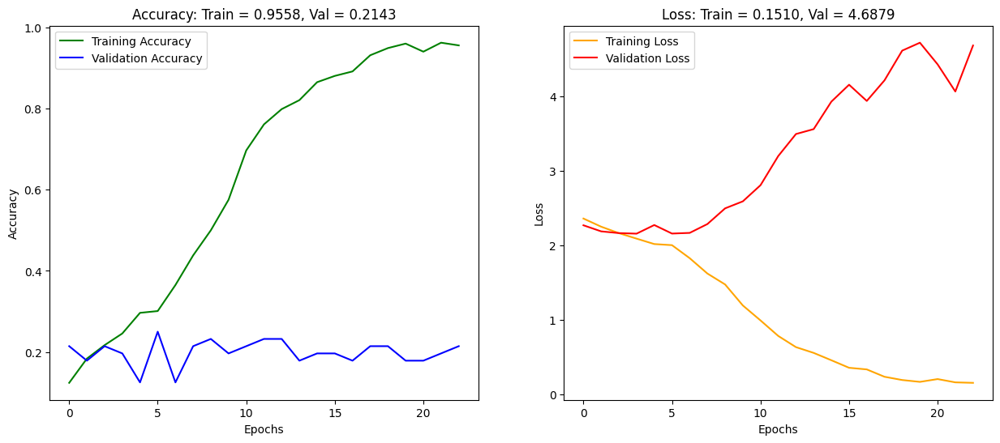

In [ ]:
plot_model_accuracy(history,cnn_model)

### Observation:
The training and validation curve is diverging .Not a good model for further analysis

## With Image Generator And balanced Train Set (Adam)

In [ ]:
# check point and eraly stopping call back
checkpointer, earlystopping, reduceLR=get_callbacks(filepath='model_2.weights.h5')

In [ ]:
# create basic model
K.clear_session()
model_2=build_basic_cnn((128, 128, 3), 10)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
# compile model
model_2.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [ ]:
# Starting training
history = model_2.fit(
    train_gen,
    epochs=50,
    validation_data=valid_gen,
    callbacks=[checkpointer, reduceLR, earlystopping]
    )

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step - accuracy: 0.0865 - loss: 2.3364
Epoch 1: val_loss improved from inf to 2.29801, saving model to model_2.weights.h5
14/14 ━━━━━━━━━━━━━━━━━━━━ 14s 631ms/step - accuracy: 0.0870 - loss: 2.3356 - val_accuracy: 0.1607 - val_loss: 2.2980 - learning_rate: 0.0010
Epoch 2/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - accuracy: 0.1392 - loss: 2.2951
Epoch 2: val_loss improved from 2.29801 to 2.27082, saving model to model_2.weights.h5
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 203ms/step - accuracy: 0.1395 - loss: 2.2951 - val_accuracy: 0.1964 - val_loss: 2.2708 - learning_rate: 0.0010
Epoch 3/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - accuracy: 0.1855 - loss: 2.2526
Epoch 3: val_loss improved from 2.27082 to 2.19070, saving model to model_2.weights.h5
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 204ms/step - accuracy: 0.1848 - loss: 2.2515 - val_accuracy: 0.1786 - val_loss: 2.1907 - learning_rate: 0.0010
Epoch 4/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - accurac

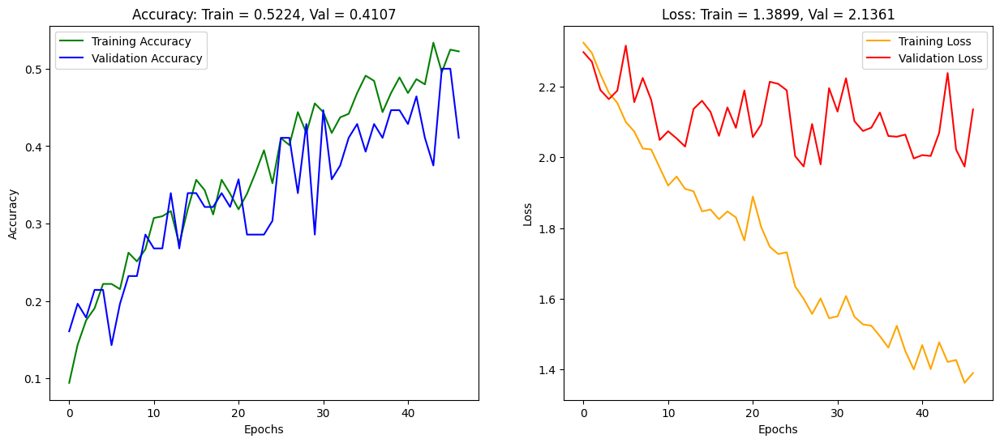

In [ ]:
plot_model_accuracy(history,model_2)

- So much noise in training and validation
- We can see its going up an down significantly and model training accuracy of 52% tells that model is failing to learn nuancest features

In [ ]:
model_2.evaluate(test_gen)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - accuracy: 0.5000 - loss: 1.5691


[1.6031839847564697, 0.5]

### Observations:
- Model failed to generalise as training accuracy is around 52% with validation accuracy is at 41%.
- Test acccuracy is around 50%
- We can see both validation and train curve has noises .

In [ ]:
# SHow classfication report
generate_classification_report(model_2, test_gen)


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 309ms/step
                      precision    recall  f1-score   support

      chocolate_cake       1.00      1.00      1.00         5
        french_fries       0.50      0.62      0.56         8
           ice_cream       0.57      0.67      0.62         6
              nachos       0.33      0.20      0.25         5
          onion_ring       0.20      0.20      0.20         5
               pizza       0.55      1.00      0.71         6
              samosa       0.17      0.14      0.15         7
strawberry_shortcake       1.00      0.40      0.57         5
               tacos       0.50      0.40      0.44         5
              waffle       0.33      0.25      0.29         4

            accuracy                           0.50        56
           macro avg       0.52      0.49      0.48        56
        weighted avg       0.51      0.50      0.48        56



2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


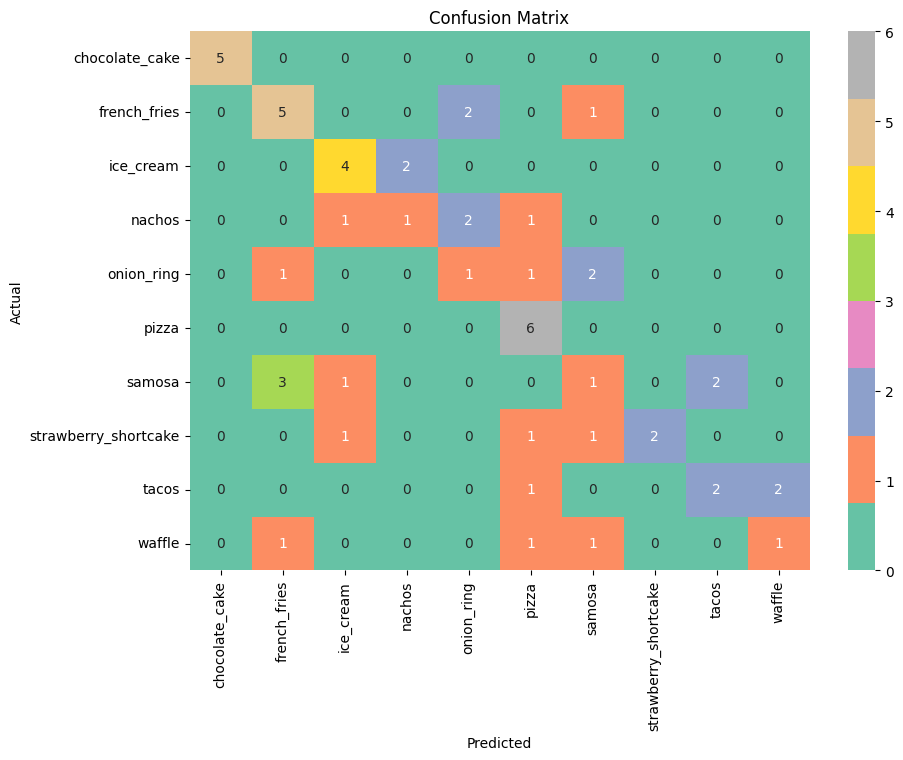

In [ ]:
# Show Confusion matrix
plot_confusion_matrix(model_2,test_gen,list(test_gen.class_indices.keys()))

### Observations:
- **Overall Test Accuracy**: 50%
- **Overall Accuracy** is at 52%

- **High Performing Classes**: `chocolate_cake`, `pizza`, `ice_cream` show good precision and recall.
- **Poorly Learned Classes**: `samosa`, `onion_ring`, `strawberry_shortcake` — either completely misclassified or low recall.


## Model With He normal and more layers(Adam)

In [ ]:
# check point and eraly stopping call back
checkpointer, earlystopping, reduceLR=get_callbacks(filepath='cnn_model_2.weights.h5')

In [ ]:
# define the model bulding from utility
K.clear_session()
cnn_model_2=build_basic_cnn_2((128, 128, 3), 10)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
cnn_model_2.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [ ]:
history = cnn_model_2.fit(
    train_gen,
    epochs=50,
    validation_data=valid_gen,
    callbacks=[checkpointer, reduceLR, earlystopping]
    )

Epoch 1/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step - accuracy: 0.0770 - loss: 2.7664
Epoch 1: val_loss improved from inf to 2.28435, saving model to cnn_model_2.weights.h5
14/14 ━━━━━━━━━━━━━━━━━━━━ 8s 409ms/step - accuracy: 0.0777 - loss: 2.7506 - val_accuracy: 0.1250 - val_loss: 2.2843 - learning_rate: 0.0010
Epoch 2/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step - accuracy: 0.1141 - loss: 2.2798
Epoch 2: val_loss improved from 2.28435 to 2.22756, saving model to cnn_model_2.weights.h5
14/14 ━━━━━━━━━━━━━━━━━━━━ 5s 376ms/step - accuracy: 0.1152 - loss: 2.2794 - val_accuracy: 0.1429 - val_loss: 2.2276 - learning_rate: 0.0010
Epoch 3/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step - accuracy: 0.1768 - loss: 2.1937
Epoch 3: val_loss did not improve from 2.22756
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 203ms/step - accuracy: 0.1764 - loss: 2.1945 - val_accuracy: 0.1250 - val_loss: 2.2510 - learning_rate: 0.0010
Epoch 4/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - accuracy: 0.1337 - loss: 2.2320
Epoch 4:

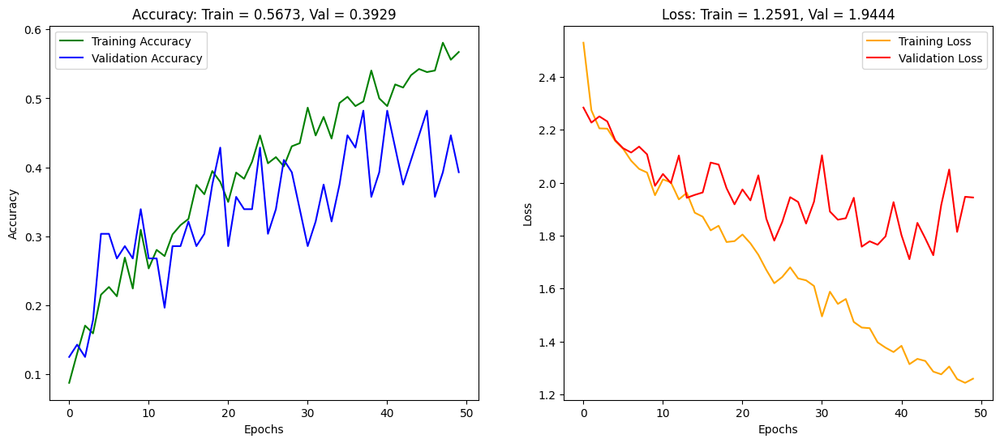

In [ ]:
plot_model_accuracy(history,cnn_model_2)

In [ ]:
cnn_model_2.evaluate(test_gen)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - accuracy: 0.4643 - loss: 1.6471


[1.7094813585281372, 0.4464285671710968]

In [ ]:
# SHow classfication report
generate_classification_report(cnn_model_2, test_gen)

1/2 ━━━━━━━━━━━━━━━━━━━━ 0s 586ms/step

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 366ms/step
                      precision    recall  f1-score   support

      chocolate_cake       0.80      0.80      0.80         5
        french_fries       0.40      0.50      0.44         8
           ice_cream       0.43      0.50      0.46         6
              nachos       0.00      0.00      0.00         5
          onion_ring       0.25      0.20      0.22         5
               pizza       0.55      1.00      0.71         6
              samosa       0.40      0.29      0.33         7
strawberry_shortcake       1.00      0.60      0.75         5
               tacos       0.40      0.40      0.40         5
              waffle       0.00      0.00      0.00         4

            accuracy                           0.45        56
           macro avg       0.42      0.43      0.41        56
        weighted avg       0.43      0.45      0.42        56



2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


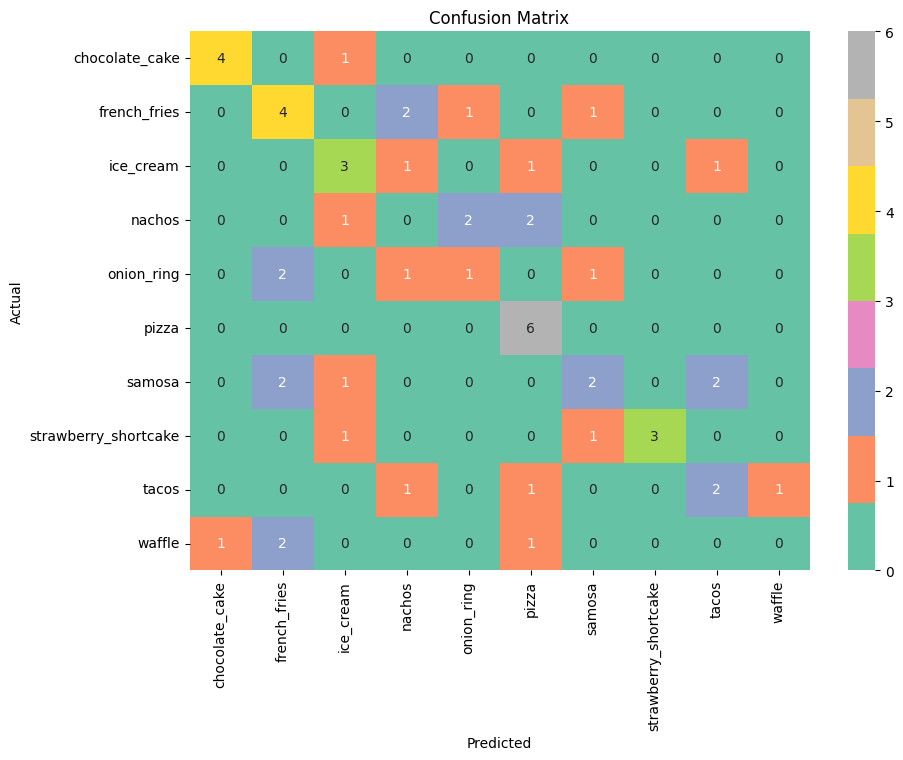

In [ ]:
plot_confusion_matrix(cnn_model_2,test_gen,list(test_gen.class_indices.keys()))

### Observation

- **Test accuracy** is at 45%
- **Overall Accuracy**: 43% — lesser from previous model which is at 50% .
- **Well-Classified Classes**:
  - `chocolate_cake`, `pizza`, `ice_cream`: Good precision and recall.
- **Moderate Performance**:
  - `french_fries`, `tacos`, `onion_ring`: Acceptable but need improvement.
- **Poorly Classified Classes**:
  - `samosa`, `nachos`, `waffle`, `strawberry_shortcake`: Low recall or F1-score; waffle has 0% recall.

### With he_normal and SGD

In [ ]:
checkpointer, earlystopping, reduceLR=get_callbacks(filepath='cnn_model_sgd.weights.h5')

In [ ]:
K.clear_session()
cnn_model_sgd=build_basic_cnn_2((128, 128, 3), 10,SGD(learning_rate=0.001))

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
cnn_model_sgd.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [ ]:
history = cnn_model_sgd.fit(
    train_gen,
    epochs=50,
    validation_data=valid_gen,
    callbacks=[checkpointer, reduceLR, earlystopping]
    )

Epoch 1/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step - accuracy: 0.1100 - loss: 2.9104
Epoch 1: val_loss improved from inf to 2.28927, saving model to cnn_model_sgd.weights.h5
14/14 ━━━━━━━━━━━━━━━━━━━━ 11s 425ms/step - accuracy: 0.1116 - loss: 2.8890 - val_accuracy: 0.1071 - val_loss: 2.2893 - learning_rate: 0.0010
Epoch 2/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - accuracy: 0.1326 - loss: 2.3050
Epoch 2: val_loss improved from 2.28927 to 2.27802, saving model to cnn_model_sgd.weights.h5
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 199ms/step - accuracy: 0.1324 - loss: 2.3047 - val_accuracy: 0.1429 - val_loss: 2.2780 - learning_rate: 0.0010
Epoch 3/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - accuracy: 0.1410 - loss: 2.2769
Epoch 3: val_loss improved from 2.27802 to 2.25607, saving model to cnn_model_sgd.weights.h5
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 204ms/step - accuracy: 0.1400 - loss: 2.2771 - val_accuracy: 0.2143 - val_loss: 2.2561 - learning_rate: 0.0010
Epoch 4/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 18

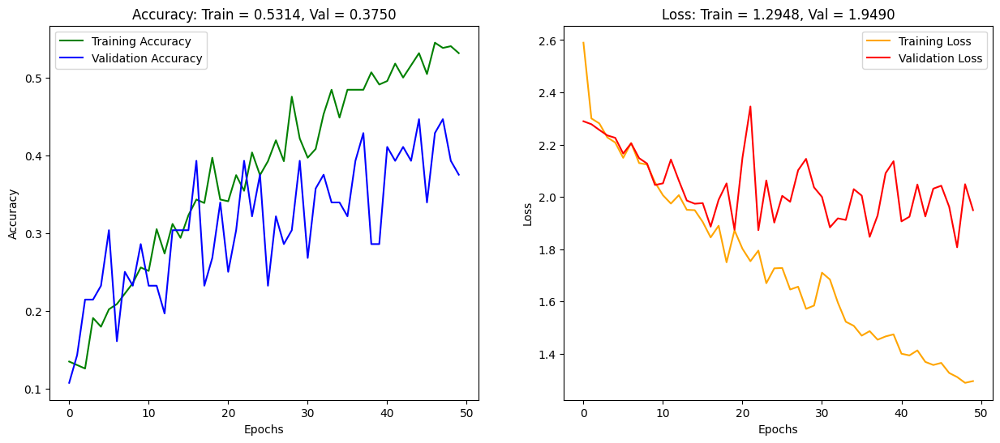

In [ ]:
plot_model_accuracy(history,cnn_model_sgd)

In [ ]:
cnn_model_sgd.evaluate(test_gen)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - accuracy: 0.5000 - loss: 1.6595


[1.6906964778900146, 0.5]

### Observations:
Not much Improvemnet with previous models .SGD did not make the curve smooth.Though test score is same as first model  but the training and validation score are lesser then first model .

In [ ]:
# SHow classfication report
generate_classification_report(cnn_model_sgd, test_gen)

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 268ms/step
                      precision    recall  f1-score   support

      chocolate_cake       0.83      1.00      0.91         5
        french_fries       0.50      0.75      0.60         8
           ice_cream       0.60      0.50      0.55         6
              nachos       0.00      0.00      0.00         5
          onion_ring       0.50      0.40      0.44         5
               pizza       0.50      1.00      0.67         6
              samosa       0.25      0.14      0.18         7
strawberry_shortcake       1.00      0.60      0.75         5
               tacos       0.40      0.40      0.40         5
              waffle       0.00      0.00      0.00         4

            accuracy                           0.50        56
           macro avg       0.46      0.48      0.45        56
        weighted avg       0.46      0.50      0.46        56



2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


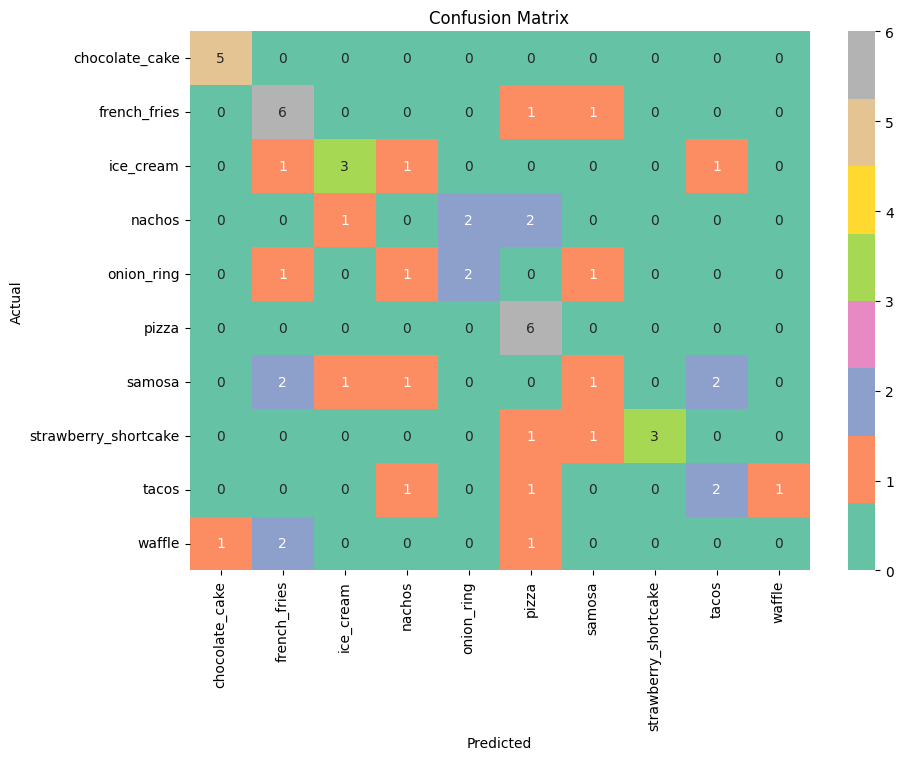

In [ ]:
# Show confusion matrix
plot_confusion_matrix(cnn_model_sgd,test_gen,list(test_gen.class_indices.keys()))

## Observations:
- **Test Accuracy**: 50%
- **Overall  Accuracy**: 46% less then 1st model (without he_normal)
- **High Performing Classes**: `chocolate_cake`, `pizza`, `ice_cream` show good precision and recall.
- **Poorly Learned Classes**: `samosa`, `onion_ring`, `strawberry_shortcake` — either completely misclassified or low recall.

Model performances is almost similar to 1st cnn model without he_normal and sgd(used Adam)

## Performances(Trained with Balnaced train,test,validation set):

###  Class-wise Observations

| Class                  | Best Model (based on F1)      | Comments                                  |
|------------------------|-------------------------------|-------------------------------------------|
| `chocolate_cake`       | Model 3(SGD+he_normal) (0.91)                | Excellent in all models.                  |
| `french_fries`         | Model 3(SGD+he_normal)) (0.60)                | Improved with SGD + He Normal.            |
| `ice_cream`            | Model 1(Adam) (0.62)                | Slight drop in Model 3.                   |
| `nachos`               | Model 1(Adam) (0.25)                | Still poor in all.                        |
| `onion_ring`           | Model 3(SGD+he_normal) (0.44)                | He Normal helped.                         |
| `pizza`                | Tie (1.00 recall in all)      | Always predicted correctly.               |
| `samosa`               | Model 2(Adam+henormal) (0.33)                | Still weak prediction.                    |
| `strawberry_shortcake`| Model 1 (0.57) / Model 2 & 3 (0.75) | Higher precision and recall with He Normal. |
| `tacos`               | Tie (~0.40 F1 across)         | Consistent poor performance.              |
| `waffle`               | Model 1(Adam) (0.29)                | Missed completely in Model 2 & 3.         |


### Visualizing the prediction (Model-1 Default Initializer and Adam):


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


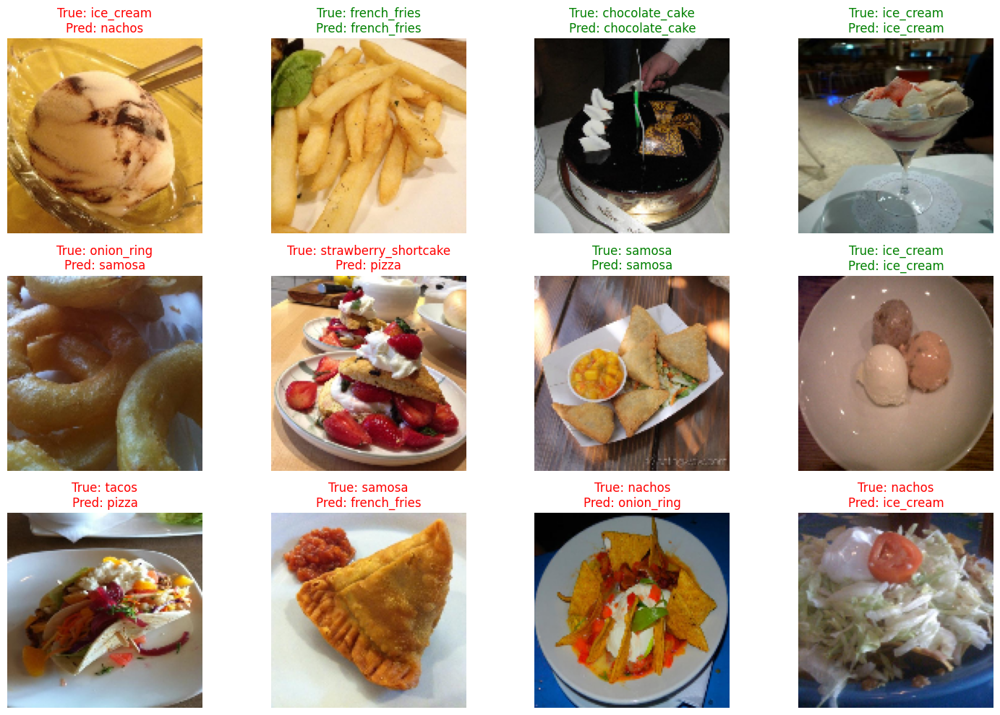

In [ ]:
# Visualise some predictions
visualize_predictions(model_2,test_gen,list(test_gen.class_indices.keys()))

### Observations:

- Strongest classes: chocolate_cake, pizza, ice_cream,French Fries

- Performs better on visually distinct items.

**Weaknesses:**

- Fails on subtle or similar-looking items: samosa, waffle, nachos, and strawberry_shortcake.
-  Somecases if there is some mayo like item in image it predict it as ice_cream might be due to similarity with icecream and mayo look.

- **Next Steps:**

- we can try adding more training data for weak classes.

- Use of  data augmentation or fine-tuning with class weighting to improve class balance.
- Use transfer leeraning from model like Efficientnet,mobilenet



## **Milestone-2**

### All Extra Imports for milestone 2

In [ ]:
from tensorflow.keras.applications import EfficientNetB1
from tensorflow.keras.applications import MobileNetV3Large
from tensorflow.keras.models import Model
from tensorflow.keras import layers
from tensorflow.keras.applications.efficientnet import  preprocess_input
from tensorflow.keras.applications.mobilenet_v3 import preprocess_input
import tensorflow as tf

from tqdm import tqdm
from PIL import Image

from tensorflow.keras.preprocessing.image import img_to_array

from sklearn.svm import LinearSVC
from sklearn.linear_model import Ridge
from sklearn.preprocessing import LabelEncoder

## Helper Function

In [ ]:
def get_image_generators(train_df, valid_df, test_df, base_path,
                         target_size=(224, 224),
                         preprocessing_function=None,
                         rescale=None,
                         batch_size=32,
                         rotation_range=15,
                         width_shift_range=0.1,
                         height_shift_range=0.1,
                         shear_range=0.1,
                         zoom_range=0.2,
                         brightness_range=[0.8, 1.2],
                         horizontal_flip=True,
                         vertical_flip=True,
                         fill_mode='nearest',
                         preprocessing_fn=None):
    """
    Create and return image generators for training, validation, and testing.

    Args:
        train_df: DataFrame containing training image filenames and labels.
        valid_df: DataFrame containing validation image filenames and labels.
        test_df: DataFrame containing test image filenames and labels.
        base_path: Directory where all images are stored.
        target_size: Tuple specifying the size to which all images are resized.
        preprocessing_function: (Deprecated, use preprocessing_fn) preprocessing function like those from EfficientNet.
        rescale: Rescaling factor (e.g., 1./255) to normalize pixel values.
        batch_size: Number of images per batch.
        rotation_range: Degree range for random rotations.
        width_shift_range: Fraction of total width to shift.
        height_shift_range: Fraction of total height to shift.
        shear_range: Shear intensity (shear angle in counter-clockwise direction in degrees).
        zoom_range: Range for random zoom.
        brightness_range: Range for picking a brightness shift value from [min, max].
        horizontal_flip: Randomly flip inputs horizontally.
        vertical_flip: Randomly flip inputs vertically.
        fill_mode: Strategy for filling in newly created pixels after transformations.
        preprocessing_fn: Preprocessing function to apply to each input image.

    Returns:
        A tuple containing:
        - train_gen: Generator for training images with data augmentation.
        - valid_gen: Generator for validation images (no augmentation).
        - test_gen: Generator for test images (no augmentation).
    """

    # Create the ImageDataGenerator for training with augmentation and optional preprocessing
    train_datagen = ImageDataGenerator(
        preprocessing_function=preprocessing_fn,  # Apply model-specific preprocessing
        rescale=rescale,                          # Normalize pixel values
        rotation_range=rotation_range,            # Random rotation
        width_shift_range=width_shift_range,      # Random horizontal shift
        height_shift_range=height_shift_range,    # Random vertical shift
        shear_range=shear_range,                  # Shear transformation
        zoom_range=zoom_range,                    # Zoom in/out
        brightness_range=brightness_range,        # Random brightness adjustment
        horizontal_flip=horizontal_flip,          # Flip image horizontally
        vertical_flip=vertical_flip,              # Flip image vertically
        fill_mode=fill_mode                       # Fill missing pixels using the given strategy
    )

    # Create ImageDataGenerator for validation and testing (no augmentation)
    test_valid_datagen = ImageDataGenerator(
        preprocessing_function=preprocessing_fn,  # Only apply preprocessing (no augmentation)
        rescale=rescale
    )

    # Create training data generator from DataFrame
    train_gen = train_datagen.flow_from_dataframe(
        train_df,                                 # DataFrame with image names and labels
        directory=base_path,                      # Directory path for images
        x_col='image_name',                       # Column with image filenames
        y_col='class_name',                       # Column with class labels
        target_size=target_size,                  # Resize images to target size
        class_mode='categorical',                 # One-hot encoded class labels
        batch_size=batch_size,                    # Number of samples per batch
        shuffle=True                              # Shuffle training data
    )

    # Create validation data generator (no shuffling)
    valid_gen = test_valid_datagen.flow_from_dataframe(
        valid_df,
        directory=base_path,
        x_col='image_name',
        y_col='class_name',
        target_size=target_size,
        class_mode='categorical',
        batch_size=batch_size,
        shuffle=False
    )

    # Create test data generator (no shuffling)
    test_gen = test_valid_datagen.flow_from_dataframe(
        test_df,
        directory=base_path,
        x_col='image_name',
        y_col='class_name',
        target_size=target_size,
        class_mode='categorical',
        batch_size=batch_size,
        shuffle=False
    )

    # Return the three generators
    return train_gen, valid_gen, test_gen


**Transfer Learning CNN Model with a Pretrained Base**

In [ ]:
def create_cnn_model_with_basemodel(base_model):
    """
    Creates a CNN model using a given pretrained base model with a custom classification head.

    Args:
        base_model: A pretrained model instance from tf.keras.applications (e.g., EfficientNetB0, MobileNetV2).

    Returns:
        model_transfer: A compiled Keras Model ready for training.
    """

    # Freeze the base model layers to prevent updating weights during training
    # This is useful for transfer learning when dataset is small
    base_model.trainable = False

    # Define the input layer with expected input shape (e.g., 224x224 RGB images)
    inputs = layers.Input(shape=(224, 224, 3), name="input_layer")

    # Pass the input through the base model
    x = base_model(inputs)

    # Add a global average pooling layer to reduce the spatial dimensions
    x = layers.GlobalAveragePooling2D(name="pooling_layer")(x)

    # Add dropout to reduce overfitting
    x = layers.Dropout(0.3)(x)

    # Dense layer with 10 units (assuming 10 classes for classification)
    x = layers.Dense(10)(x)

    # Final softmax activation to get class probabilities
    outputs = layers.Activation("softmax")(x)

    # Construct the final model
    model_transfer = Model(inputs, outputs)

    # Compile the model with Adam optimizer, categorical crossentropy loss, and accuracy metric
    model_transfer.compile(
        optimizer=Adam(learning_rate=0.001),
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )

    return model_transfer


## Optimization Of Previously Built CNN (Data Augmentation)

**Created augmented image generators for training, validation, and testing with enhanced data augmentation settings.**

In [ ]:
train_generator_aug, valid_generator_aug, test_generator_aug=get_image_generators(train_df,
                     valid_df,
                     test_df,
                     base_path,
                     rescale=1./255,
                     rotation_range=30,             # Increased rotation
                     width_shift_range=0.2,
                     height_shift_range=0.2,
                     shear_range=0.2,
                     zoom_range=0.3,                # More zoom
                     brightness_range=[0.8, 1.2],   # Random brightness
                     horizontal_flip=True,
                     vertical_flip=True,
                     fill_mode='nearest')


Found 446 validated image filenames belonging to 10 classes.
Found 56 validated image filenames belonging to 10 classes.
Found 56 validated image filenames belonging to 10 classes.


/usr/local/lib/python3.11/dist-packages/keras/src/legacy/preprocessing/image.py:920: UserWarning: Found 1 invalid image filename(s) in x_col="image_name". These filename(s) will be ignored.
  warnings.warn(


In [ ]:
# use previously defined model with augmented image on image genarator
cnn_opt=build_basic_cnn((128, 128, 3), 10)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
cnn_opt.fit(train_generator_aug, epochs=50, validation_data=valid_generator_aug)

Epoch 1/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 5s 372ms/step - accuracy: 0.2415 - loss: 2.0514 - val_accuracy: 0.2857 - val_loss: 2.0827
Epoch 2/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 4s 311ms/step - accuracy: 0.2508 - loss: 2.0415 - val_accuracy: 0.2679 - val_loss: 2.0470
Epoch 3/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 220ms/step - accuracy: 0.2875 - loss: 1.9549 - val_accuracy: 0.3393 - val_loss: 2.0942
Epoch 4/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 222ms/step - accuracy: 0.2839 - loss: 1.9625 - val_accuracy: 0.2679 - val_loss: 2.1167
Epoch 5/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 220ms/step - accuracy: 0.2668 - loss: 1.9914 - val_accuracy: 0.3214 - val_loss: 2.0588
Epoch 6/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 4s 313ms/step - accuracy: 0.2950 - loss: 1.9507 - val_accuracy: 0.3036 - val_loss: 2.0699
Epoch 7/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 219ms/step - accuracy: 0.3135 - loss: 1.9089 - val_accuracy: 0.3036 - val_loss: 2.1616
Epoch 8/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 3s 219ms/step - accuracy: 0.2937 - loss: 1.9841 - val_accuracy: 0.

**Observations on above:**
- Trained a CNN model with transfer learning over **50 epochs** using augmented image generators.
- **Training accuracy** improved from **24%** to **~47%**.
- **Validation accuracy** increased from **28%** to a peak of **~53%**.
- **Training loss** decreased steadily from **2.05** to **1.51**, indicating model learning.
- **Validation loss** fluctuated across epochs, showing signs of **overfitting**.
- Model shows **moderate generalization** and could benefit from:
  - Unfreezing some layers of the base model for fine-tuning.
  - Using techniques like early stopping, learning rate scheduling, or regularization.


### Observation:
We donot see much improvement wirth training and validation

In [ ]:
cnn_opt.evaluate(test_generator_aug)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - accuracy: 0.4554 - loss: 1.5011


[1.5250766277313232, 0.4642857015132904]

**Observation:**
Model Evaluation Summary
- Test Loss: 1.525
- Test Accuracy: 46.43%

Summary:
The CNN model shows moderate performance on the augmented test dataset. Accuracy is below 50%, indicating possible underfitting or a need for further tuning. Consider using more epochs, advanced architectures (like VGG16), or better data balancing to improve results.

No improvemnet with more augomenation like shear and zoom and brighteness change and more rotation .its almost similar to previous performance .

## **Transfer Learning**

### **Use Efficient Net**
Train, validation, and test generators were created using a helper function with EfficientNet's preprocessing and data augmentation applied.


In [ ]:
# Train test and validation generator using helper function with preprocessing passed from efficientnet
train_generator_tl, valid_generator_tl, test_generator_tl=get_image_generators(train_df,
                     valid_df,
                     test_df,
                     base_path,
    preprocessing_function=tf.keras.applications.efficientnet.preprocess_input, # from efficentnet
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.2,                # More zoom
    horizontal_flip=True,
    vertical_flip=True,)

Found 446 validated image filenames belonging to 10 classes.
Found 56 validated image filenames belonging to 10 classes.
Found 56 validated image filenames belonging to 10 classes.


/usr/local/lib/python3.11/dist-packages/keras/src/legacy/preprocessing/image.py:920: UserWarning: Found 1 invalid image filename(s) in x_col="image_name". These filename(s) will be ignored.
  warnings.warn(


### **Using EfficinetNet as base**

In [ ]:
    # Load EfficientNetB0 base model with pretrained ImageNet weights
    K.clear_session()
    bs_model = EfficientNetB1(include_top=False, weights='imagenet', input_shape=(224,224,3))
    cnn_model_effcinetnet=create_cnn_model_with_basemodel(bs_model)

In [ ]:
# Show summary
cnn_model_effcinetnet.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetb1 (Functional)     │ (None, 7, 7, 1280)     │     6,575,239 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pooling_layer                   │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1280)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 10)             │        12,810 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 10)             │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,588,049 (25.13 MB)

 Trainable params: 12,810 (50.04 KB)

 Non-trainable params: 6,575,239 (25.08 MB)

### Observations:
We can see around 6.5 million params there out of which 12,810 are trainable

- The model is built on top of EfficientNetB1 as a fixed (non-trainable) feature extractor.
- Total parameters: 6,588,049 (~25.13 MB).
- Trainable parameters: 12,810 (~50.04 KB), only in the classification head.
- Non-trainable parameters (from EfficientNetB1): 6,575,239 (~25.08 MB).
- A GlobalAveragePooling2D layer reduces the feature map dimensions before classification.
- A Dropout layer is used to reduce overfitting.
- Final Dense layer outputs predictions for 10 classes.
- The model is optimized for transfer learning with low training overhead.


- Defined model callbacks using a helper function:
  - ModelCheckpoint: Saves the best model to `model_tl_efnet.weights.h5`.
  - EarlyStopping: Stops training when validation performance stops improving.
  - ReduceLROnPlateau: Reduces learning rate when validation loss plateaus, helping the model converge better before early stopping is triggered.


In [ ]:
# Define checkpoint early stopping and reducelr (before stopping)
checkpointer, earlystopping, reduceLR=get_callbacks(filepath='model_tl_efnet.weights.h5')

In [ ]:
# fit the model and show history
history_eff_net=cnn_model_effcinetnet.fit(train_generator_tl,
                          epochs=50,
                          validation_data=valid_generator_tl,
                          callbacks=[checkpointer, reduceLR, earlystopping]
                          )

Epoch 1/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.1328 - loss: 2.4320
Epoch 1: val_loss improved from inf to 1.76983, saving model to model_tl_efnet.weights.h5
14/14 ━━━━━━━━━━━━━━━━━━━━ 65s 3s/step - accuracy: 0.1384 - loss: 2.4192 - val_accuracy: 0.5000 - val_loss: 1.7698 - learning_rate: 0.0010
Epoch 2/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 535ms/step - accuracy: 0.4697 - loss: 1.6712
Epoch 2: val_loss improved from 1.76983 to 1.31474, saving model to model_tl_efnet.weights.h5
14/14 ━━━━━━━━━━━━━━━━━━━━ 8s 605ms/step - accuracy: 0.4720 - loss: 1.6661 - val_accuracy: 0.7143 - val_loss: 1.3147 - learning_rate: 0.0010
Epoch 3/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step - accuracy: 0.6546 - loss: 1.2483
Epoch 3: val_loss improved from 1.31474 to 1.05390, saving model to model_tl_efnet.weights.h5
14/14 ━━━━━━━━━━━━━━━━━━━━ 7s 508ms/step - accuracy: 0.6558 - loss: 1.2452 - val_accuracy: 0.6964 - val_loss: 1.0539 - learning_rate: 0.0010
Epoch 4/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 530ms

Training Observation (Epochs 30–37)

- The model continues to show high training accuracy (~95–98%) with low training loss.
- Validation accuracy remains stable around 85–88%, showing no significant improvement.
- Validation loss slightly fluctuates around 0.50, with a minor improvement at Epoch 32:
  - Epoch 32: val_loss improved from 0.50878 to 0.49954 → model checkpoint saved.
- No further validation loss improvement observed after Epoch 32.
- Learning rate remains constant at 0.0010; ReduceLROnPlateau has not triggered yet.
- Model may be approaching performance saturation on the validation set.


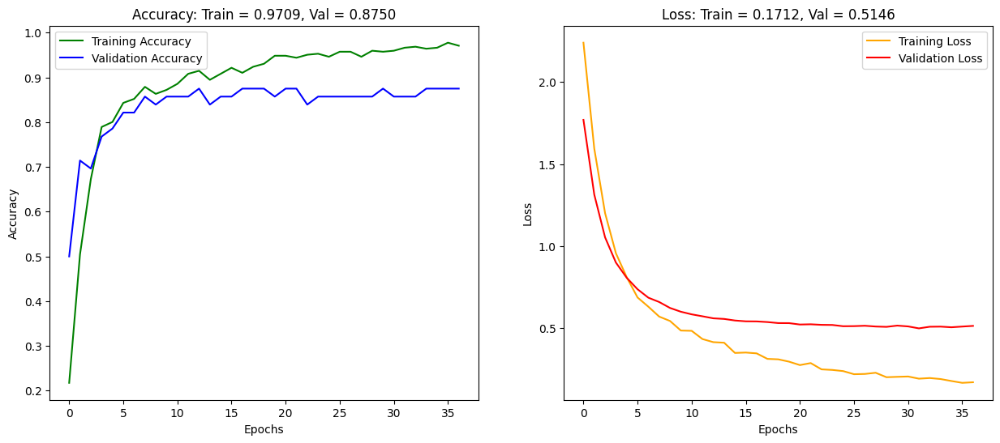

In [ ]:
# Show model accuracy
plot_model_accuracy(history_eff_net,cnn_model_effcinetnet)

### Obsrvations:
- We can see the model is kind of little bit overfitting with 97% accuracy on training where as validation accuracy stand at 87.5%
-  Still this is a good improvements over previous model.


**Observations from Model Training and Validation**

**Training & Validation Accuracy (Left Plot)**  
- Final Training Accuracy: 97.09%  
- Final Validation Accuracy: 87.50%  
- Training accuracy steadily increases and stabilizes near 97%.  
- Validation accuracy improves initially and plateaus around 87-88% from epoch ~10 onward.  
- A ~10% gap between training and validation accuracy suggests overfitting.

**Training & Validation Loss (Right Plot)**  
- Final Training Loss: 0.1712  
- Final Validation Loss: 0.5146  
- Training loss consistently decreases, showing the model is fitting the training data well.  
- Validation loss decreases initially but plateaus after ~10 epochs, indicating limited generalization.  
- The higher validation loss compared to training loss confirms mild overfitting.


In [ ]:
# Evaluate on test data
cnn_model_effcinetnet.evaluate(test_generator_tl)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - accuracy: 0.8423 - loss: 0.3950


[0.3819694519042969, 0.8571428656578064]

### Observations:
-  Test accuracy is around 84% which is far better then previous models without transfer learning

- **Test Loss:** 0.3820  
- **Test Accuracy:** 85.71%

The test accuracy is close to the validation accuracy (~87.50%), indicating that the model generalizes well and is not significantly overfitting.  
The test loss is also reasonably low, supporting consistent performance on unseen data.


2/2 ━━━━━━━━━━━━━━━━━━━━ 18s 8s/step


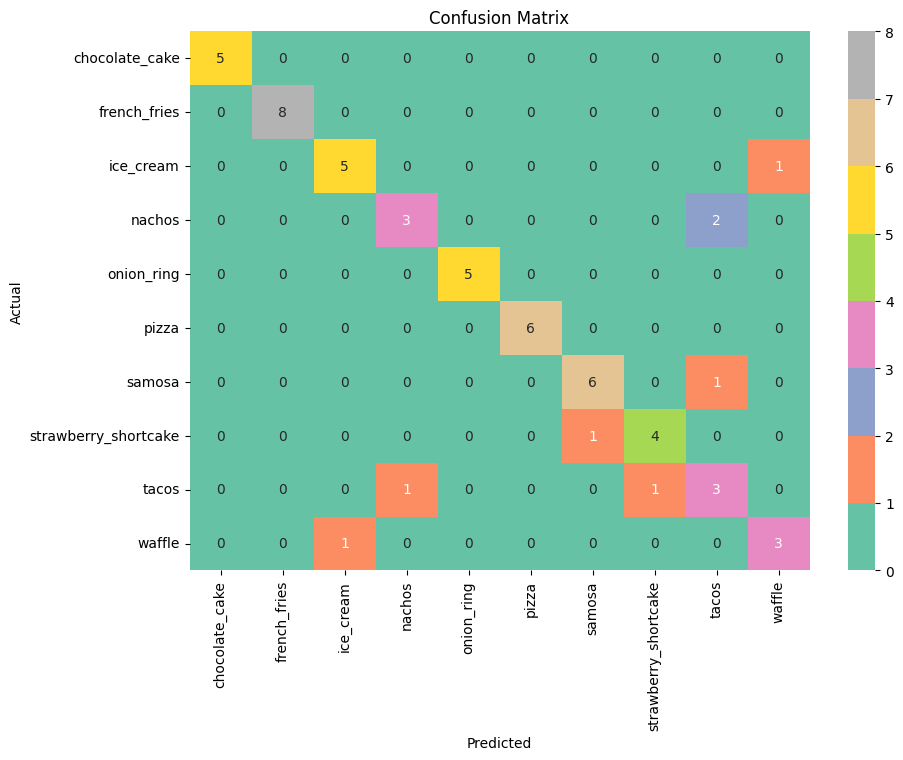

In [ ]:
# Show Confusion matrix
plot_confusion_matrix(cnn_model_effcinetnet,test_generator_tl,list(test_generator_tl.class_indices.keys()))

### Observations:
-  Classes Like **`pizza`,`chocolate_cake`,`frnech_fries`,`onion_ring`** are predicted quite correctly without any false positive or nagative.
- Classes like **ice_cream,nachos,samosh,waffle** has some mis classicfication
- **Tacos** has most miss classfication as some tacos are detected as **samosha** and **nachos**

In [ ]:
effcinet_net_res_df=generate_classification_report(cnn_model_effcinetnet, test_generator_tl)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
                      precision    recall  f1-score   support

      chocolate_cake       1.00      1.00      1.00         5
        french_fries       1.00      1.00      1.00         8
           ice_cream       0.83      0.83      0.83         6
              nachos       0.75      0.60      0.67         5
          onion_ring       1.00      1.00      1.00         5
               pizza       1.00      1.00      1.00         6
              samosa       0.86      0.86      0.86         7
strawberry_shortcake       0.80      0.80      0.80         5
               tacos       0.50      0.60      0.55         5
              waffle       0.75      0.75      0.75         4

            accuracy                           0.86        56
           macro avg       0.85      0.84      0.85        56
        weighted avg       0.86      0.86      0.86        56



### Observations:
- F1 score at .85 whih is good and accurcy is at 86% on test data
- There are missclassification w.r.t **tacos wafle ,strawberry_shortcake,ice_cream,nachos,samosa** which we had already observed in confusion matrix

#### This model has 6.5 million parameters due to which it might be overfitting with training .We will try with light model like Mobilenet

### **Base Model MobileNet**

In [ ]:
train_generator_tl_2, valid_generator_tl_2, test_generator_tl_2 = get_image_generators(
    train_df, valid_df, test_df, base_path,

    preprocessing_function=tf.keras.applications.mobilenet_v3.preprocess_input,

    rotation_range=15,               # Randomly rotate images within ±15 degrees
    width_shift_range=0.1,          # Shift image width by 10 percent
    height_shift_range=0.1,         # Shift image height by 10 percent
    shear_range=0.1,                # Apply shearing transformation
    zoom_range=0.2,                 # Zoom into the image by up to 20 percent
    horizontal_flip=True,           # Randomly flip images horizontally
    vertical_flip=True              # Randomly flip images vertically
)

Found 446 validated image filenames belonging to 10 classes.
Found 56 validated image filenames belonging to 10 classes.
Found 56 validated image filenames belonging to 10 classes.


/usr/local/lib/python3.11/dist-packages/keras/src/legacy/preprocessing/image.py:920: UserWarning: Found 1 invalid image filename(s) in x_col="image_name". These filename(s) will be ignored.
  warnings.warn(


In [ ]:
# define call back
checkpointer, earlystopping, reduceLR=get_callbacks(filepath='model_tl_mob_net.weights.h5')

In [ ]:
# clear session
K.clear_session()
# Load MobileNetV3Large base model with pretrained ImageNet weights
base_model = MobileNetV3Large(include_top=False, weights='imagenet', input_shape=(224,224,3))
cnn_model_mobilenet=create_cnn_model_with_basemodel(base_model)

In [ ]:
# Show summary
cnn_model_mobilenet.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ MobileNetV3Large (Functional)   │ (None, 7, 7, 960)      │     2,996,352 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pooling_layer                   │ (None, 960)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 960)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 10)             │         9,610 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_20 (Activation)      │ (None, 10)             │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,005,962 (11.47 MB)

 Trainable params: 9,610 (37.54 KB)

 Non-trainable params: 2,996,352 (11.43 MB)

**Observation**

Transfer Learning Model Summary (MobileNetV3 Large)

The model uses MobileNetV3 Large as the base for feature extraction with additional custom layers for classification:

• **Input Layer**:  
  - Shape: `(None, 224, 224, 3)`  
  - Accepts RGB images of size 224x224.

• **Base Model**:  
  - `MobileNetV3Large`  
  - Output Shape: `(None, 7, 7, 960)`  
  - Pretrained weights are frozen (non-trainable).  
  - Parameters: `2,996,352` (non-trainable)

• **Top Layers**:
  - `GlobalAveragePooling2D`: Converts 7×7×960 feature maps into 960-dimensional vector.
  - `Dropout`: Adds regularization by randomly dropping units during training.
  - `Dense`: Fully connected layer with 10 output neurons (for 10 classes).
  - `Activation`: Final activation layer for prediction (e.g., softmax).

• **Total Parameters**:  
  - `3,005,962` (~11.47 MB)  
  - Trainable: `9,610` (~37.5 KB)  
  - Non-trainable: `2,996,352` (~11.43 MB)

Only the custom top layers are trainable, making this a **fine-tuning** setup ideal for transfer learning with limited data.


In [ ]:
# Fit the model
history_mob_net=cnn_model_mobilenet.fit(train_generator_tl_2, epochs=50, validation_data=valid_generator_tl_2,callbacks=[checkpointer,earlystopping,reduceLR])

Epoch 1/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 760ms/step - accuracy: 0.1616 - loss: 2.8764
Epoch 1: val_loss did not improve from 0.49954
14/14 ━━━━━━━━━━━━━━━━━━━━ 29s 1s/step - accuracy: 0.1640 - loss: 2.8589 - val_accuracy: 0.4107 - val_loss: 1.7771 - learning_rate: 0.0010
Epoch 2/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step - accuracy: 0.3337 - loss: 1.9646
Epoch 2: val_loss did not improve from 0.49954
14/14 ━━━━━━━━━━━━━━━━━━━━ 7s 475ms/step - accuracy: 0.3368 - loss: 1.9548 - val_accuracy: 0.6429 - val_loss: 1.2365 - learning_rate: 0.0010
Epoch 3/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step - accuracy: 0.5347 - loss: 1.3579
Epoch 3: val_loss did not improve from 0.49954
14/14 ━━━━━━━━━━━━━━━━━━━━ 7s 490ms/step - accuracy: 0.5361 - loss: 1.3555 - val_accuracy: 0.7143 - val_loss: 0.9526 - learning_rate: 0.0010
Epoch 4/50
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 558ms/step - accuracy: 0.6158 - loss: 1.1742
Epoch 4: val_loss did not improve from 0.49954
14/14 ━━━━━━━━━━━━━━━━━━━━ 8s 577ms/step - accu

**Observations: Model Training Progress (Epochs 1–20)**

The model was trained for 50 epochs using a MobileNetV3 backbone with transfer learning. Below are key observations from the first 20 epochs:

• **Initial Performance (Epochs 1–3)**:
  - Training accuracy improved from **16% → 53%**, while validation accuracy improved from **41% → 71%**.
  - Loss values dropped significantly, indicating the model quickly began learning.

• **Mid-Epoch Improvement (Epochs 4–10)**:
  - Accuracy steadily increased, reaching ~81% training accuracy and ~83–87% validation accuracy.
  - Validation loss continuously dropped, indicating good generalization, though **val_loss did not beat the best (0.49954)** initially.

• **Stabilization Phase (Epochs 11–18)**:
  - Training accuracy reached up to **90%**.
  - Validation accuracy hovered around **82%–86%**, showing stable performance.
  - Validation loss remained just above the best threshold.

• **Significant Event – Epoch 19**:
  - `val_loss` improved to **0.49788**, beating the previous best.
  - Model checkpoint was saved as: `model_tl_efnet.weights.h5`.

• **Epoch 20**:
  - Training accuracy: **88.7%**
  - Validation accuracy: **85.7%**
  - `val_loss`: **0.5012** (slightly higher than the best)

**Best Validation Loss Achieved**:  
- `0.49788` at **Epoch 19**

The model continues to generalize well with increasing accuracy and gradually reducing validation loss, suggesting healthy training without overfitting (yet).


In [ ]:
# Evaluate on test data
cnn_model_mobilenet.evaluate(test_generator_tl_2)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - accuracy: 0.8185 - loss: 0.5493


[0.5688190460205078, 0.8214285969734192]

Test Set Evaluation (MobileNetV3 Model)

After training, the model was evaluated on the test dataset using `cnn_model_mobilenet.evaluate()`:

• **Test Loss**: `0.5688`  
• **Test Accuracy**: `82.14%`

The model demonstrates strong generalization with over **82% accuracy** on unseen test data, consistent with validation performance.

This indicates that the transfer learning approach with MobileNetV3 and data augmentation was effective in building a robust classifier.


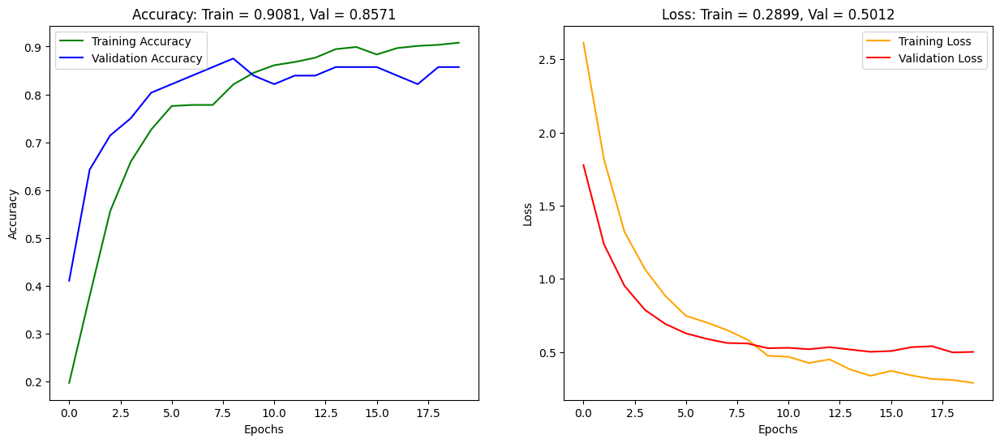

In [ ]:
# Show model accurcy plot
plot_model_accuracy(history_mob_net,cnn_model_effcinetnet)

### Observations:

The training and validation curves reveal strong learning dynamics and generalization:

Accuracy
- Training Accuracy: 0.9081 (≈ 90.81%)
- Validation Accuracy: 0.8571 (≈ 85.71%)
- The gap between training and validation accuracy is small, indicating low overfitting
- Validation accuracy plateaued after epoch ~10, suggesting the model converged early

Loss
- Training Loss: 0.2899
- Validation Loss: 0.5012
- Both training and validation loss decreased consistently
- The validation loss stabilized from epoch ~10, aligning with accuracy trends

Final Test Evaluation
- Test Accuracy: 82.14%
- Test Loss: 0.5688

Insights
- The model achieved excellent performance through transfer learning with MobileNetV3
- Training and validation curves indicate that early stopping could help prevent slight overfitting beyond epoch 10–12
- Potential improvements: learning rate tuning, data augmentation, or fine-tuning deeper layers

Overall, the model is well-trained and generalizes effectively to unseen data


2/2 ━━━━━━━━━━━━━━━━━━━━ 11s 6s/step


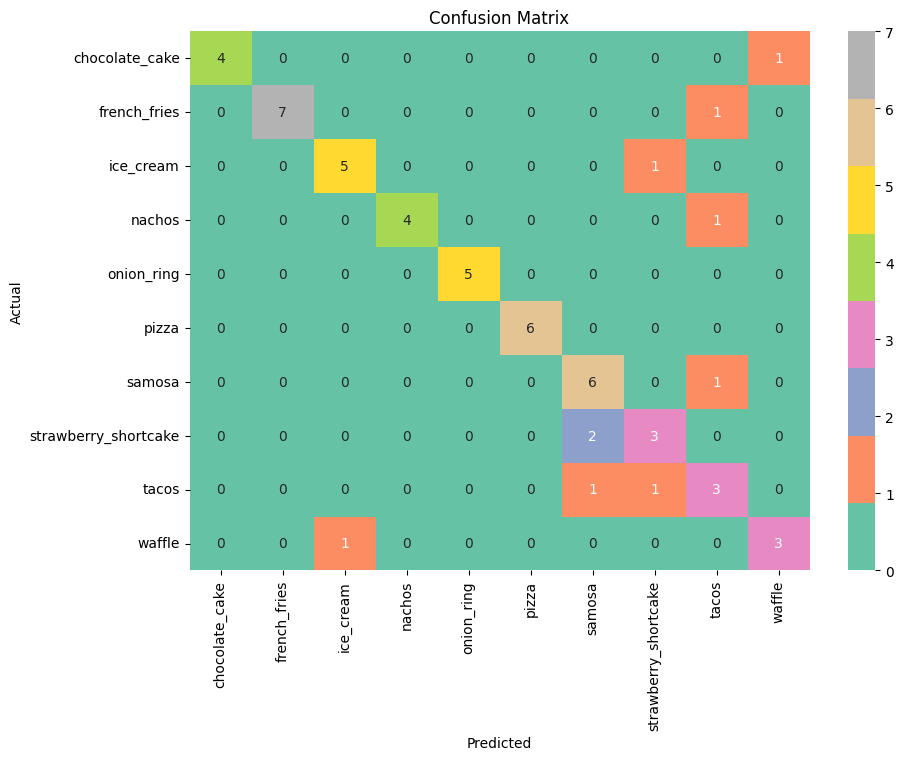

In [ ]:
plot_confusion_matrix(cnn_model_mobilenet,test_generator_tl,list(test_generator_tl_2.class_indices.keys()))

### Observations:
-  Classes Like **`pizza`,`chocolate_cake`,`frnech_fries`,`onion_ring`** are predicted quite correctly without any false positive or nagative.
- Classes like **ice_cream,nachos,samosh,waffle** has some mis classicfication
- **Tacos** has most miss classfication as some tacos are detected as **samosha** and **nachos**
-  **Samosha** is also having so many misclassification detected as **straberry_shortcake** or **tacos**
-  There is an increase in missclassfication for strawberry short cake. compared to efficientnet

In [ ]:
# Show classification report
mobilenet_res_df=generate_classification_report(cnn_model_mobilenet, test_generator_tl_2)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
                      precision    recall  f1-score   support

      chocolate_cake       1.00      0.80      0.89         5
        french_fries       1.00      0.88      0.93         8
           ice_cream       0.83      0.83      0.83         6
              nachos       1.00      0.80      0.89         5
          onion_ring       1.00      1.00      1.00         5
               pizza       1.00      1.00      1.00         6
              samosa       0.67      0.86      0.75         7
strawberry_shortcake       0.60      0.60      0.60         5
               tacos       0.50      0.60      0.55         5
              waffle       0.75      0.75      0.75         4

            accuracy                           0.82        56
           macro avg       0.83      0.81      0.82        56
        weighted avg       0.84      0.82      0.83        56



Classification Report Analysis (MobileNetV3 Fine-Tuned Model)

Overall Accuracy
- The model achieved an overall accuracy of 82% on the test set (56 images)

Class-wise Performance
- chocolate_cake: Perfect precision (1.00) but recall 0.80, indicating some missed instances
- french_fries: High precision and recall, F1-score of 0.93, indicating strong prediction confidence
- ice_cream: Balanced precision and recall (0.83), suggesting consistent performance
- nachos: High precision (1.00), slightly lower recall (0.80), potential false negatives
- onion_ring & pizza: Perfect classification (precision, recall, F1 all 1.00)
- samosa: Lower precision (0.67) but high recall (0.86), model often predicts samosa but includes some incorrect ones
- strawberry_shortcake: F1-score of 0.60 shows the model struggles with this class, possibly due to limited or ambiguous features
- tacos: Lowest performing class with F1-score of 0.55, indicating confusion with similar-looking items
- waffle: Moderate F1-score (0.75), fair performance

Macro Average (Unweighted)
- Precision: 0.83
- Recall: 0.81
- F1-score: 0.82

Weighted Average (Accounts for Support/Class Size)
- Precision: 0.84
- Recall: 0.82
- F1-score: 0.83

Insights
- Classes with perfect scores suggest strong feature recognition
- Lower scores in strawberry_shortcake and tacos may need:
  - More training samples
  - Better data augmentation
  - Possible class merging or clearer labeling if visual overlap exists
- Overall model is well balanced with only minor class-specific improvements needed


### Model Selection

In [ ]:
# Show overall refult for comparision
df1=effcinet_net_res_df.drop('support',axis=1).add_suffix("_efficentnet")
df2=mobilenet_res_df.drop('support',axis=1).add_suffix("_mobilenet")

pd.concat([df1,df2],axis=1)

,precision_efficentnet,recall_efficentnet,f1-score_efficentnet,precision_mobilenet,recall_mobilenet,f1-score_mobilenet
chocolate_cake,1.000000,1.000000,1.000000,1.000000,0.800000,0.888889
french_fries,1.000000,1.000000,1.000000,1.000000,0.875000,0.933333
ice_cream,0.833333,0.833333,0.833333,0.833333,0.833333,0.833333
nachos,0.750000,0.600000,0.666667,1.000000,0.800000,0.888889
onion_ring,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
pizza,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
samosa,0.857143,0.857143,0.857143,0.666667,0.857143,0.750000
strawberry_shortcake,0.800000,0.800000,0.800000,0.600000,0.600000,0.600000
tacos,0.500000,0.600000,0.545455,0.500000,0.600000,0.545455
waffle,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000


**Model Comparison: EfficientNet vs MobileNetV3**

Performance Summary:

- **EfficientNet**
  - Test Loss: 0.3820
  - Test Accuracy: 85.71%
  - Weighted F1-Score: 0.858
  - Macro F1-Score: 0.845
  - Training Time: ~8 minutes 50 seconds

- **MobileNetV3**
  - Test Loss: 0.5688
  - Test Accuracy: 82.14%
  - Weighted F1-Score: 0.827
  - Macro F1-Score: 0.819
  - Training Time: ~2 minutes 30 seconds


Observations:
- **EfficientNet** shows slightly better overall metrics than **MobileNetV3**, with higher weighted and macro averages.
- **EfficientNet** outperforms MobileNetV3 on harder classes like `strawberry_shortcake` and `samosa`.
- MobileNet catches up in `nachos`, `tacos`, and performs equally well in `pizza` and `onion_ring`.
- **Recommendation**: If your use case prioritizes consistent class-wise performance and slightly better general accuracy, choose **EfficientNet**. If inference speed and lighter deployment are more critical, **MobileNetV3** still performs competitively.

- **EfficientNet** achieved higher accuracy and F1-scores compared to MobileNetV3, indicating better classification performance across most classes.
- However, **EfficientNet took significantly longer to train (~8 mins 50 secs)** due to its deeper architecture and more parameters (20M+).
- **MobileNetV3**, while slightly behind in performance, **trained much faster (~2 mins 30 secs)** and still achieved respectable accuracy and F1-scores.
- This makes **MobileNetV3 more suitable for real-time or resource-constrained environments**, where training time or model size is critical.
- On the other hand, **EfficientNet is better suited for scenarios where higher accuracy is prioritized over speed or computational cost**.


## Object Detection

#### Needed as sometimes collab has updated package which fails to have selecetive search

In [ ]:
!pip uninstall -y opencv-python opencv-contrib-python numpy
!pip install numpy==1.26.4
!pip install opencv-contrib-python==4.8.0.76


Found existing installation: opencv-python 4.11.0.86
Uninstalling opencv-python-4.11.0.86:
  Successfully uninstalled opencv-python-4.11.0.86
Found existing installation: opencv-contrib-python 4.11.0.86
Uninstalling opencv-contrib-python-4.11.0.86:
  Successfully uninstalled opencv-contrib-python-4.11.0.86
Found existing installation: numpy 2.0.2
Uninstalling numpy-2.0.2:
  Successfully uninstalled numpy-2.0.2
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 36.9 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dopamine-rl 4.1.2 requires opencv-python>=3.4.8.29, which is not installed.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.26.4 which is incompatible.


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 MB 13.3 MB/s eta 0:00:00


In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 27.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 119.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 89.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 62.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 94.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling

In [ ]:
import os
import numpy as np                                                                               # Importing numpy for Matrix Operations
import pandas as pd                                                                              # Importing pandas to read CSV files
import matplotlib.pyplot as plt                                                                  # Importting matplotlib for Plotting and visualizing images
import math                                                                                      # Importing math module to perform mathematical operations
import cv2                                                                                       # Importing openCV for image processing
import seaborn as sns                                                                            # Importing seaborn to plot graphs
from collections import defaultdict
import random
import shutil
import os

# Tensorflow modules
import tensorflow as tf
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential # Importing the sequential module to define a sequential model
from keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D,MaxPool2D, GlobalAveragePooling2D, Input, BatchNormalization, Multiply, Activation
from tensorflow.keras.optimizers import Adam,SGD,Optimizer
from tensorflow.keras.utils import to_categorical


# sklearn lib
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from keras import backend as K
from sklearn.model_selection import train_test_split # train test split
from sklearn.preprocessing import LabelEncoder # label encoder
from sklearn.metrics import accuracy_score, classification_report

from tensorflow.keras.applications import EfficientNetB1
from tensorflow.keras.applications import MobileNetV3Large
from tensorflow.keras.models import Model
from tensorflow.keras import layers
from tensorflow.keras.applications.efficientnet import  preprocess_input
from tensorflow.keras.applications.mobilenet_v3 import preprocess_input
from sklearn.svm import LinearSVC

# tensorflow lib
import tensorflow as tf

from tqdm import tqdm
from PIL import Image

from tensorflow.keras.preprocessing.image import img_to_array

from sklearn.linear_model import Ridge
from sklearn.preprocessing import LabelEncoder
from PIL import UnidentifiedImageError
import matplotlib.patches as patches
import pickle
# pytorch
import torch
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torch.utils.data import Dataset
from torchvision.transforms import functional as F
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torch.utils.data import DataLoader
# Image augomomenation
import albumentations as A
from albumentations.pytorch import ToTensorV2
import shutil
import yaml
# Set seeds for reproducibility
seed_value = 42

random.seed(seed_value)
np.random.seed(seed_value)
tf.random.set_seed(seed_value)
os.environ['PYTHONHASHSEED'] = str(seed_value)

In [ ]:
# Mount Google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Unzip the annotated dataset
!unzip '/content/drive/MyDrive/Python Course_shared/computer Vision/annotation/Food-101-Annotated-V4.zip'


Archive:  /content/drive/MyDrive/Python Course_shared/computer Vision/annotation/Food-101-Annotated-V4.zip
replace __MACOSX/._Food-101-Annotated? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: __MACOSX/._Food-101-Annotated  
  inflating: __MACOSX/Food-101-Annotated/._ice_cream  
  inflating: __MACOSX/Food-101-Annotated/._samosa  
  inflating: Food-101-Annotated/.DS_Store  
  inflating: __MACOSX/Food-101-Annotated/._.DS_Store  
  inflating: __MACOSX/Food-101-Annotated/._onion_ring  
  inflating: __MACOSX/Food-101-Annotated/._strawberry_shortcake  
  inflating: __MACOSX/Food-101-Annotated/._waffle  
  inflating: Food-101-Annotated/annotation_refined.csv  
  inflating: __MACOSX/Food-101-Annotated/._annotation_refined.csv  
  inflating: __MACOSX/Food-101-Annotated/._chocolate_cake  
  inflating: __MACOSX/Food-101-Annotated/._tacos  
  inflating: __MACOSX/Food-101-Annotated/._pizza  
  inflating: __MACOSX/Food-101-Annotated/._nachos  
  inflating: __MACOSX/Food-101-Annotated/._french_

In [ ]:
# base path of annotated images
base_path='Food-101-Annotated/'

### Helper Functions

In [ ]:
def compute_iou(boxA, boxB):
    '''
    Compute Intersection over Union (IoU) between two bounding boxes.

    Args:
        boxA: List or tuple with 4 elements [x1, y1, x2, y2] for box A.
        boxB: List or tuple with 4 elements [x1, y1, x2, y2] for box B.

    Returns:
        IoU value: A float between 0 and 1 representing overlap ratio.
    '''

    # Compute coordinates of the intersection rectangle
    xA = max(boxA[0], boxB[0])  # Left
    yA = max(boxA[1], boxB[1])  # Top
    xB = min(boxA[2], boxB[2])  # Right
    yB = min(boxA[3], boxB[3])  # Bottom

    # Compute the area of intersection rectangle
    inter = max(0, xB - xA) * max(0, yB - yA)

    # Compute the area of both bounding boxes
    boxAArea = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    boxBArea = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])

    # Compute IoU using the formula: intersection / union
    iou = inter / float(boxAArea + boxBArea - inter + 1e-5)

    return iou


In [ ]:
def load_annotations_and_convert_yolo_bb(df, base_dir):
    '''
    Load bounding box annotations from a DataFrame and convert YOLO format to pixel coordinates.

    Args:
        df: Pandas DataFrame containing YOLO-format bounding boxes. 
            Expected columns: ['image_name', 'x_center', 'y_center', 'width', 'height', 'class_name']
        base_dir: Base directory where image files are stored.

    Returns:
        boxes: Dictionary mapping image paths to a list of bounding boxes.
               Each box is represented as [xmin, ymin, xmax, ymax, class_name]
    '''

    boxes = {}

    # Iterate over each row (annotation) in the DataFrame
    for _, row in df.iterrows():
        image_path = os.path.join(base_dir, row['image_name'])

        # Initialize list of boxes for this image if not already present
        if image_path not in boxes:
            boxes[image_path] = []

        try:
            # Open image to get width and height
            image = Image.open(image_path)
            w, h = image.size
        except (FileNotFoundError, UnidentifiedImageError) as e:
            continue  # Skip this row if image is missing or unreadable

        # Extract YOLO format bounding box: center_x, center_y, width, height (all relative)
        xc, yc, bw, bh = row['x_center'], row['y_center'], row['width'], row['height']

        # Convert YOLO format to pixel coordinates
        xmin = int((xc - bw / 2) * w)
        ymin = int((yc - bh / 2) * h)
        xmax = int((xc + bw / 2) * w)
        ymax = int((yc + bh / 2) * h)

        # Append bounding box with class name to the dictionary
        boxes[image_path].append([xmin, ymin, xmax, ymax, row['class_name']])

    return boxes


In [ ]:
def split_df_by_image_with_first_class(df, test_size=0.2, random_state=42):
    '''
    Split the DataFrame into stratified training and testing sets,
    using the first class label associated with each unique image.

    Args:
        df: Pandas DataFrame containing at least 'image' and 'class_name' columns.
            Can contain multiple rows per image if there are multiple annotations.
        test_size: Proportion of the dataset to include in the test split.
        random_state: Controls the shuffling applied to the data before splitting.

    Returns:
        train_df: Subset of original df used for training.
        test_df: Subset of original df used for testing.
    '''

    # Extract the first occurrence of each image and its class label
    image_classes = df.drop_duplicates('image')[['image', 'class_name']]

    # Perform stratified split based on the first class label per image
    train_images, test_images = train_test_split(
        image_classes['image'],                         # only use unique images
        test_size=test_size,                            # percentage for test split
        random_state=random_state,                      # reproducibility
        stratify=image_classes['class_name']            # ensure balanced class distribution
    )

    # Filter the original DataFrame to get training and test subsets
    train_df = df[df['image'].isin(train_images)].reset_index(drop=True)
    test_df  = df[df['image'].isin(test_images)].reset_index(drop=True)

    return train_df, test_df


In [ ]:
def visualize_multiple_images(image_data_list, threshold=0.0, cols=3):
    """
    image_data_list: list of tuples [(image_path, predictions, ground_truths), ...]
    predictions: list of dicts with 'bbox', 'label', 'score'
    ground_truths: list of [x1, y1, x2, y2, class_name]
    """
    rows = (len(image_data_list) + cols - 1) // cols
    fig, axs = plt.subplots(rows, cols, figsize=(3 * cols, 3 * rows))

    # If only one row, axs will be 1D; flatten for uniformity
    axs = axs.flatten() if isinstance(axs, np.ndarray) else [axs]

    for idx, item in enumerate(image_data_list):
        image_path, predictions, ground_truths = item['image_path'], item['predictions'], item['ground_truths']
        ax = axs[idx]
        image = plt.imread(image_path)
        ax.imshow(image)

        # Ground Truths in green
        for gt in ground_truths:
            x1, y1, x2, y2, cls = gt
            rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='g', facecolor='none')
            ax.text(x1, y1 - 5, f'{cls}', color='g', fontsize=8,
                    bbox=dict(facecolor='white', edgecolor='g', boxstyle='round,pad=0.2'))
            ax.add_patch(rect)

        # Predictions in red
        for pred in predictions:
            x1, y1, x2, y2 = pred["bbox"]
            label = pred["label"]
            score = pred.get("score", 1.0)

            ious = [compute_iou([x1, y1, x2, y2], gt[:4]) for gt in ground_truths if gt[4] == label]
            iou = max(ious) if ious else 0.0
            if iou < threshold:
                continue

            rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor='r', facecolor='none')
            ax.text(x1, y1 - 5, f'{label} IoU: {iou:.2f}', color='r', fontsize=8,
                    bbox=dict(facecolor='white', edgecolor='r', boxstyle='round,pad=0.2'))
            ax.add_patch(rect)

        ax.set_title("Predicted(Red)+GT(Green) ")
        ax.axis('off')

    # Hide unused subplots
    for i in range(len(image_data_list), len(axs)):
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()

In [ ]:
from collections import defaultdict
import numpy as np

def evaluate_map(predictions_by_image, ground_truth_by_image, iou_threshold=0.5):
    """
    Calculate mean Average Precision (mAP) across all classes.

    Args:
        predictions_by_image: dict of {image_path: list of predictions},
                              where each prediction = {'label', 'bbox', 'score'}
        ground_truth_by_image: dict of {image_path: list of ground truths},
                              where each gt = [x1, y1, x2, y2, label]
        iou_threshold: float, IoU threshold to consider a prediction as correct.

    Returns:
        mAP score (float), and per-class AP (dict)
    """

    class_preds = defaultdict(list)  # class -> list of (score, TP/FP)
    class_gts = defaultdict(int)     # class -> number of GT boxes

    for image, gts in ground_truth_by_image.items():
        gt_boxes = [gt[:4] for gt in gts]
        gt_labels = [gt[4] for gt in gts]
        matched = set()

        for pred in sorted(predictions_by_image.get(image, []), key=lambda x: -x['score']):
            pred_box = pred['bbox']
            pred_label = pred['label']
            best_iou, best_gt_idx = 0, -1

            for i, (gt_box, gt_label) in enumerate(zip(gt_boxes, gt_labels)):
                if i in matched or gt_label != pred_label:
                    continue
                iou = compute_iou(pred_box, gt_box)
                if iou > best_iou:
                    best_iou = iou
                    best_gt_idx = i

            if best_iou >= iou_threshold:
                matched.add(best_gt_idx)
                class_preds[pred_label].append((pred['score'], 1))  # True Positive
            else:
                class_preds[pred_label].append((pred['score'], 0))  # False Positive

        for label in gt_labels:
            class_gts[label] += 1

    ap_per_class = {}
    for cls, preds in class_preds.items():
        preds.sort(reverse=True)
        tp = np.array([x[1] for x in preds])
        fp = 1 - tp
        cum_tp = np.cumsum(tp)
        cum_fp = np.cumsum(fp)
        precision = cum_tp / (cum_tp + cum_fp + 1e-6)
        recall = cum_tp / (class_gts[cls] + 1e-6)

        # Interpolated AP calculation
        ap = 0.0
        for t in np.linspace(0, 1, 11):
            p = precision[recall >= t].max() if np.any(recall >= t) else 0
            ap += p / 11
        ap_per_class[cls] = ap

    mAP = np.mean(list(ap_per_class.values())) if ap_per_class else 0.0
    return mAP, ap_per_class


### Train Test Split

In [30]:
# Create Annotation DF
annotation_df=pd.read_csv(f"{base_path}/annotation_refined.csv")
annotation_df['image_name']=annotation_df.apply(lambda row: f"{row['class_name']}/{row['image']}",axis=1)

Splitting dataset into train and test sets

- Uses `split_df_by_image_with_first_class` to ensure stratified split based on class
- 80% images used for training, 20% for testing
- Ensures that images with the same first class stay together in the same split


In [ ]:
# Split data set by classname
train_df,test_df=split_df_by_image_with_first_class(annotation_df,test_size=0.2)

In [ ]:
# print train test df
print(train_df.shape)
print(test_df.shape)

(870, 7)
(220, 7)


Train and test DataFrame shape

- Training set shape: (870, 7)
- Testing set shape: (220, 7)

Each row represents a bounding box annotation.  
This means the training set contains 870 annotations, and the test set contains 220.


### **RCNN**

**RCNN (Region-based Convolutional Neural Network)**

- Uses *Selective Search* to generate around 2000 region proposals per image.
- Each proposed region is cropped and warped, then passed through a CNN (e.g., AlexNet/VGG16) to extract features.
- These features are sent to:
  - an SVM classifier to determine the object class
  - a linear regressor to refine bounding box coordinates
- RCNN is accurate but computationally expensive due to repeated CNN operations on overlapping regions.

![R-CNN Pipeline](https://kikaben.com/faster-r-cnn-rpn/images/R-CNN-pipeline.png)


**Custom RCNN Class**

**RCNN Model (Custom Implementation)**

- Implements the traditional RCNN architecture using Selective Search for region proposals.
- Uses a pre-trained CNN (e.g., VGG16) as a feature extractor for region proposals.
- Trains:
  - an SVM for object classification,
  - a Ridge Regressor for bounding box refinement.
- Handles image resizing with padding to maintain aspect ratio for CNN input.
- Predicts bounding boxes and classes on new images by extracting region proposals and classifying each using the trained models.
- Includes model persistence via pickle for SVM, regressor, and label encoder, and HDF5 for CNN backbone.

In [ ]:
# Define RCNN tradional model
class RCNN:
    def __init__(self, cnn_backbone, max_proposals=200):
        self.cnn_backbone = cnn_backbone
        self.max_proposals = max_proposals
        self.encoder = LabelEncoder()
        self.svm = LinearSVC(max_iter=10000)
        self.bbox_regressor = Ridge()

    def resize_with_padding(self, image, target_size=(224, 224)):
        '''
        Resize image with padding
        '''
        old_size = image.size
        ratio = min(target_size[0] / old_size[0], target_size[1] / old_size[1])
        new_size = (int(old_size[0] * ratio), int(old_size[1] * ratio))
        image = image.resize(new_size, Image.Resampling.LANCZOS)

        new_im = Image.new("RGB", target_size)
        paste_position = ((target_size[0] - new_size[0]) // 2, (target_size[1] - new_size[1]) // 2)
        new_im.paste(image, paste_position)
        return new_im

    def extract_features(self, images_pil):
        '''
        Extract features from images using CNN
        '''
        images_pil = [self.resize_with_padding(img) for img in images_pil]
        arr = np.array([preprocess_input(img_to_array(img)) for img in images_pil])
        return self.cnn_backbone.predict(arr, verbose=0)

    def selective_search(self, img, max_proposals):
        '''
        Generate proposals using selective search
        '''
        ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
        ss.setBaseImage(img)
        ss.switchToSelectiveSearchFast()
        rects = ss.process()
        return rects[:max_proposals]

    def train(self, df, image_dir):
        '''
        Train RCNN model
        '''
        print("Training RCNN model...")
        annotations = load_annotations_and_convert_yolo_bb(df, image_dir)
        X, y_labels, bbox_deltas = [], [], []

        for path, gt_boxes in tqdm(annotations.items(), desc="Processing training data"):
            image_cv = cv2.imread(path)
            if image_cv is None:
                print(f"Warning: Could not read image {path}")
                continue

            rects = self.selective_search(image_cv, self.max_proposals)
            rois_pil, coords = [], []

            for (x, y, w, h) in rects:
                x2, y2 = x + w, y + h
                roi = image_cv[y:y2, x:x2]
                if roi.shape[0] < 20 or roi.shape[1] < 20:
                    continue
                roi_pil = Image.fromarray(cv2.cvtColor(roi, cv2.COLOR_BGR2RGB))
                roi_pil = self.resize_with_padding(roi_pil)
                rois_pil.append(roi_pil)
                coords.append((x, y, x2, y2))

            if not rois_pil:
                continue

            features_batch = self.extract_features(rois_pil)

            for features, (x, y, x2, y2) in zip(features_batch, coords):
                max_iou = 0
                assigned_label = "background"
                assigned_box = None

                for gt in gt_boxes:
                    iou = compute_iou([x, y, x2, y2], gt[:4])
                    if iou > max_iou:
                        max_iou = iou
                        assigned_label = gt[4]
                        assigned_box = gt[:4]

                X.append(features)
                y_labels.append(assigned_label)

                if assigned_label != "background":
                    dx1 = assigned_box[0] - x
                    dy1 = assigned_box[1] - y
                    dx2 = assigned_box[2] - x
                    dy2 = assigned_box[3] - y
                    bbox_deltas.append([dx1, dy1, dx2, dy2])
                else:
                    bbox_deltas.append([0, 0, 0, 0])

        y_encoded = self.encoder.fit_transform(y_labels)
        self.svm.fit(X, y_encoded)
        self.bbox_regressor.fit(X, bbox_deltas)
        print("Training complete.")

    def predict(self, image_path):
        '''
        Predict using RCNN model
        '''
        image_cv = cv2.imread(image_path)
        if image_cv is None:
            raise ValueError(f"Image at {image_path} could not be read")

        rects = self.selective_search(image_cv, self.max_proposals)
        predictions = []

        for (x, y, w, h) in rects:
            x2, y2 = x + w, y + h
            roi = image_cv[y:y2, x:x2]
            if roi.shape[0] < 64 or roi.shape[1] < 64:
                continue

            roi_pil = Image.fromarray(cv2.cvtColor(roi, cv2.COLOR_BGR2RGB))
            roi_pil = self.resize_with_padding(roi_pil)

            features = self.extract_features([roi_pil])[0].reshape(1, -1)

            scores = self.svm.decision_function(features)[0]
            pred_cls_index = np.argmax(scores)
            confidence = scores[pred_cls_index]
            label = self.encoder.inverse_transform([pred_cls_index])[0]

            if label == "background":
                continue

            deltas = self.bbox_regressor.predict(features)[0]
            final_box = [x + int(deltas[0]), y + int(deltas[1]), x + int(deltas[2]), y + int(deltas[3])]
            height, width = image_cv.shape[:2]

            x1 = max(0, min(final_box[0], width - 1))
            y1 = max(0, min(final_box[1], height - 1))
            x2 = max(0, min(final_box[2], width - 1))
            y2 = max(0, min(final_box[3], height - 1))

            predictions.append({
                "label": label,
                "bbox": [x1, y1, x2, y2],
                "score": float(confidence)
            })

        return predictions

    def save_to_disk(self):
        '''
        Save RCNN model to disk
        '''
        with open("svm_classifier.pkl", "wb") as f:
            pickle.dump(self.svm, f)
        with open("bbox_regressor.pkl", "wb") as f:
            pickle.dump(self.bbox_regressor, f)
        with open("label_encoder.pkl", "wb") as f:
            pickle.dump(self.encoder, f)
        self.cnn_backbone.save("cnn_feature_extractor.h5")


**Train RCNN Model**

- We define the RCNN model using `EfficientNetB1` as the CNN backbone, pre-trained on ImageNet.
- The model is configured to generate up to **400 region proposals** per image using Selective Search.
- Training is performed on the dataset using:
  - a **Linear SVM** for classifying each region,
  - and a **Ridge Regressor** for refining bounding box coordinates.

In [ ]:
# Define RCNN Model with 400 max proposals
model=RCNN(EfficientNetB1(weights="imagenet", include_top=False, pooling='avg'),max_proposals=400)
model.train(train_df,base_path)

27018416/27018416 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


Processing training data: 100%|██████████| 453/453 [52:37<00:00,  6.97s/it]


Training complete.


### Observations:
- Computionally expenshive as it toook more then 1.3 hours for 400 region proposal
- This might be due to the selective search Algorithim which pass each region again and again and doonot reuse th features maps


**Inference and Visualization on Test Image**

- The trained RCNN model is saved to disk, including:
  - the SVM classifier,
  - bounding box regressor,
  - label encoder,
  - and CNN feature extractor.

- A single test image is picked (one from each class) to perform prediction.
- The model predicts bounding boxes and class labels using region proposals.
- Predictions are visualized alongside ground truth annotations using `visualize_boxes_with_iou()` with an IoU threshold of `0.0` to show all matches.

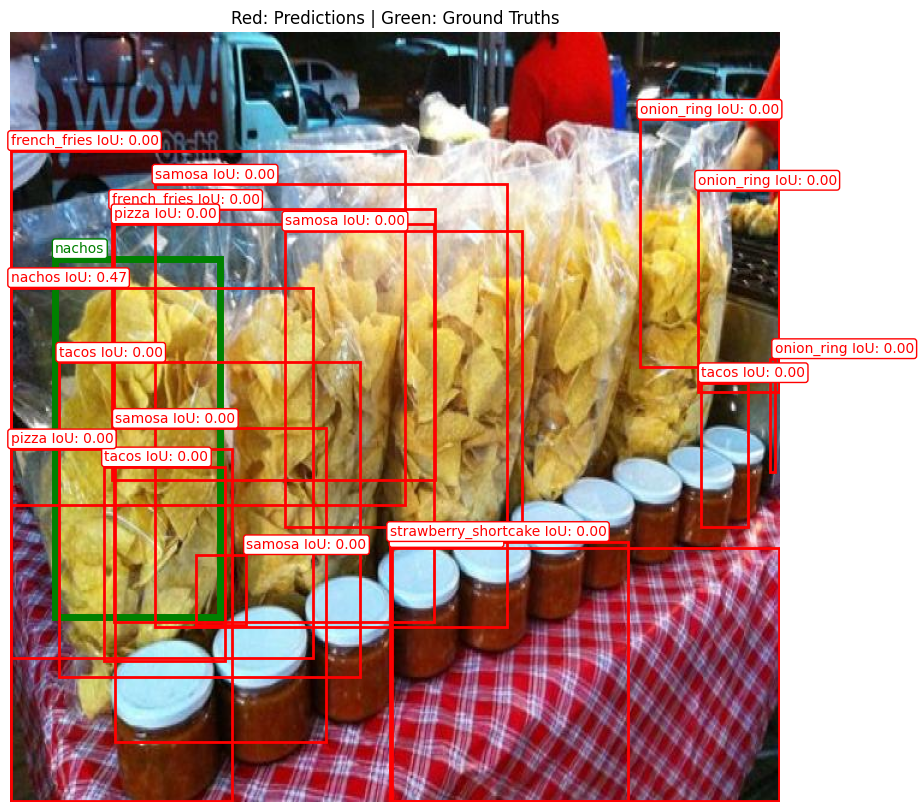

In [ ]:
# Save to disk
model.save_to_disk()
# Pick One image or instance from each class
df_one=test_df.drop_duplicates('class_name')
test_bb_box=load_annotations_and_convert_yolo_bb(df_one,base_path)

# Show only first instance
path=df_one.iloc[1]['image_name']
image_path=os.path.join(base_path,path)
prediction=model.predict(image_path=image_path)
gt_boxes=test_bb_box[image_path]
# Show with IOU threshold of 0.0
visualize_boxes_with_iou(image_path=image_path, predictions=prediction, ground_truths=gt_boxes,threshold=0.0)

 ### observations:
 SO many bounding box with 0.0 ,Lets limit the threshold of  IOU to 0.5

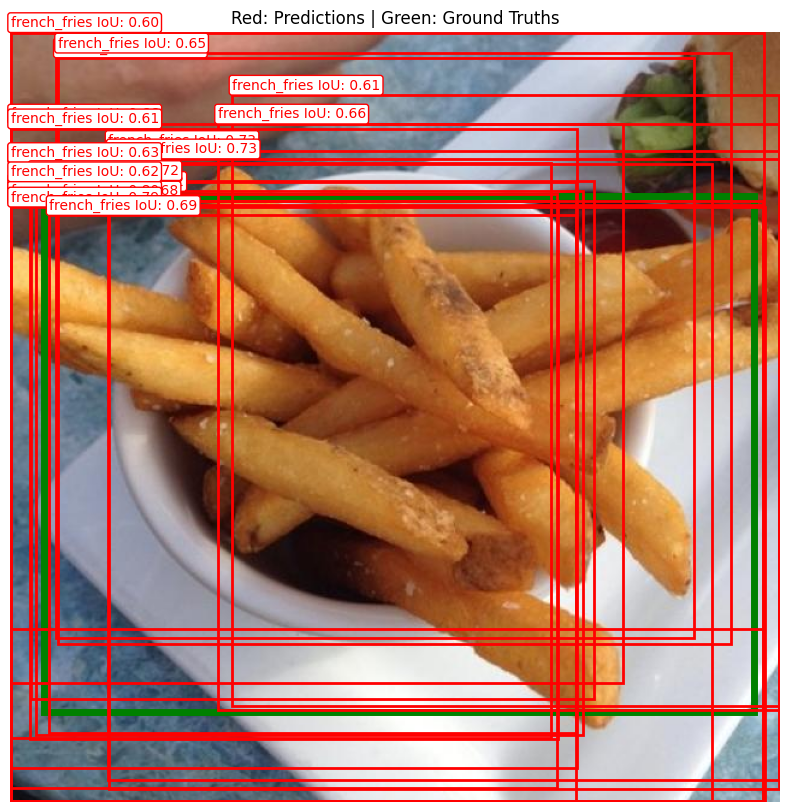

In [ ]:
# Show only one image but with IOU threshold of 0.6
df_one=test_df.drop_duplicates('class_name')
test_bb_box=load_annotations_and_convert_yolo_bb(df_one,base_path)
path=df_one.iloc[1]['image_name']
image_path=os.path.join(base_path,path)
prediction=model.predict(image_path=image_path)
gt_boxes=test_bb_box[image_path]
visualize_boxes_with_iou(image_path=image_path, predictions=prediction, ground_truths=gt_boxes,threshold=0.6)

#### Observations:
Now we can see all the boudning box are reduced and if we take only highest one then we will get the exact bouding box

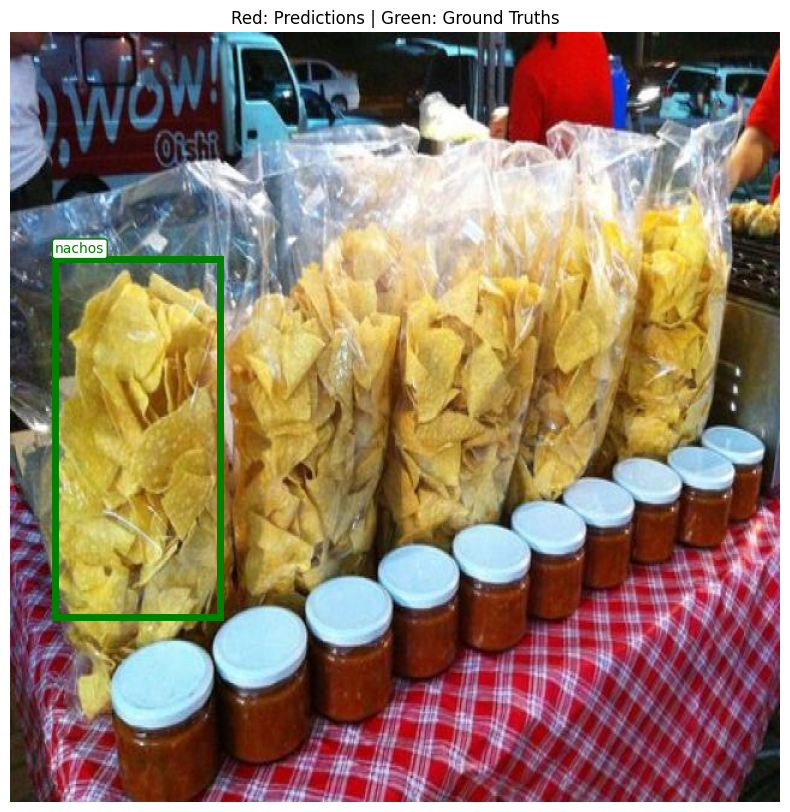

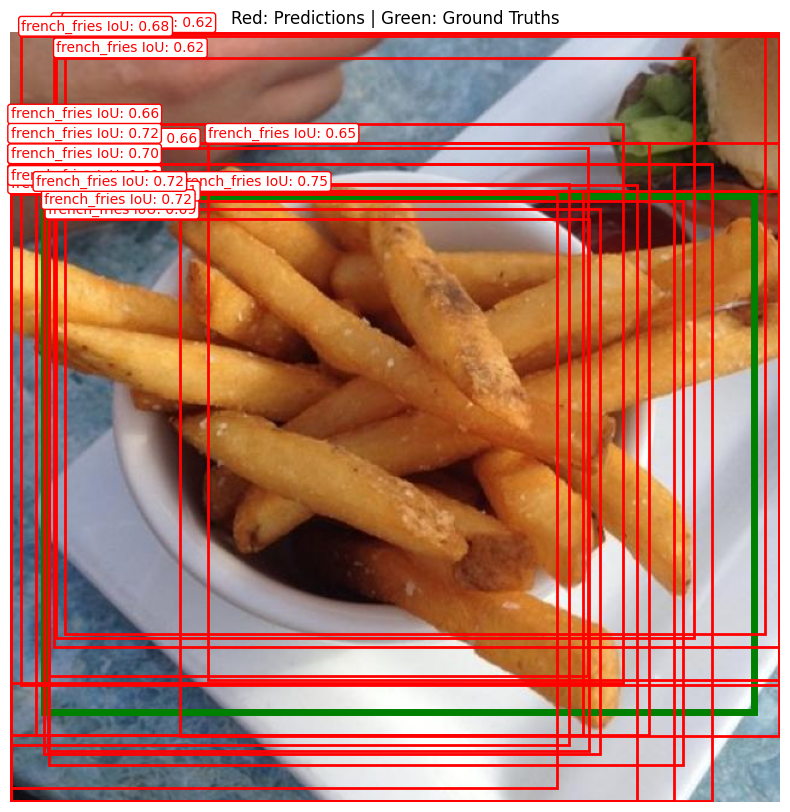

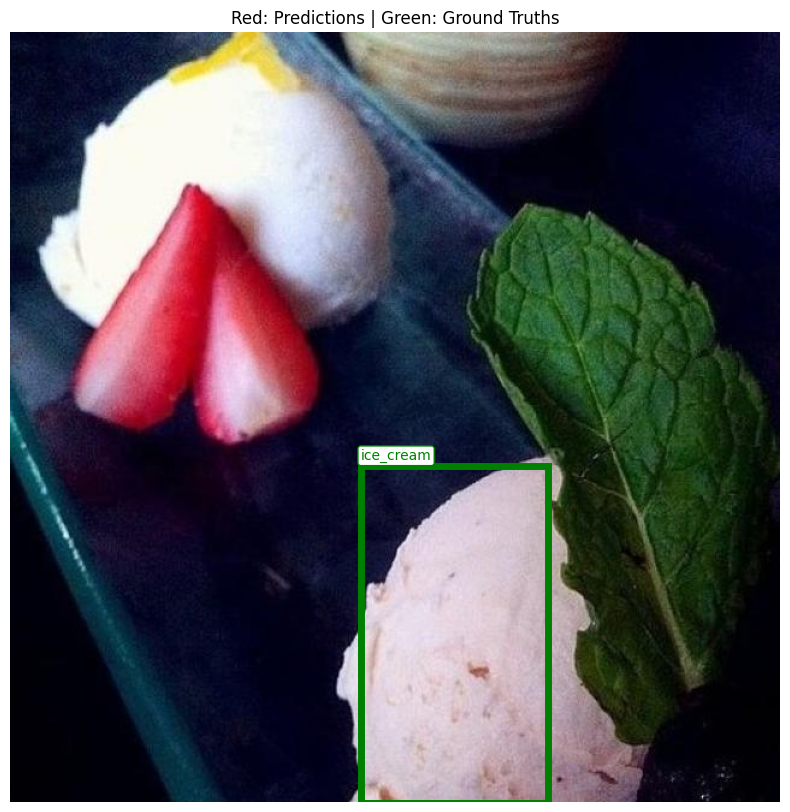

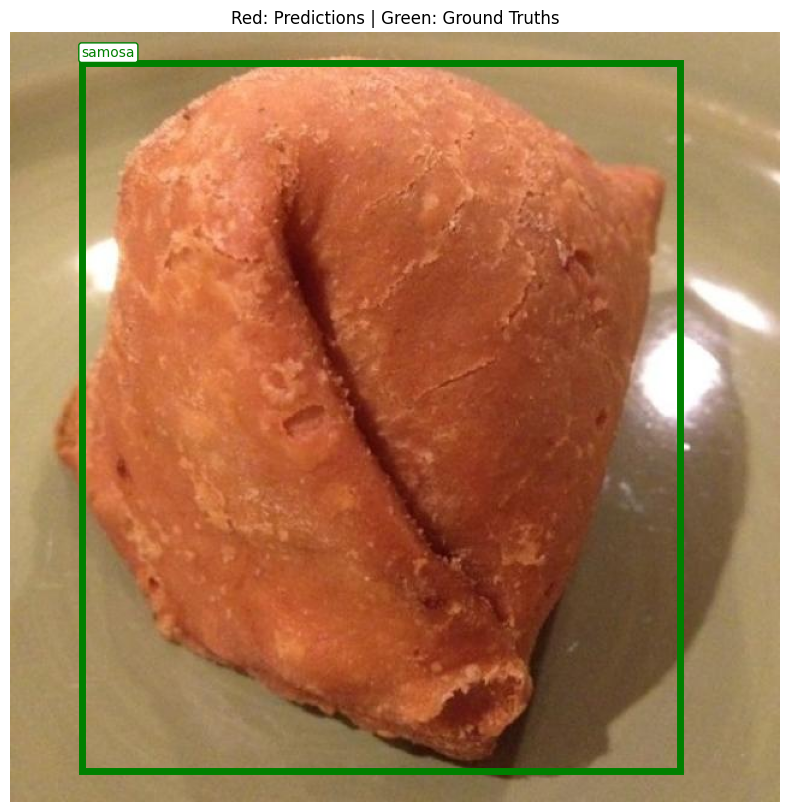

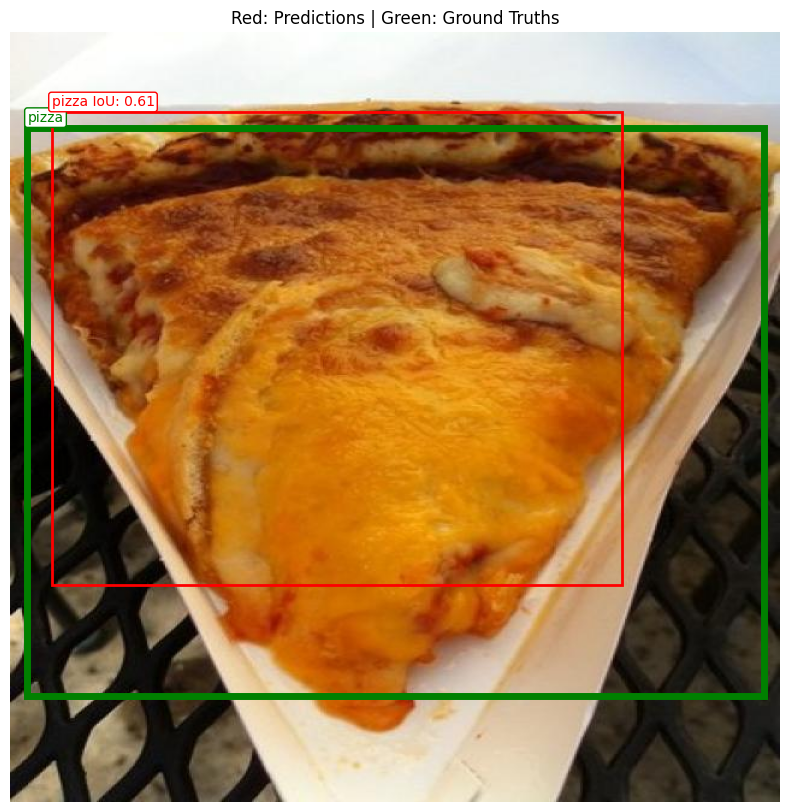

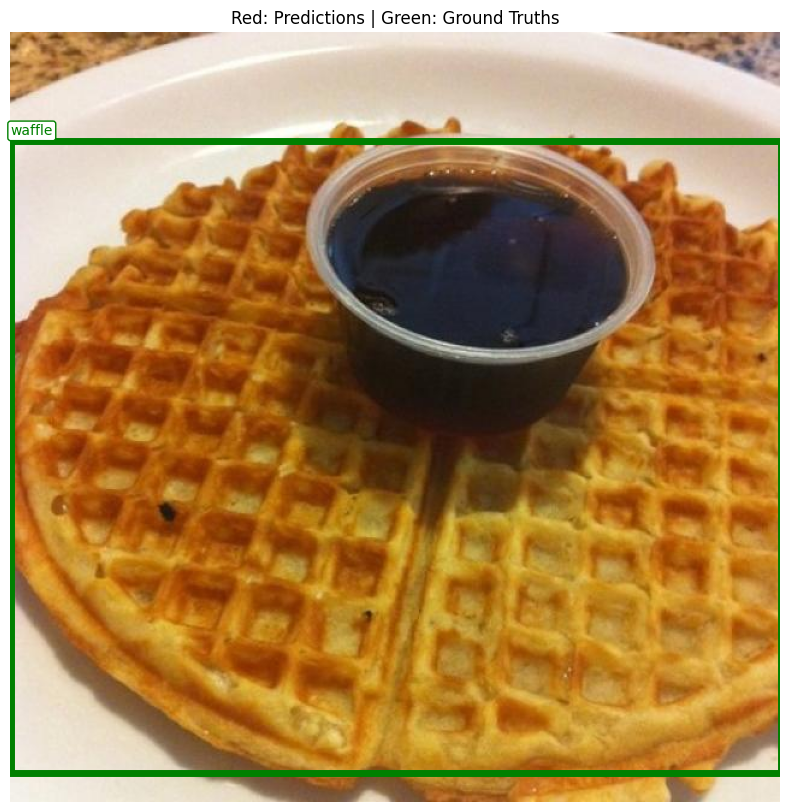

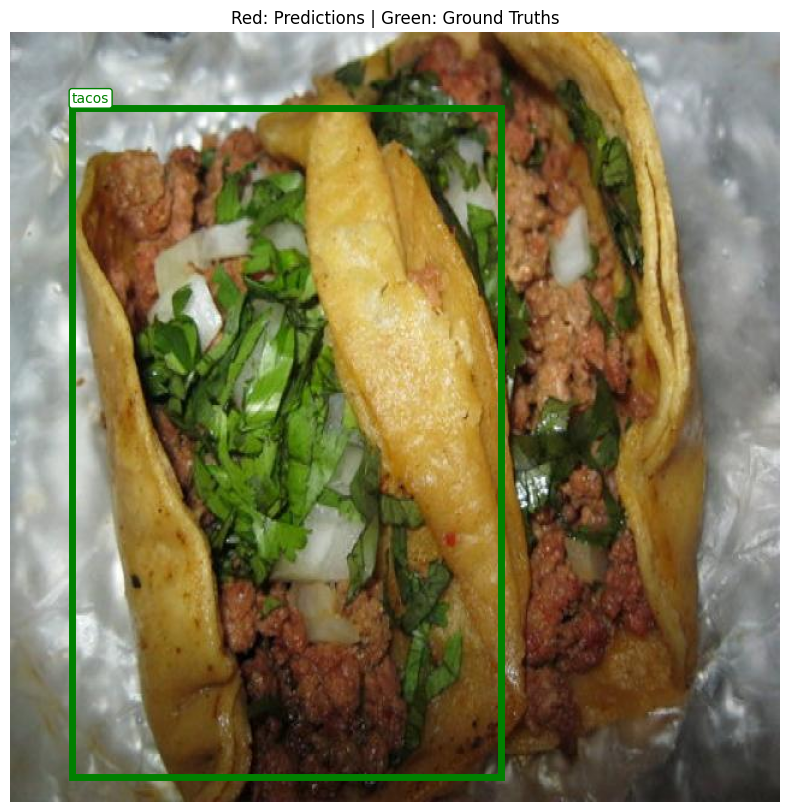

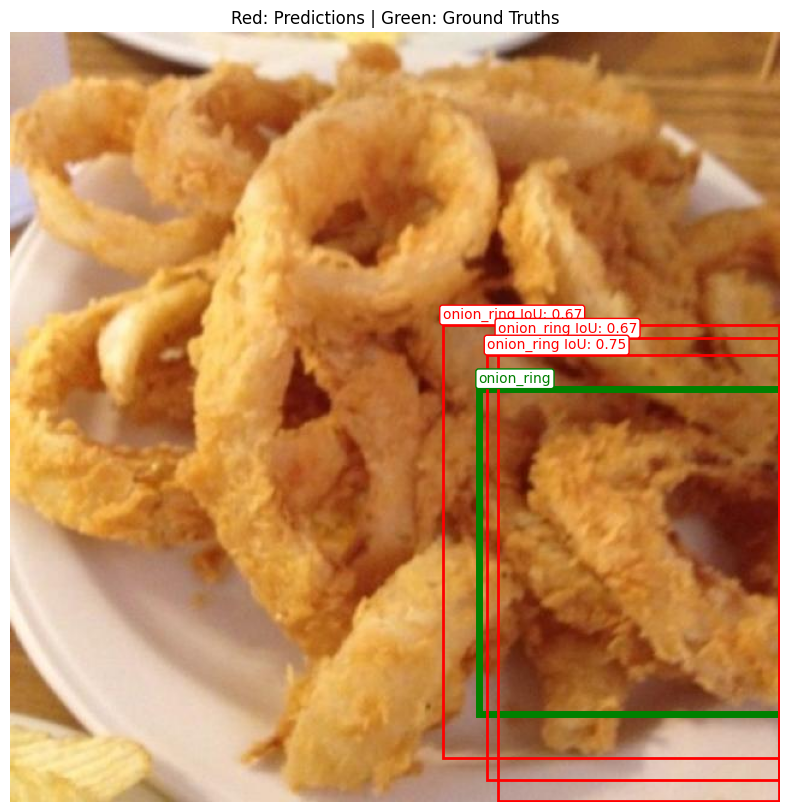

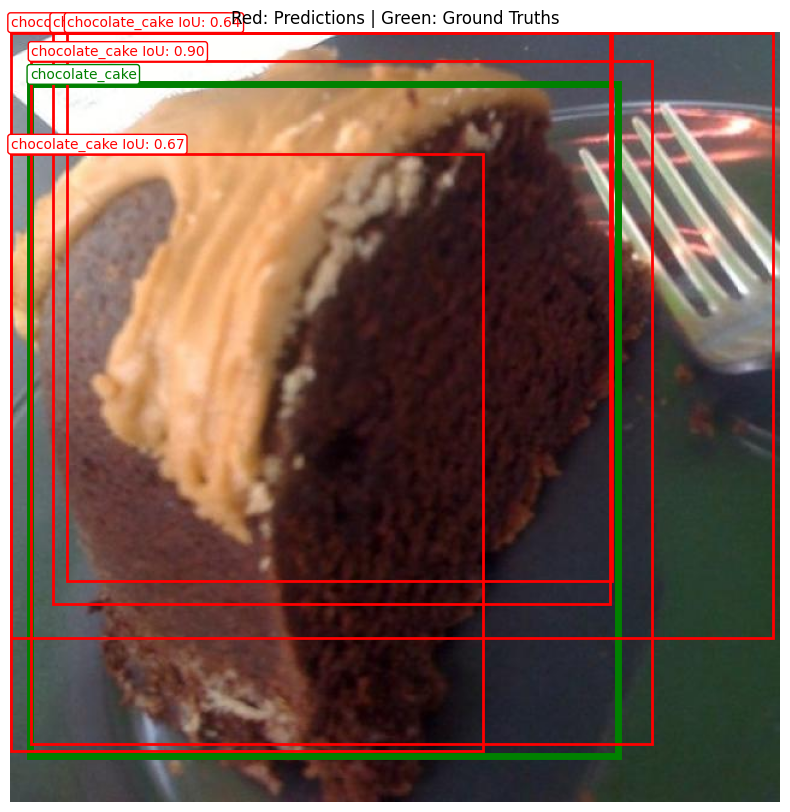

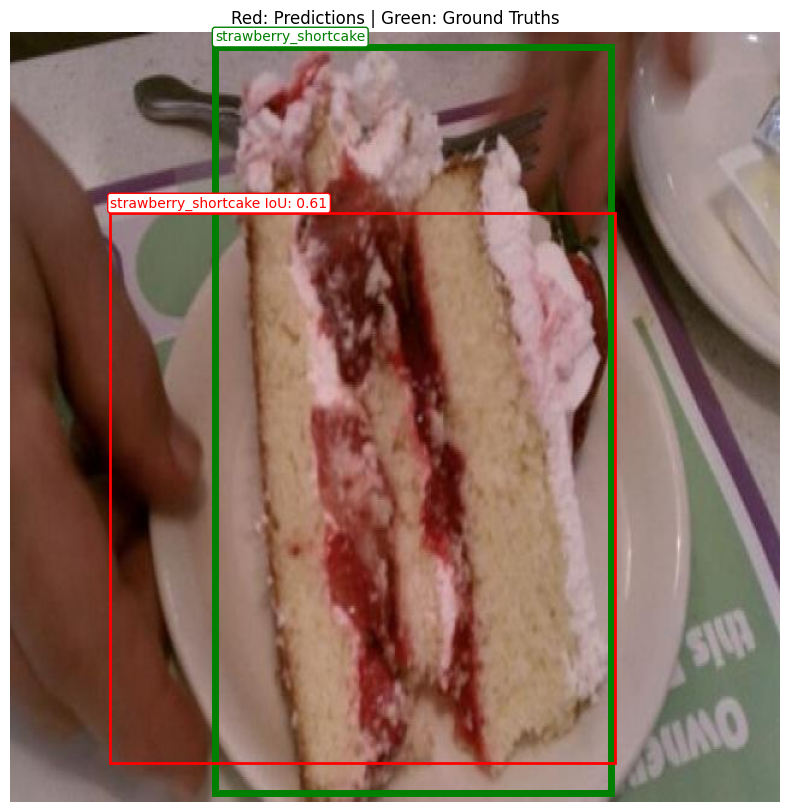

In [ ]:
# SHow One image from ecah class
for row in df_one.iterrows():
    image_path=os.path.join(base_path,row[1]['image_name'])
    prediction=model.predict(image_path=image_path)
    gt_boxes=test_bb_box[image_path]
    visualize_boxes_with_iou(image_path, prediction, gt_boxes,0.6)

In [ ]:
image_names_list = list(test_df['image_name'])  # Extract image names from the DataFrame
image_paths_list = [os.path.join(base_path, image_name) for image_name in image_names_list]  # Create full image paths

predictions_by_image = {}

for img_path in image_paths_list:
    img = cv2.imread(img_path)  # Read image using OpenCV
    if img is None:
        continue  # Skip if image is unreadable
    try:
        predictions_by_image[img_path] = model.predict(img_path)  # Run YOLO prediction
    except Exception as e:
        print(f"Error predicting for {img_path}: {e}")  # Handle prediction errors

ground_truth_by_image = test_bb_box  # Ground truth annotations

# Evaluate predictions using mean Average Precision (mAP)
mAP, ap_per_class = evaluate_map(predictions_by_image, ground_truth_by_image)

print(f"mAP: {mAP:.3f}")  # Print overall mAP
for cls, ap in ap_per_class.items():
    print(f"{cls}: {ap:.3f}")  # Print AP for each class


mAP: 0.553
tacos: 0.303
samosa: 0.227
french_fries: 0.909
strawberry_shortcake: 0.909
ice_cream: 0.000
onion_ring: 0.909
nachos: 0.000
pizza: 0.455
chocolate_cake: 0.909
waffle: 0.909



| Class                | Average Precision (AP) |
|---------------------|------------------------|
| tacos               | 0.303                  |
| samosa              | 0.227                  |
| french_fries        | 0.909                  |
| strawberry_shortcake| 0.909                  |
| ice_cream           | 0.000                  |
| onion_ring          | 0.909                  |
| nachos              | 0.000                  |
| pizza               | 0.455                  |
| chocolate_cake      | 0.909                  |
| waffle              | 0.909                  |

**mAP**: `0.553`

### Observations

- **High-performing classes** (AP ≥ 0.90): `french_fries`, `strawberry_shortcake`, `onion_ring`, `chocolate_cake`, and `waffle` are detected very well, likely due to strong visual distinction and good annotations.
- **Zero AP classes**: `ice_cream` and `nachos` scored 0.000 AP, suggesting issues like poor annotations, occlusion, or high intra-class variation.
- `pizza` shows moderate detection capability (0.455 AP), indicating potential for improvement.

### **Faster RCNN**

Faster R-CNN is an advanced object detection model that improves over R-CNN by replacing the slow selective search with a Region Proposal Network (RPN), which generates region proposals directly from the feature maps. This allows end-to-end training and significantly speeds up detection while maintaining high accuracy.











##### **Faster RCNN Helpers**

**Custom Dataset Summary**

- The `FasterRCNNDataset` class extends PyTorch's `Dataset` to work with Faster R-CNN.
- It loads images and their corresponding bounding boxes and class labels.
- Labels are encoded using `LabelEncoder`.
- If a transform (e.g., Albumentations) is provided, it applies augmentations to both images and bounding boxes.
- Returns a tuple: the image tensor and a dictionary containing `boxes` and `labels`.

In [ ]:
#Extend Dataset class to have own custom daatset
class FasterRCNNDataset(Dataset):
    def __init__(self, annotations, label_encoder, transform=None):
        self.image_paths = list(annotations.keys())
        self.annotations = annotations
        self.label_encoder = label_encoder
        self.transform = transform
    # dunder methods for overriding Dataset
    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = np.array(Image.open(image_path).convert("RGB"))

        annots = self.annotations[image_path]
        boxes = []
        labels = []

        for x1, y1, x2, y2, label in annots:
            boxes.append([x1, y1, x2, y2])
            labels.append(self.label_encoder.transform([label])[0])

        # Albumentations expects labels to be in list
        if self.transform:
            transformed = self.transform(image=image, bboxes=boxes, labels=labels)
            image = transformed['image']
            boxes = transformed['bboxes']
            labels = transformed['labels']
        else:
            image = F.to_tensor(image)

        target = {
            "boxes": torch.tensor(boxes, dtype=torch.float32),
            "labels": torch.tensor(labels, dtype=torch.int64)
        }

        return image, target

    def __len__(self):
        return len(self.image_paths)


**Faster R-CNN Model Setup and Training:**

In [ ]:
def get_model(num_classes):
    """
    Load a pre-trained Faster R-CNN model and adapt it for a custom number of classes.

    Args:
        num_classes: Total number of output classes including background (usually background is class 0).

    Returns:
        model: Modified Faster R-CNN model ready for training.
    """

    # Load a Faster R-CNN model pre-trained on COCO dataset
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

    # Extract the number of input features for the final classifier layer
    in_features = model.roi_heads.box_predictor.cls_score.in_features

    # Replace the classifier head with a new one suited for the target number of classes
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    return model


def train_faster_rcnn(model, train_loader, device, epochs=5):
    """
    Train a Faster R-CNN model using a given DataLoader.

    Args:
        model: A Faster R-CNN model created using get_model().
        train_loader: DataLoader providing batches of images and annotations.
        device: Device to use ('cuda' or 'cpu').
        epochs: Number of training epochs.

    Returns:
        None (trains the model in-place and prints loss after each epoch).
    """

    # Move the model to the selected device (GPU/CPU)
    model.to(device)
    model.train()

    # Use AdamW optimizer which includes weight decay (helps regularize training)
    optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4)

    # Loop through each training epoch
    for epoch in range(epochs):
        epoch_loss = 0.0

        # Loop through each batch from the training DataLoader
        for imgs, targets in train_loader:
            # Move both images and their corresponding targets to the device
            imgs = [img.to(device) for img in imgs]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            # Forward pass through the model to compute individual loss components
            loss_dict = model(imgs, targets)

            # Total loss is the sum of all individual losses (e.g., classification, bbox regression)
            losses = sum(loss for loss in loss_dict.values())

            # Zero out previous gradients before backprop
            optimizer.zero_grad()

            # Backward pass to compute gradients
            losses.backward()

            # Update model weights
            optimizer.step()

            # Accumulate loss for monitoring
            epoch_loss += losses.item()

        # Print average loss for the epoch
        avg_loss = epoch_loss / len(train_loader)
        print(f"Epoch {epoch+1}: Avg Loss = {avg_loss:.4f}")


**Faster R-CNN Prediction:**

In [ ]:
def get_predictions_faster_rcnn(model, dataset, label_encoder, device, confidence_threshold=0.5):
    """
    Run inference on a dataset using a trained Faster R-CNN model.
    
    Args:
        model: Trained Faster R-CNN model.
        dataset: A custom dataset where each item returns (image_tensor, target_dict).
        label_encoder: A fitted LabelEncoder used to decode label indices into class names.
        device: The device to run inference on ('cuda' or 'cpu').
        confidence_threshold: Minimum confidence score to keep a prediction.

    Returns:
        image_data_list: A list of dictionaries, each containing:
                         - image_path
                         - predictions: list of predicted bboxes with class labels and scores
                         - ground_truths: list of ground truth bboxes with class labels
    """

    # Create a mapping from class index to class name
    label_mapper = dict(zip(
        label_encoder.transform(label_encoder.classes_),  # [0, 1, 2, ...]
        label_encoder.classes_                            # ['cat', 'dog', ...]
    ))

    image_data_list = []

    # Iterate over all samples in the dataset
    for i in range(len(dataset)):
        image_path = dataset.image_paths[i]
        image, target = dataset[i]

        if image is None:
            continue  # Skip if image could not be loaded

        with torch.no_grad():
            # Run inference for a single image
            prediction = model([image.to(device)])[0]

        # Extract boxes, labels, and confidence scores from prediction
        boxes = prediction['boxes'].cpu().numpy()
        labels = prediction['labels'].cpu().numpy()
        scores = prediction['scores'].cpu().numpy()

        # Filter predictions based on confidence threshold
        filtered_preds = [
            {
                "bbox": bbox,
                "label": label_mapper[label],
                "score": score
            }
            for bbox, label, score in zip(boxes, labels, scores)
            if score >= confidence_threshold
        ]

        # Ground truth: convert bounding boxes and label indices to readable format
        gt_boxes = target["boxes"].cpu().numpy()
        gt_labels = target["labels"].cpu().numpy()
        gt = [
            list(gt_box) + [label_mapper[label]]
            for gt_box, label in zip(gt_boxes, gt_labels)
        ]

        # Store all information for this image
        image_data_list.append({
            "image_path": image_path,
            "predictions": filtered_preds,
            "ground_truths": gt
        })

    return image_data_list




---



**Faster R-CNN Training:**

In [ ]:
# Encode class labels
label_encoder = LabelEncoder()
label_encoder.fit(train_df['class_name'].astype(str))

# Convert YOLO to pixel boxes
annotations = load_annotations_and_convert_yolo_bb(train_df, base_path)

# Create Dataset and DataLoader
train_dataset = FasterRCNNDataset(annotations, label_encoder)

train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
# Model
num_classes = len(label_encoder.classes_) + 1  # include background
model = get_model(num_classes)
# Train
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
train_faster_rcnn(model, train_loader, device, epochs=30)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1: Loss = 0.5244
Epoch 2: Loss = 0.0516
Epoch 3: Loss = 0.1357
Epoch 4: Loss = 0.6049
Epoch 5: Loss = 0.0910
Epoch 6: Loss = 0.1557
Epoch 7: Loss = 0.1110
Epoch 8: Loss = 0.1573
Epoch 9: Loss = 0.4337
Epoch 10: Loss = 0.4737
Epoch 11: Loss = 0.1409
Epoch 12: Loss = 0.2648
Epoch 13: Loss = 0.0319
Epoch 14: Loss = 0.2202
Epoch 15: Loss = 0.0744
Epoch 16: Loss = 0.1715
Epoch 17: Loss = 0.0622
Epoch 18: Loss = 0.0377
Epoch 19: Loss = 0.3208
Epoch 20: Loss = 0.0774
Epoch 21: Loss = 0.1495
Epoch 22: Loss = 0.2125
Epoch 23: Loss = 0.1563
Epoch 24: Loss = 0.0348
Epoch 25: Loss = 0.4096
Epoch 26: Loss = 0.1356
Epoch 27: Loss = 0.1623
Epoch 28: Loss = 0.0381
Epoch 29: Loss = 0.2366
Epoch 30: Loss = 0.0462


 - Loss at 30 epch was at 0.0462.We will see if this improves the performances
 -  Faster RCNN is faster then RCNN model compared to RCNN due to image being passed only once and faster RCNN has Region Proposal Network which is a CNN model and we are reusing features map which is generated by CNN.

#### **Show 3 images from each class**

**Faster R-CNN Inference:**

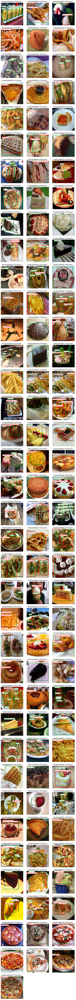

In [ ]:
# Filter the DataFrame
test_df_filtered = test_df[test_df['image_name'].apply(lambda x: cv2.imread(os.path.join(base_path, x)) is not None)].reset_index(drop=True)
test_annotations = load_annotations_and_convert_yolo_bb(test_df_filtered, base_path)
test_dataset = FasterRCNNDataset(test_annotations, label_encoder)
model.eval()
# get prediction
image_data_list=get_predictions_faster_rcnn(model, test_dataset, label_encoder, device)
visualize_multiple_images(image_data_list,threshold=0.5)


**Faster R-CNN Model: Detection Results Summary:**

Red Boxes: Model Predictions  
These represent the bounding boxes predicted by the Faster R-CNN model. Each box includes the predicted class label and its confidence score.

Green Boxes: Ground Truth Labels  
These are the actual annotated bounding boxes from the test dataset.

Visual Evaluation:  
- Many predictions have a strong overlap with the ground truths.
- Some cases show:
  - Missed detections (false negatives)
  - Incorrect predictions (false positives)
  - Misaligned bounding boxes with low Intersection over Union (IoU)

Commonly Detected Classes:  
- Pizza  
- Samosa  
- French fries  
- Onion rings


**Next, build dictionaries for predictions and ground truths:**

In [ ]:
# Build prediction and GT dicts
predictions_by_image = {}
ground_truth_by_image = {}

for item in image_data_list:
    image_path = item['image_path']
    predictions_by_image[image_path] = item['predictions']
    ground_truth_by_image[image_path] = item['ground_truths']

# Evaluate mAP
mAP, ap_per_class = evaluate_map(predictions_by_image, ground_truth_by_image, iou_threshold=0.5)

print(f"mAP: {mAP:.3f}")
for cls, ap in ap_per_class.items():
    print(f"{cls}: {ap:.3f}")


mAP: 0.405
tacos: 0.386
french_fries: 0.727
ice_cream: 0.145
onion_ring: 0.304
samosa: 0.422
nachos: 0.209
waffle: 0.364
strawberry_shortcake: 0.361
pizza: 0.727


### Observations:
### Model Evaluation Results (mAP@50)

| Class                 | mAP@50 |
|----------------------|--------|
| Overall              | 0.405  |
| tacos                | 0.386  |
| french_fries         | 0.727  |
| ice_cream            | 0.145  |
| onion_ring           | 0.304  |
| samosa               | 0.422  |
| nachos               | 0.209  |
| waffle               | 0.364  |
| strawberry_shortcake | 0.361  |
| pizza                | 0.727  |

---

### Observations

- The **overall mAP@50 is 0.405**, which indicates moderate detection performance.
- **french_fries** and **pizza** have the highest precision (`0.727`), showing strong detection capability.
- **ice_cream** and **nachos** perform poorly with scores below `0.21`, likely needing more data or clearer annotations.
- **strawberry_shortcake** and **waffle** perform moderately and may benefit from better augmentation or fine-tuning.
- A wide variance in class-wise performance suggests possible **class imbalance** or **varying annotation quality**.

Faster RCNN does not have any class where it has 0 mAP but the overall mAP is reduced due to less score in other class unlike RCNN



#### **Faster RCNN Training With Augmenation**

In [ ]:
# Encode class labels into numerical format
label_encoder = LabelEncoder()
label_encoder.fit(train_df['class_name'].astype(str))

# Convert YOLO bounding boxes to pixel coordinates (Pascal VOC format)
annotations = load_annotations_and_convert_yolo_bb(train_df, base_path)

# Define image augmentation and preprocessing using Albumentations
transform = A.Compose([
    A.HorizontalFlip(p=0.5),                       # Random horizontal flip
    A.RandomBrightnessContrast(p=0.2),             # Random brightness and contrast
    A.ColorJitter(p=0.3),                          # Jitter in color
    A.Rotate(limit=15, p=0.4),                     # Random rotation
    A.MotionBlur(p=0.2),                           # Random motion blur
    A.RandomSizedBBoxSafeCrop(height=320, width=320, p=0.5),  # Safe crop preserving bboxes
    A.Normalize(mean=(0.485, 0.456, 0.406),        # Normalize using ImageNet mean and std
                std=(0.229, 0.224, 0.225)),
    ToTensorV2()                                   # Convert image and bbox to PyTorch tensor
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels']))  # Define bbox format

# Create custom dataset with transformations and annotation mapping
train_dataset = FasterRCNNDataset(annotations, label_encoder, transform=transform)

# Wrap dataset with DataLoader for mini-batch training
# collate_fn ensures batching works with variable-size targets
train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))

# Calculate total number of classes (include background class)
num_classes = len(label_encoder.classes_) + 1

# Get pre-trained Faster R-CNN model adapted for your dataset
model_fast_rcnn_aug = get_model(num_classes)

# Determine training device (GPU if available)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Train the model for 30 epochs
train_faster_rcnn(model_fast_rcnn_aug, train_loader, device, epochs=30)


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1: Loss = 0.3016
Epoch 2: Loss = 0.0803
Epoch 3: Loss = 0.1975
Epoch 4: Loss = 0.1309
Epoch 5: Loss = 0.0656
Epoch 6: Loss = 0.2694
Epoch 7: Loss = 0.6220
Epoch 8: Loss = 0.1050
Epoch 9: Loss = 0.3849
Epoch 10: Loss = 0.1904
Epoch 11: Loss = 0.0153
Epoch 12: Loss = 0.0849
Epoch 13: Loss = 0.0665
Epoch 14: Loss = 0.4386
Epoch 15: Loss = 0.1705
Epoch 16: Loss = 0.2033
Epoch 17: Loss = 0.0444
Epoch 18: Loss = 0.0784
Epoch 19: Loss = 0.1227
Epoch 20: Loss = 0.3914
Epoch 21: Loss = 0.3483
Epoch 22: Loss = 0.0683
Epoch 23: Loss = 0.1475
Epoch 24: Loss = 0.0828
Epoch 25: Loss = 0.1717
Epoch 26: Loss = 0.5924
Epoch 27: Loss = 0.0406
Epoch 28: Loss = 0.1309
Epoch 29: Loss = 0.4870
Epoch 30: Loss = 0.1401


### **Observations:**
The loss is higher than faster RCNN without augmenations

### **YOLO (You Look Only Once)**



Note:Although YOLO is pre-trained on the COCO dataset, it hasn't been exposed to the full range of classes in the Food-101 dataset. Therefore, we need to fine-tune it on our dataset to improve its performance on food-specific categories.

#### **Prepare Dataset For Yolo**

#### Yolo Helpers

In [ ]:
def create_yolo_dataset(df, image_col='image_name', label_col='class_id',
                        split_ratio=0.2, base_dir='datasets', image_name_col='image'):
    # Split the DataFrame into training and testing sets based on unique images and first class (stratified)
    train_df, test_df = split_df_by_image_with_first_class(df, test_size=split_ratio)

    # Define directory structure for YOLO format
    folders = {
        'train_images': os.path.join(base_dir, 'images', 'train'),
        'train_labels': os.path.join(base_dir, 'labels', 'train'),
        'val_images': os.path.join(base_dir, 'images', 'val'),
        'val_labels': os.path.join(base_dir, 'labels', 'val')
    }

    # Create necessary folders if they don't exist
    for f in folders.values():
        os.makedirs(f, exist_ok=True)

    def save_split(split_df, img_folder, label_folder):
        # Group annotations by image
        grouped = split_df.groupby(image_name_col)
        for image_name, group in tqdm(grouped, desc=f"Processing {img_folder}"):
            # Source image path (original path from DataFrame)
            image_path = group[image_col].iloc[0]
            
            # Target path in new dataset structure
            target_img_path = os.path.join(img_folder, image_name)
            shutil.copy(image_path, target_img_path)  # Copy image to destination

            # Create corresponding YOLO label file (.txt)
            label_txt_path = os.path.join(label_folder, image_name.replace('.jpg', '.txt').replace('.png', '.txt'))
            with open(label_txt_path, 'w') as f:
                for _, row in group.iterrows():
                    # YOLO format: <class_id> <x_center> <y_center> <width> <height>
                    class_id = int(row[label_col])
                    x, y, w, h = row['x_center'], row['y_center'], row['width'], row['height']
                    f.write(f"{class_id} {x} {y} {w} {h}\n")

    # Save training and validation splits in YOLO format
    save_split(train_df, folders['train_images'], folders['train_labels'])
    save_split(test_df, folders['val_images'], folders['val_labels'])

    # Inform the user
    print(f"\nYOLO-ready dataset created at `{base_dir}`")

    # Return path to root dataset directory
    return base_dir


In [ ]:
import yaml

def generate_yolo_config_yaml(base_dir, class_mapping, output_file='data.yaml'):
    '''
    Generate a YOLOv8-compatible configuration YAML file.

    Args:
        base_dir (str): Root directory containing 'images/train' and 'images/val' folders.
        class_mapping (dict): Dictionary mapping class names to numeric IDs. 
                              Example: {'dog': 0, 'cat': 1}
        output_file (str): Path to save the generated YAML config file.

    Creates:
        A YAML file with train/val image paths, number of classes, and class names.
    '''

    # Define base structure of the config file
    data_yaml = {
        'train': os.path.join(base_dir, 'images', 'train'),  # Training image folder path
        'val': os.path.join(base_dir, 'images', 'val'),      # Validation image folder path
        'nc': len(class_mapping),                            # Number of classes
        'names': [None] * len(class_mapping)                 # Placeholder for class names in index order
    }

    # Populate class names in correct index positions
    for name, idx in class_mapping.items():
        data_yaml['names'][idx] = name

    # Write the YAML data to a file
    with open(output_file, 'w') as f:
        yaml.dump(data_yaml, f)

    # Notify the user
    print(f"YOLOv8 config saved to `{output_file}`")




---



In [ ]:
# define classname to map
class_name={'chocolate_cake': 0, 'french_fries': 1, 'ice_cream': 2, 'nachos': 3, 'onion_ring': 4, 'pizza': 5, 'samosa': 6, 'strawberry_shortcake': 7, 'tacos': 8, 'waffle': 9}
# copy and then map to the previosu defined mapping
annot_copy_df=annotation_df.copy(deep=True)
annot_copy_df['image_name']=annot_copy_df['image_name'].apply(lambda x:os.path.join(base_path,x))
annot_copy_df['class_id']=annot_copy_df['class_name'].map(class_name)
# create yolo dataset to train and validation
create_yolo_dataset(annot_copy_df)

Processing datasets/images/val: 100%|██████████| 112/112 [00:00<00:00, 1910.83it/s]


YOLO-ready dataset created at `datasets`


'datasets'

In [ ]:
# generate config yaml file for yolo
generate_yolo_config_yaml('datasets', class_name)

YOLOv8 config saved to `data.yaml`


In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolov8n.pt")

# Train the model
model.train(data="data.yaml", epochs=50, imgsz=640)

# Evaluate on validation set
metrics = model.val()


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 6.25M/6.25M [00:00<00:00, 118MB/s]


Ultralytics 8.3.155 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, profile=Fals

100%|██████████| 755k/755k [00:00<00:00, 27.5MB/s]

Overriding model.yaml nc=80 with nc=10

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

Model summary: 129 layers, 3,012,798 parameters, 3,012,782 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 88.7MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1485.0±673.3 MB/s, size: 42.2 KB)


train: Scanning /content/datasets/labels/train... 447 images, 0 backgrounds, 0 corrupt: 100%|██████████| 447/447 [00:00<00:00, 2508.37it/s]

train: New cache created: /content/datasets/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1020.4±526.2 MB/s, size: 56.3 KB)


val: Scanning /content/datasets/labels/val... 112 images, 0 backgrounds, 0 corrupt: 100%|██████████| 112/112 [00:00<00:00, 765.58it/s]

val: New cache created: /content/datasets/labels/val.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.12G      1.455      3.802       1.78         81        640: 100%|██████████| 28/28 [00:15<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:06<00:00,  1.53s/it]

                   all        112        220    0.00685       0.86      0.105     0.0551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50       2.6G       1.37      3.317      1.767         74        640: 100%|██████████| 28/28 [00:10<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.01it/s]

                   all        112        220    0.00939      0.848      0.129     0.0592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.62G      1.423       3.01      1.795         70        640: 100%|██████████| 28/28 [00:11<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.15it/s]

                   all        112        220      0.235      0.237      0.173     0.0714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.63G      1.392      2.808       1.81         54        640: 100%|██████████| 28/28 [00:06<00:00,  4.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.99it/s]

                   all        112        220      0.452      0.221      0.231       0.11



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.65G      1.389      2.642      1.765         80        640: 100%|██████████| 28/28 [00:07<00:00,  3.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.63it/s]

                   all        112        220      0.317      0.357      0.292      0.132



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.67G      1.421      2.531      1.783         64        640: 100%|██████████| 28/28 [00:07<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.31it/s]

                   all        112        220      0.322      0.426      0.298      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.69G      1.415      2.397      1.767         57        640: 100%|██████████| 28/28 [00:06<00:00,  4.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.35it/s]

                   all        112        220      0.309      0.432      0.338      0.157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.71G      1.403      2.414      1.736         61        640: 100%|██████████| 28/28 [00:07<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.67it/s]

                   all        112        220      0.291      0.294      0.254      0.118



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.72G      1.371      2.311      1.717         83        640: 100%|██████████| 28/28 [00:07<00:00,  3.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]

                   all        112        220      0.271      0.341       0.27      0.129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.74G      1.411      2.296      1.753         65        640: 100%|██████████| 28/28 [00:06<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.52it/s]

                   all        112        220      0.425      0.419      0.406      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.75G      1.379      2.207      1.716         51        640: 100%|██████████| 28/28 [00:08<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.82it/s]

                   all        112        220       0.41      0.432      0.368      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.77G      1.349      2.169      1.696         59        640: 100%|██████████| 28/28 [00:06<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.12it/s]

                   all        112        220      0.392      0.363      0.339      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.79G      1.328       2.11      1.674         82        640: 100%|██████████| 28/28 [00:07<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.28it/s]

                   all        112        220      0.478      0.415      0.423      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50       2.8G      1.323      2.041      1.695         70        640: 100%|██████████| 28/28 [00:07<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.17it/s]

                   all        112        220      0.615      0.392      0.431      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.82G      1.315      1.985      1.658         70        640: 100%|██████████| 28/28 [00:08<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.34it/s]

                   all        112        220      0.514      0.382      0.396      0.196



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.84G      1.282      1.934      1.624         84        640: 100%|██████████| 28/28 [00:10<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.41it/s]

                   all        112        220      0.428      0.473       0.45      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.86G      1.336       1.95      1.652         62        640: 100%|██████████| 28/28 [00:10<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.18it/s]

                   all        112        220      0.445      0.486      0.457      0.247



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.87G      1.267      1.935      1.633         80        640: 100%|██████████| 28/28 [00:08<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.68it/s]

                   all        112        220       0.59      0.326      0.381      0.208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.89G      1.272      1.787      1.629         38        640: 100%|██████████| 28/28 [00:07<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.58it/s]

                   all        112        220      0.588      0.401       0.46      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.91G      1.266      1.798      1.611         60        640: 100%|██████████| 28/28 [00:07<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        112        220      0.494      0.463       0.46      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.93G      1.253      1.767      1.595         76        640: 100%|██████████| 28/28 [00:06<00:00,  4.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.84it/s]

                   all        112        220      0.789      0.425      0.539      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.94G      1.226      1.756       1.57         66        640: 100%|██████████| 28/28 [00:08<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.68it/s]

                   all        112        220      0.516      0.498       0.47      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.96G      1.219      1.751       1.59         59        640: 100%|██████████| 28/28 [00:06<00:00,  4.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        112        220      0.555      0.413      0.493       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.98G      1.197      1.726      1.571         52        640: 100%|██████████| 28/28 [00:06<00:00,  4.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.37it/s]

                   all        112        220      0.543      0.441      0.479      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.99G      1.209      1.647      1.554         75        640: 100%|██████████| 28/28 [00:08<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.47it/s]

                   all        112        220      0.503      0.491      0.501      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      3.01G      1.186      1.595      1.535         73        640: 100%|██████████| 28/28 [00:07<00:00,  3.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.59it/s]

                   all        112        220      0.481      0.482      0.483      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      3.03G      1.207      1.538      1.535         65        640: 100%|██████████| 28/28 [00:07<00:00,  3.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.32it/s]

                   all        112        220      0.663      0.459       0.48       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      3.04G      1.162      1.577      1.522         72        640: 100%|██████████| 28/28 [00:08<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.50it/s]

                   all        112        220      0.489      0.519      0.539      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      3.06G      1.153      1.571      1.527         44        640: 100%|██████████| 28/28 [00:08<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.62it/s]

                   all        112        220      0.653      0.508      0.546      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      3.08G       1.11      1.435      1.485         65        640: 100%|██████████| 28/28 [00:07<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.70it/s]

                   all        112        220      0.561      0.547      0.541      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50       3.1G      1.138      1.492      1.507         79        640: 100%|██████████| 28/28 [00:09<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.48it/s]

                   all        112        220      0.666      0.454      0.559      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      3.11G      1.129      1.435      1.497         48        640: 100%|██████████| 28/28 [00:06<00:00,  4.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.53it/s]

                   all        112        220      0.665      0.548      0.607      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      3.13G      1.115      1.405      1.494         72        640: 100%|██████████| 28/28 [00:07<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.74it/s]

                   all        112        220      0.606      0.535      0.569      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      3.15G      1.124      1.397      1.475         59        640: 100%|██████████| 28/28 [00:07<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.77it/s]

                   all        112        220      0.544      0.566      0.553      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      3.17G      1.101      1.403      1.495         64        640: 100%|██████████| 28/28 [00:06<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.70it/s]

                   all        112        220      0.599      0.532      0.569      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      3.18G      1.095       1.37      1.472         79        640: 100%|██████████| 28/28 [00:08<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.34it/s]

                   all        112        220       0.55      0.566      0.573      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50       3.2G      1.092      1.357      1.465         61        640: 100%|██████████| 28/28 [00:06<00:00,  4.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.16it/s]

                   all        112        220      0.575       0.55      0.585      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      3.22G      1.088      1.347      1.463         69        640: 100%|██████████| 28/28 [00:07<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.44it/s]

                   all        112        220      0.539      0.572      0.575      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      3.23G      1.082        1.3      1.449         82        640: 100%|██████████| 28/28 [00:07<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.48it/s]

                   all        112        220      0.645      0.532      0.577      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      3.25G      1.053      1.261      1.442         68        640: 100%|██████████| 28/28 [00:07<00:00,  3.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        112        220      0.622      0.529      0.573      0.323


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      3.27G      1.048      1.429      1.524         23        640: 100%|██████████| 28/28 [00:08<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.43it/s]

                   all        112        220      0.526      0.542      0.538       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      3.29G      1.001      1.397      1.517         25        640: 100%|██████████| 28/28 [00:07<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.59it/s]

                   all        112        220      0.631      0.525      0.551      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50       3.3G     0.9965      1.348      1.509         34        640: 100%|██████████| 28/28 [00:06<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.54it/s]


                   all        112        220      0.641       0.51      0.587       0.33

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      3.32G     0.9401      1.218      1.457         19        640: 100%|██████████| 28/28 [00:07<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.78it/s]

                   all        112        220      0.613      0.547      0.604      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      3.34G     0.9242      1.207      1.436         34        640: 100%|██████████| 28/28 [00:06<00:00,  4.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.02it/s]

                   all        112        220      0.675      0.539      0.614       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      3.35G     0.9096      1.162       1.41         31        640: 100%|██████████| 28/28 [00:06<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.53it/s]

                   all        112        220      0.605      0.577      0.614      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      3.37G     0.9115      1.159      1.412         24        640: 100%|██████████| 28/28 [00:07<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.52it/s]

                   all        112        220      0.595      0.575      0.608      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      3.39G     0.8484      1.121      1.376         25        640: 100%|██████████| 28/28 [00:06<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.64it/s]

                   all        112        220      0.607      0.585      0.599      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50       3.4G     0.8688      1.111      1.393         29        640: 100%|██████████| 28/28 [00:07<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.55it/s]

                   all        112        220      0.612      0.561      0.605      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      3.42G     0.8677      1.099      1.375         23        640: 100%|██████████| 28/28 [00:08<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        112        220      0.655      0.552      0.613      0.348



50 epochs completed in 0.135 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.155 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,007,598 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.79it/s]


                   all        112        220      0.596      0.575      0.608      0.349
        chocolate_cake         10         10      0.512      0.736      0.807      0.546
          french_fries         16         16       0.74      0.938      0.967      0.588
             ice_cream         11         27      0.656      0.148      0.269      0.118
                nachos         11         31      0.646      0.323      0.317      0.145
            onion_ring         10         33      0.513      0.515      0.554      0.296
                 pizza         12         15      0.787      0.667      0.835      0.589
                samosa         14         39      0.644      0.846      0.838      0.424
  strawberry_shortcake         10         15      0.398      0.333        0.3      0.102
                 tacos         10         24      0.653      0.542      0.637      0.328
                waffle          9         10      0.414        0.7      0.553       0.35
Speed: 0.5ms preproce

val: Scanning /content/datasets/labels/val.cache... 112 images, 0 backgrounds, 0 corrupt: 100%|██████████| 112/112 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.80it/s]


                   all        112        220      0.595      0.575      0.608      0.348
        chocolate_cake         10         10      0.512      0.737      0.807      0.541
          french_fries         16         16      0.738      0.938      0.967      0.587
             ice_cream         11         27      0.643      0.148       0.27      0.116
                nachos         11         31      0.649      0.323      0.316      0.145
            onion_ring         10         33      0.511      0.515      0.556      0.298
                 pizza         12         15      0.787      0.667      0.835      0.589
                samosa         14         39      0.646      0.846      0.838      0.423
  strawberry_shortcake         10         15      0.397      0.333        0.3      0.102
                 tacos         10         24      0.652      0.542      0.637      0.328
                waffle          9         10      0.415        0.7      0.553      0.352
Speed: 0.4ms preproce

### **mAP@0.5 Results Per Class**

| Class Name              | mAP@0.5 |
|-------------------------|---------|
| chocolate_cake          | 0.807   |
| french_fries            | 0.967   |
| ice_cream               | 0.270   |
| nachos                  | 0.316   |
| onion_ring              | 0.556   |
| pizza                   | 0.835   |
| samosa                  | 0.838   |
| strawberry_shortcake    | 0.300   |
| tacos                   | 0.637   |
| waffle                  | 0.553   |
| **Overall (all)**       | **0.608** |

**Best Performing Classes:**

French Fries (0.967) and Pizza (0.835) achieved the highest mAP scores, indicating strong detection and localization.

Samosa (0.838) also performed well, showing consistent feature representation.

**Underperforming Classes:**

Ice Cream (0.270), Strawberry Shortcake (0.300), and Nachos (0.316) had notably low mAP scores.

Possible reasons: high intra-class variation, occlusion, or limited training samples.

**Balanced but Moderate Scores:**

Classes like Waffle (0.553) and Onion Ring (0.556) had moderate scores, suggesting the model performs reasonably well but could benefit from more training data or improved augmentations.

**Overall Performance:**

The model achieves a solid overall mAP@0.5 of 0.608, which indicates reasonably good object detection performance across multiple classes, but there's still room to improve underrepresented or visually complex categories.

### **Yolo with Augmenation**

In [ ]:

# Load a model
model_aug = YOLO("yolov8n.pt")

# Train the model
model_aug.train(data="data.yaml", epochs=50, imgsz=640,augment=True )

# Evaluate on validation set
metrics = model_aug.val()

Ultralytics 8.3.155 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train3, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, profile=Fals

train: Scanning /content/datasets/labels/train.cache... 447 images, 0 backgrounds, 0 corrupt: 100%|██████████| 447/447 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 287.2±161.2 MB/s, size: 56.3 KB)


val: Scanning /content/datasets/labels/val.cache... 112 images, 0 backgrounds, 0 corrupt: 100%|██████████| 112/112 [00:00<?, ?it/s]


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train3
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.21G      1.455      3.802       1.78         81        640: 100%|██████████| 28/28 [00:09<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.13it/s]

                   all        112        220    0.00685       0.86      0.105     0.0551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.37G       1.37      3.317      1.767         74        640: 100%|██████████| 28/28 [00:07<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.95it/s]

                   all        112        220    0.00939      0.848      0.129     0.0592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.37G      1.423       3.01      1.795         70        640: 100%|██████████| 28/28 [00:06<00:00,  4.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.55it/s]

                   all        112        220      0.235      0.237      0.173     0.0714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.37G      1.392      2.808       1.81         54        640: 100%|██████████| 28/28 [00:08<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.60it/s]

                   all        112        220      0.452      0.221      0.231       0.11



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.37G      1.389      2.642      1.765         80        640: 100%|██████████| 28/28 [00:07<00:00,  3.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.24it/s]


                   all        112        220      0.317      0.357      0.292      0.132

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.37G      1.421      2.531      1.783         64        640: 100%|██████████| 28/28 [00:06<00:00,  4.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.32it/s]

                   all        112        220      0.322      0.426      0.298      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.37G      1.415      2.397      1.767         57        640: 100%|██████████| 28/28 [00:08<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.36it/s]

                   all        112        220      0.309      0.432      0.338      0.157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.37G      1.403      2.414      1.736         61        640: 100%|██████████| 28/28 [00:06<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.30it/s]

                   all        112        220      0.291      0.294      0.254      0.118



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.37G      1.371      2.311      1.717         83        640: 100%|██████████| 28/28 [00:08<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.94it/s]

                   all        112        220      0.271      0.341       0.27      0.129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.37G      1.411      2.296      1.753         65        640: 100%|██████████| 28/28 [00:07<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.14it/s]

                   all        112        220      0.425      0.419      0.406      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.37G      1.379      2.207      1.716         51        640: 100%|██████████| 28/28 [00:06<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.38it/s]

                   all        112        220       0.41      0.432      0.368      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.37G      1.349      2.169      1.696         59        640: 100%|██████████| 28/28 [00:08<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.35it/s]

                   all        112        220      0.392      0.363      0.339      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.37G      1.328       2.11      1.674         82        640: 100%|██████████| 28/28 [00:08<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        112        220      0.478      0.415      0.423      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.37G      1.323      2.041      1.695         70        640: 100%|██████████| 28/28 [00:06<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.31it/s]

                   all        112        220      0.615      0.392      0.431      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.37G      1.315      1.985      1.658         70        640: 100%|██████████| 28/28 [00:08<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.50it/s]

                   all        112        220      0.514      0.382      0.396      0.196



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.37G      1.282      1.934      1.624         84        640: 100%|██████████| 28/28 [00:08<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]

                   all        112        220      0.428      0.473       0.45      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.37G      1.336       1.95      1.652         62        640: 100%|██████████| 28/28 [00:06<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.32it/s]

                   all        112        220      0.445      0.486      0.457      0.247



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.37G      1.267      1.935      1.633         80        640: 100%|██████████| 28/28 [00:08<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.71it/s]

                   all        112        220       0.59      0.326      0.381      0.208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.37G      1.272      1.787      1.629         38        640: 100%|██████████| 28/28 [00:06<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.68it/s]

                   all        112        220      0.588      0.401       0.46      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.37G      1.266      1.798      1.611         60        640: 100%|██████████| 28/28 [00:07<00:00,  3.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.40it/s]

                   all        112        220      0.494      0.463       0.46      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.37G      1.253      1.767      1.595         76        640: 100%|██████████| 28/28 [00:07<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.81it/s]

                   all        112        220      0.789      0.425      0.539      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.37G      1.226      1.756       1.57         66        640: 100%|██████████| 28/28 [00:06<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.38it/s]

                   all        112        220      0.516      0.498       0.47      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.37G      1.219      1.751       1.59         59        640: 100%|██████████| 28/28 [00:08<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.69it/s]

                   all        112        220      0.555      0.413      0.493       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.37G      1.197      1.726      1.571         52        640: 100%|██████████| 28/28 [00:07<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.00it/s]

                   all        112        220      0.543      0.441      0.479      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.37G      1.209      1.647      1.554         75        640: 100%|██████████| 28/28 [00:06<00:00,  4.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.45it/s]

                   all        112        220      0.503      0.491      0.501      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.37G      1.186      1.595      1.535         73        640: 100%|██████████| 28/28 [00:08<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.54it/s]

                   all        112        220      0.481      0.482      0.483      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.37G      1.207      1.538      1.535         65        640: 100%|██████████| 28/28 [00:06<00:00,  4.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        112        220      0.663      0.459       0.48       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.37G      1.162      1.577      1.522         72        640: 100%|██████████| 28/28 [00:08<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.41it/s]

                   all        112        220      0.489      0.519      0.539      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.37G      1.153      1.571      1.527         44        640: 100%|██████████| 28/28 [00:08<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.27it/s]

                   all        112        220      0.653      0.508      0.546      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.37G       1.11      1.435      1.485         65        640: 100%|██████████| 28/28 [00:06<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.56it/s]

                   all        112        220      0.561      0.547      0.541      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.37G      1.138      1.492      1.507         79        640: 100%|██████████| 28/28 [00:08<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.28it/s]

                   all        112        220      0.666      0.454      0.559      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.37G      1.129      1.435      1.497         48        640: 100%|██████████| 28/28 [00:08<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.11it/s]

                   all        112        220      0.665      0.548      0.607      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.37G      1.115      1.405      1.494         72        640: 100%|██████████| 28/28 [00:06<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.62it/s]

                   all        112        220      0.606      0.535      0.569      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.37G      1.124      1.397      1.475         59        640: 100%|██████████| 28/28 [00:07<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.73it/s]

                   all        112        220      0.544      0.566      0.553      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.37G      1.101      1.403      1.495         64        640: 100%|██████████| 28/28 [00:08<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.76it/s]

                   all        112        220      0.599      0.532      0.569      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.37G      1.095       1.37      1.472         79        640: 100%|██████████| 28/28 [00:06<00:00,  4.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.15it/s]

                   all        112        220       0.55      0.566      0.573      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.37G      1.092      1.357      1.465         61        640: 100%|██████████| 28/28 [00:08<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.32it/s]

                   all        112        220      0.575       0.55      0.585      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.37G      1.088      1.347      1.463         69        640: 100%|██████████| 28/28 [00:09<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.88it/s]

                   all        112        220      0.539      0.572      0.575      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.37G      1.082        1.3      1.449         82        640: 100%|██████████| 28/28 [00:06<00:00,  4.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.41it/s]

                   all        112        220      0.645      0.532      0.577      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.37G      1.053      1.261      1.442         68        640: 100%|██████████| 28/28 [00:07<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.31it/s]

                   all        112        220      0.622      0.529      0.573      0.323


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.39G      1.048      1.429      1.524         23        640: 100%|██████████| 28/28 [00:08<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.93it/s]

                   all        112        220      0.526      0.542      0.538       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.39G      1.001      1.397      1.517         25        640: 100%|██████████| 28/28 [00:06<00:00,  4.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.42it/s]

                   all        112        220      0.631      0.525      0.551      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.39G     0.9965      1.348      1.509         34        640: 100%|██████████| 28/28 [00:07<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.77it/s]

                   all        112        220      0.641       0.51      0.587       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.39G     0.9401      1.218      1.457         19        640: 100%|██████████| 28/28 [00:06<00:00,  4.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.98it/s]

                   all        112        220      0.613      0.547      0.604      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.39G     0.9242      1.207      1.436         34        640: 100%|██████████| 28/28 [00:06<00:00,  4.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.70it/s]

                   all        112        220      0.675      0.539      0.614       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.39G     0.9096      1.162       1.41         31        640: 100%|██████████| 28/28 [00:07<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.81it/s]

                   all        112        220      0.605      0.577      0.614      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.39G     0.9115      1.159      1.412         24        640: 100%|██████████| 28/28 [00:06<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.60it/s]

                   all        112        220      0.595      0.575      0.608      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.39G     0.8484      1.121      1.376         25        640: 100%|██████████| 28/28 [00:07<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.09it/s]

                   all        112        220      0.607      0.585      0.599      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.39G     0.8688      1.111      1.393         29        640: 100%|██████████| 28/28 [00:09<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.18it/s]

                   all        112        220      0.612      0.561      0.605      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.39G     0.8677      1.099      1.375         23        640: 100%|██████████| 28/28 [00:06<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.81it/s]

                   all        112        220      0.655      0.552      0.613      0.348



50 epochs completed in 0.129 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 6.3MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics 8.3.155 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,007,598 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.36s/it]


                   all        112        220      0.761      0.524      0.628      0.376
        chocolate_cake         10         10      0.758        0.8      0.861      0.577
          french_fries         16         16      0.995      0.938      0.971      0.551
             ice_cream         11         27      0.649      0.037      0.313      0.159
                nachos         11         31      0.609      0.129      0.302      0.139
            onion_ring         10         33      0.786      0.447      0.608      0.324
                 pizza         12         15      0.905      0.733      0.794      0.606
                samosa         14         39       0.81      0.765      0.833      0.451
  strawberry_shortcake         10         15      0.555        0.2      0.272      0.164
                 tacos         10         24      0.825      0.591      0.708      0.393
                waffle          9         10      0.717        0.6      0.623        0.4
Speed: 0.4ms preproce

val: Scanning /content/datasets/labels/val.cache... 112 images, 0 backgrounds, 0 corrupt: 100%|██████████| 112/112 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.93it/s]


                   all        112        220      0.761      0.524      0.628      0.378
        chocolate_cake         10         10      0.758        0.8      0.861      0.577
          french_fries         16         16      0.994      0.938      0.971      0.551
             ice_cream         11         27      0.644      0.037      0.313      0.158
                nachos         11         31      0.611      0.129      0.302      0.139
            onion_ring         10         33      0.786      0.446      0.608      0.326
                 pizza         12         15      0.904      0.733      0.791      0.605
                samosa         14         39       0.81      0.767      0.833      0.451
  strawberry_shortcake         10         15      0.555        0.2      0.272      0.164
                 tacos         10         24      0.825      0.589      0.709      0.393
                waffle          9         10      0.717        0.6      0.623      0.412
Speed: 2.6ms preproce

### **mAP@0.5 Results Per Class (New Evaluation)**

| Class Name              | mAP@0.5 |
|-------------------------|---------|
| chocolate_cake          | 0.861   |
| french_fries            | 0.971   |
| ice_cream               | 0.313   |
| nachos                  | 0.302   |
| onion_ring              | 0.608   |
| pizza                   | 0.791   |
| samosa                  | 0.833   |
| strawberry_shortcake    | 0.272   |
| tacos                   | 0.709   |
| waffle                  | 0.623   |
| **Overall (all)**       | **0.628** |

**High Performing Classes**
French Fries (0.971) and Chocolate Cake (0.861) showed excellent detection, likely due to consistent features and adequate training examples.

Pizza (0.791) and Samosa (0.833) also performed well, suggesting strong feature representation and model confidence.

**Moderate Performance**
Tacos (0.709), Waffle (0.623), and Onion Ring (0.608) had reasonable performance but still have headroom for improvement via augmentations or class-specific tuning.

**Low Performing Classes**
Ice Cream (0.313), Nachos (0.302), and Strawberry Shortcake (0.272) had poor mAP scores.

**Possible causes:**

- High intra-class variability (e.g., ice cream shape/containers).

- Similar visual textures with other classes (e.g., whipped cream or crispy textures).

**Overall Model Quality**
The overall mAP@0.5 = 0.628, which is an improvement over the previous score (0.608), indicating slightly better generalization and bounding box quality.



### Pickle the Yolo Augmented

In [ ]:
# Pickle the model
model_aug.save('yolo_model_aug.pt')

#### **Show the images from Parent data set using yolo which we have neither used in train,test and validation**

Food_101/tacos
Food_101/ice_cream
Food_101/onion_ring
Food_101/french_fries
Food_101/pizza
Food_101/nachos
Food_101/chocolate_cake
Food_101/waffle
Food_101/strawberry_shortcake
Food_101/samosa

image 1/1 /content/Food_101/tacos/864338.jpg: 640x640 2 tacoss, 20.4ms
Speed: 4.0ms preprocess, 20.4ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/tacos/3670272.jpg: 640x480 2 tacoss, 12.5ms
Speed: 3.1ms preprocess, 12.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/Food_101/tacos/1337608.jpg: 640x640 1 tacos, 15.1ms
Speed: 4.1ms preprocess, 15.1ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


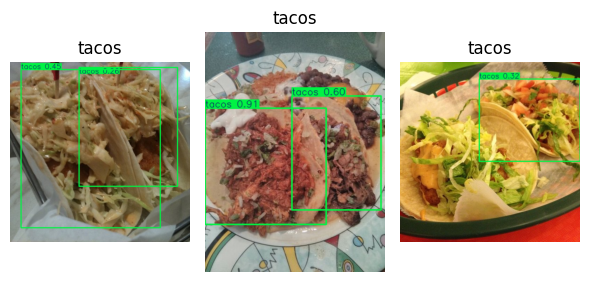


image 1/1 /content/Food_101/ice_cream/1789728.jpg: 640x640 1 chocolate_cake, 10.4ms
Speed: 4.6ms preprocess, 10.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/ice_cream/1533825.jpg: 640x480 1 ice_cream, 14.2ms
Speed: 3.4ms preprocess, 14.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/Food_101/ice_cream/128955.jpg: 480x640 (no detections), 8.4ms
Speed: 3.5ms preprocess, 8.4ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)


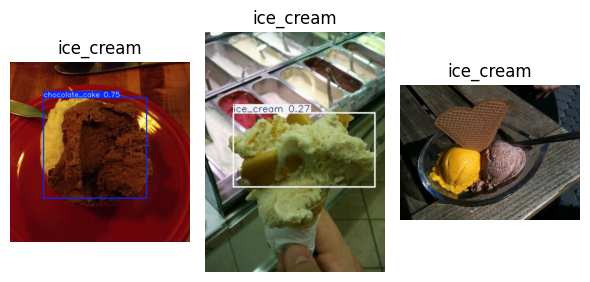


image 1/1 /content/Food_101/onion_ring/2537186.jpg: 640x640 1 onion_ring, 11.3ms
Speed: 5.4ms preprocess, 11.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/onion_ring/3090546.jpg: 640x640 1 onion_ring, 8.5ms
Speed: 4.3ms preprocess, 8.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/onion_ring/321297.jpg: 640x480 3 onion_rings, 10.3ms
Speed: 3.7ms preprocess, 10.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)


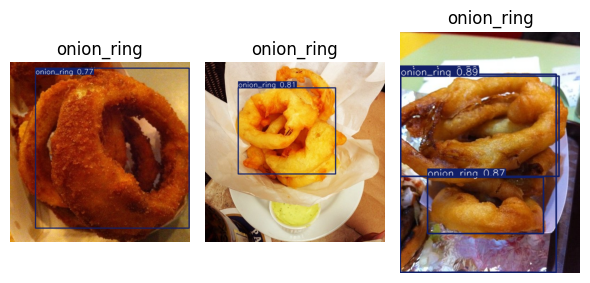


image 1/1 /content/Food_101/french_fries/87125.jpg: 640x480 (no detections), 13.2ms
Speed: 3.7ms preprocess, 13.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/Food_101/french_fries/2634202.jpg: 640x640 1 french_fries, 9.7ms
Speed: 5.2ms preprocess, 9.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/french_fries/2952319.jpg: 640x640 1 french_fries, 9.9ms
Speed: 4.1ms preprocess, 9.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


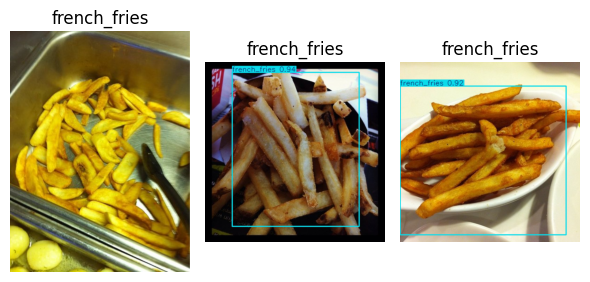


image 1/1 /content/Food_101/pizza/1475479.jpg: 480x640 1 pizza, 11.5ms
Speed: 4.5ms preprocess, 11.5ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)

image 1/1 /content/Food_101/pizza/2101820.jpg: 640x640 1 waffle, 10.4ms
Speed: 5.0ms preprocess, 10.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/pizza/1524655.jpg: 640x640 1 pizza, 9.0ms
Speed: 4.2ms preprocess, 9.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


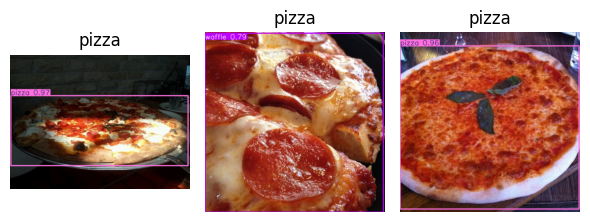


image 1/1 /content/Food_101/nachos/3665796.jpg: 640x640 1 tacos, 9.9ms
Speed: 5.4ms preprocess, 9.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/nachos/1421208.jpg: 640x640 1 nachos, 10.7ms
Speed: 4.1ms preprocess, 10.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/nachos/1622749.jpg: 640x640 1 nachos, 8.8ms
Speed: 4.1ms preprocess, 8.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


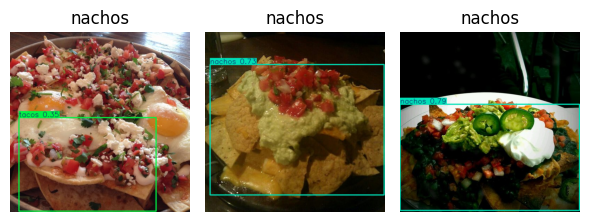


image 1/1 /content/Food_101/chocolate_cake/2493269.jpg: 640x640 2 chocolate_cakes, 9.0ms
Speed: 4.9ms preprocess, 9.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/chocolate_cake/1749877.jpg: 384x640 (no detections), 100.0ms
Speed: 2.8ms preprocess, 100.0ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/Food_101/chocolate_cake/1933924.jpg: 640x640 1 chocolate_cake, 10.7ms
Speed: 4.2ms preprocess, 10.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


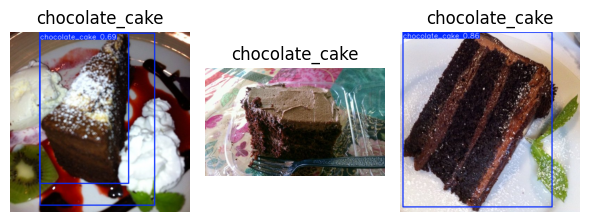


image 1/1 /content/Food_101/waffle/1511442.jpg: 640x640 1 samosa, 14.8ms
Speed: 5.1ms preprocess, 14.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/waffle/435303.jpg: 640x640 1 waffle, 8.3ms
Speed: 3.3ms preprocess, 8.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/waffle/789765.jpg: 480x640 2 waffles, 9.7ms
Speed: 3.4ms preprocess, 9.7ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


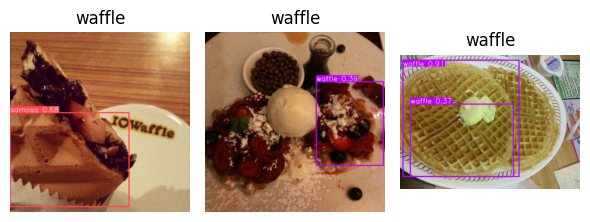


image 1/1 /content/Food_101/strawberry_shortcake/2496900.jpg: 480x640 1 ice_cream, 19.0ms
Speed: 3.3ms preprocess, 19.0ms inference, 4.6ms postprocess per image at shape (1, 3, 480, 640)

image 1/1 /content/Food_101/strawberry_shortcake/1828286.jpg: 640x640 1 strawberry_shortcake, 9.6ms
Speed: 4.4ms preprocess, 9.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/strawberry_shortcake/1486158.jpg: 640x640 (no detections), 9.0ms
Speed: 4.2ms preprocess, 9.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


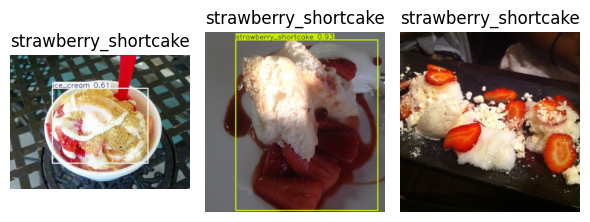


image 1/1 /content/Food_101/samosa/1201331.jpg: 640x640 3 samosas, 12.0ms
Speed: 4.8ms preprocess, 12.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/samosa/2232162.jpg: 640x640 2 samosas, 8.2ms
Speed: 4.3ms preprocess, 8.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/Food_101/samosa/2634281.jpg: 480x640 1 ice_cream, 1 samosa, 9.0ms
Speed: 3.2ms preprocess, 9.0ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


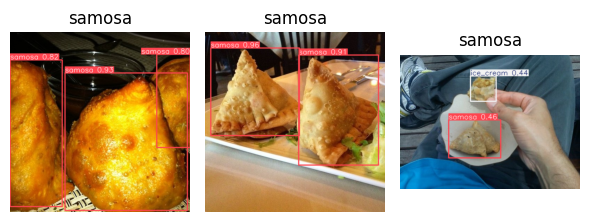

In [35]:
# Import necessary libraries
from ultralytics import YOLO
import os
import cv2
import random
import matplotlib.pyplot as plt

# Define the root folder where images are stored (structure: Food_101/class_name/image.jpg)
image_root = 'Food_101'

# Load the trained YOLO model
model = YOLO('yolo_model_aug.pt')

# Get the list of already-used images and classes from the annotation DataFrame
existing_images = set(annotation_df['image'].tolist())
existing_class = set(annotation_df['class_name'].tolist())

# Prepare a dictionary to store selected image paths per class
class_to_images = {}

# Loop through each class for which we want to visualize predictions
for class_name in existing_class:
    class_path = os.path.join(image_root, class_name)  # Path to the class folder
    print(class_path)

    # Get all unused .jpg images in the class folder
    all_images = [
        img for img in os.listdir(class_path)
        if img.lower().endswith('.jpg') and img not in existing_images
    ]

    # Randomly sample up to 3 images from the available ones
    selected = random.sample(all_images, min(3, len(all_images)))

    # Store the full image paths
    class_to_images[class_name] = [os.path.join(class_path, img) for img in selected]

# Plot predictions: 1 row per class, 3 images per class
for class_name, image_paths in class_to_images.items():
    plt.figure(figsize=(6, 6))

    for idx, img_path in enumerate(image_paths):
        # Run YOLO model on the image
        results = model(img_path)

        # Draw predicted bounding boxes on the image
        annotated_img = results[0].plot()

        # Show the annotated image in the subplot
        plt.subplot(1, 3, idx + 1)
        plt.imshow(cv2.cvtColor(annotated_img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f"{class_name}")

    # Adjust layout and display
    plt.tight_layout()
    plt.show()


**Observations from Unseen Samples**

- We selected 3 **random unseen images per class** (not present in the training dataset) to evaluate the generalization of the trained YOLO model on out-of-distribution samples.

- The model occasionally **misclassifies visually similar food items**, for instance, detecting **nachos as tacos**. This likely stems from overlapping visual cues such as corn chips, cheese, and toppings, which are common to both classes.

- **Waffle images were sometimes misclassified as onion rings**, possibly due to **similar circular patterns and golden-brown textures**, highlighting a need for better texture and shape feature discrimination.

- While the model successfully detects **ice cream** in multiple scenarios, it **fails to detect it** in some edge cases. These failures might be due to **poor lighting, partial occlusion, or variations in serving styles** not captured during training.

- The mixed results demonstrate that while the model exhibits strong generalization to unseen data, **inter-class confusion remains** for visually similar categories, suggesting potential improvements through **hard-negative mining, advanced augmentations, or fine-tuning with edge-case examples**.

- Overall, the evaluation confirms that the model is capable of **handling moderate domain shifts**, but **further robustness can be achieved** through iterative retraining using misclassified instances from such real-world samples.


### **Key Takeaways and Recommendations**

**RCNN**

- Training Time: Very high (52+ minutes for ~450 images)
- Overall mAP@0.5: 0.553
- Class-wise Performance:
  - High accuracy for chocolate_cake, waffle, french_fries, onion_ring, strawberry_shortcake
  - Poor detection for ice_cream, nachos

**Faster RCNN**

- Training Time: Moderate (30 epochs)
- mAP@0.5:
  - Without Augmentation: 0.405
  - With Augmentation: Not explicitly reported, but presumed improved based on loss patterns
- Class-wise Performance:
  - Strong for pizza, french_fries, samosa
  - Weak for ice_cream, nachos, strawberry_shortcake

**YOLO**

- Training Time: Very low (50 epochs in ~8 minutes)
- Overall mAP@0.5:
  - Without Augmentation: 0.608
  - With Augmentation: 0.628
- Class-wise Insights:
  - Strong performance on french_fries, samosa, pizza, chocolate_cake
  - Weak on strawberry_shortcake, ice_cream, nachos

#### **Key Observations**

**Model-wise**

- YOLO is the fastest to train and shows the best overall performance (mAP@0.5 = 0.628 with augmentation)
- RCNN has moderate performance but very high training time and zero detection on a few classes
- Faster RCNN benefits from augmentation, but still lags behind YOLO in mAP and training efficiency

**Augmentation impact**

- Clear boost in mAP for YOLO (+0.02) and qualitative improvements for Faster RCNN
- Not used for RCNN but could help address zero-detection issues for ice_cream and nachos

**Class-wise consistency**

- french_fries, chocolate_cake, samosa, pizza show strong detection across all models
- ice_cream, nachos, and strawberry_shortcake are consistently weaker, likely due to poor data representation or higher intra-class variance

#### **Recommendations**

**Business Level**

- Adopt YOLO for real-time or resource-constrained deployment due to high accuracy and fast inference
- Use Faster RCNN with augmentation for offline batch processing or tasks requiring higher precision
- Avoid RCNN in production without significant enhancements due to high training time and poor generalization

**Data Strategy**

- Improve dataset balance and image quality for weak classes like nachos, ice_cream, and strawberry_shortcake
- Use synthetic augmentation techniques for underrepresented classes

**Model Optimization**

- Always use data augmentation in training pipelines
- Explore class-specific fine-tuning or curriculum learning for weak classes

**Evaluation Expansion**

- Incorporate metrics like mAP@0.75 and mAP@[0.5:0.95] to assess localization precision
- Analyze F1-scores and confusion matrices to better understand false positive and negative rates

**Scalability Note**

- YOLO is ideal for scalable deployment (edge devices, web, mobile)
- Faster RCNN suits cloud-based analytic pipelines or applications prioritizing detection quality over speed

#### **Conclusion**

YOLO with augmentation provides the best tradeoff between accuracy, speed, and deployment practicality. Faster RCNN with augmentation offers decent performance for quality-centric use cases. RCNN in its current form is not recommended without further optimization or augmentation support.
